In [1]:
import scanpy as sc
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb
import matplotlib
import scrublet as scr
import scipy.io

In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

scanpy==1.6.0 anndata==0.7.4 umap==0.4.6 numpy==1.19.2 scipy==1.5.2 pandas==1.1.2 scikit-learn==0.23.2 statsmodels==0.12.0 python-igraph==0.8.2 leidenalg==0.8.2


In [43]:
#A:Ctl; B: PD1; C: 21DC; D:Combo from Bin and Ramin

Adata = sc.read_10x_mtx('../../../Bin_Ramin/A/',var_names='gene_symbols',                # use gene symbols for the variable names (variables-axis index)
    cache=True)
#combodata = sc.read_10x_h5('cache/..-..-data1-Combo_CD45-matrix.h5ad')
#combodata.var_names_make_unique() 
Adata.obs['treat'] = 'Ctl'


Bdata = sc.read_10x_mtx('../../../Bin_Ramin/B/',var_names='gene_symbols',                # use gene symbols for the variable names (variables-axis index)
    cache=True)
Bdata.var_names_make_unique() 
Bdata.obs['treat'] = 'PD1'


Cdata = sc.read_10x_mtx('../../../Bin_Ramin/C/',var_names='gene_symbols',                # use gene symbols for the variable names (variables-axis index)
    cache=True)
Cdata.var_names_make_unique() 
Cdata.obs['treat'] = '21DC'


Ddata = sc.read_10x_mtx('../../../Bin_Ramin/D/',var_names='gene_symbols',                # use gene symbols for the variable names (variables-axis index)
    cache=True)
Ddata.var_names_make_unique() 
Ddata.obs['treat'] = 'Combo'

... reading from cache file cache/..-..-..-Bin_Ramin-A-matrix.h5ad
... reading from cache file cache/..-..-..-Bin_Ramin-B-matrix.h5ad
... reading from cache file cache/..-..-..-Bin_Ramin-C-matrix.h5ad
... reading from cache file cache/..-..-..-Bin_Ramin-D-matrix.h5ad


In [44]:
YSdata = sc.read_10x_mtx('../../../data1/Ctl_CD45-/',var_names='gene_symbols',                # use gene symbols for the variable names (variables-axis index)
    cache=True)
YSdata.var_names_make_unique() 
YSdata.obs['treat'] = 'YS_Cancer'

adata = Adata.concatenate(Bdata,Cdata,Ddata)

adata
fulldata=adata.concatenate(adata,YSdata)

... reading from cache file cache/..-..-..-data1-Ctl_CD45--matrix.h5ad


#Data files
'''
sample_strings = ['Combo_CD45_D','Ctl_CD45_D']
sample_id_strings = ['1', '2', '3', '4']
file_base = '../../data1/'
exp_string = '/'
data_file_end = '_matrix.mtx'
barcode_file_end = '_barcodes.tsv'
gene_file_end = '_features.tsv'
cc_genes_file = 'ref_genes.txt'
cc_genes_file = '../Macosko_cell_cycle_genes.txt'
'''

#Dublets for Combo

counts_matrix = scipy.io.mmread(file_base+sample_strings[0]+ exp_string + 'matrix.mtx').T.tocsc()
genes = np.array(scr.load_genes(file_base+sample_strings[0]+ exp_string + 'features.tsv', delimiter='\t', column=1))

print('Counts matrix shape_Combo: {} rows, {} columns'.format(counts_matrix.shape[0], counts_matrix.shape[1]))
print('Number of genes in gene list_Combo: {}'.format(len(genes)))


#Dublets for Ctl
counts_matrix_Ctl = scipy.io.mmread(file_base+sample_strings[1]+ exp_string + 'matrix.mtx').T.tocsc()
genes = np.array(scr.load_genes(file_base+sample_strings[1]+ exp_string + 'features.tsv', delimiter='\t', column=1))

print('Counts matrix shape_Ctl: {} rows, {} columns'.format(counts_matrix.shape[0], counts_matrix.shape[1]))
print('Number of genes in gene list_Ctl: {}'.format(len(genes)))

scrub_Combo = scr.Scrublet(counts_matrix, expected_doublet_rate=0.06)
scrub_Ctl = scr.Scrublet(counts_matrix_Ctl, expected_doublet_rate=0.06)

doublet_scores_Combo, predicted_doublets_Combo = scrub_Combo.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)
combodata.obs['doublet'] = doublet_scores_Combo

doublet_scores_Ctl, predicted_doublets_Ctl = scrub_Ctl.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)
ctldata.obs['doublet'] = doublet_scores_Ctl

scrub.plot_histogram();

print('Running UMAP...')
scrub.set_embedding('UMAP', scr.get_umap(scrub.manifold_obs_, 10, min_dist=0.3))
print('Done.')

plt.hist(doublet_scores_Combo)
plt.hist(doublet_scores_Ctl)

adata = combodata.concatenate( ctldata)

adata.obs['doublet']

normalizing counts per cell
    finished (0:00:00)


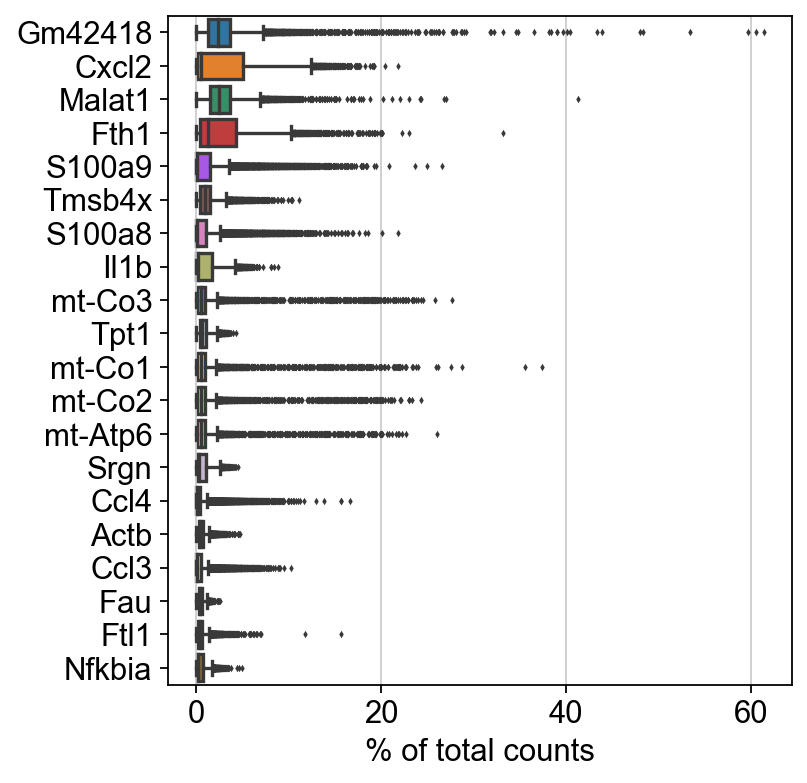

In [45]:
sc.pl.highest_expr_genes(adata, n_top=20, )

In [46]:
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=5)

sc.pp.filter_cells(fulldata, min_genes=200)
sc.pp.filter_genes(fulldata, min_cells=5)

filtered out 150 cells that have less than 200 genes expressed


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


filtered out 13162 genes that are detected in less than 5 cells
filtered out 405 cells that have less than 200 genes expressed
filtered out 11538 genes that are detected in less than 5 cells


In [47]:
adata.var['mt'] = adata.var_names.str.startswith('mt-')
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

In [48]:
fulldata.var['mt'] = fulldata.var_names.str.startswith('mt-')
sc.pp.calculate_qc_metrics(fulldata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'treat' as categorical
... storing 'feature_types' as categorical
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_core.py:1303: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_core.py:1303: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_core.py:1303: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical"

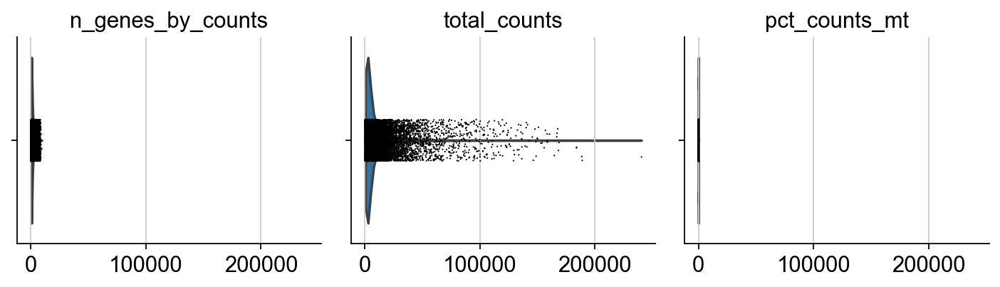

In [49]:
#sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
#           jitter=0.4, multi_panel=True)
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],multi_panel=True)

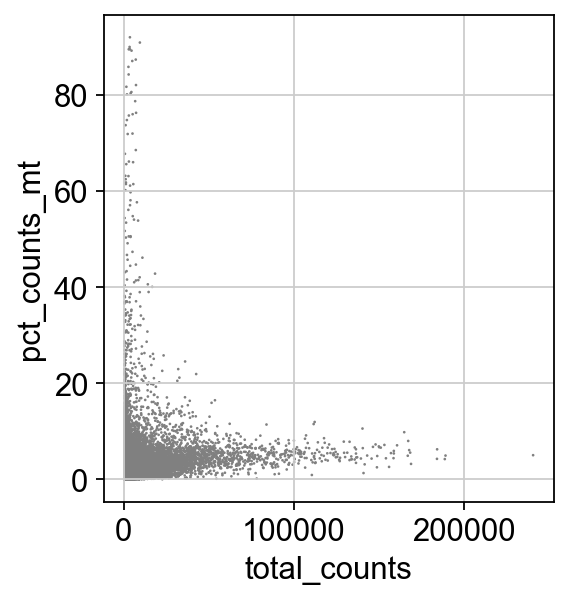

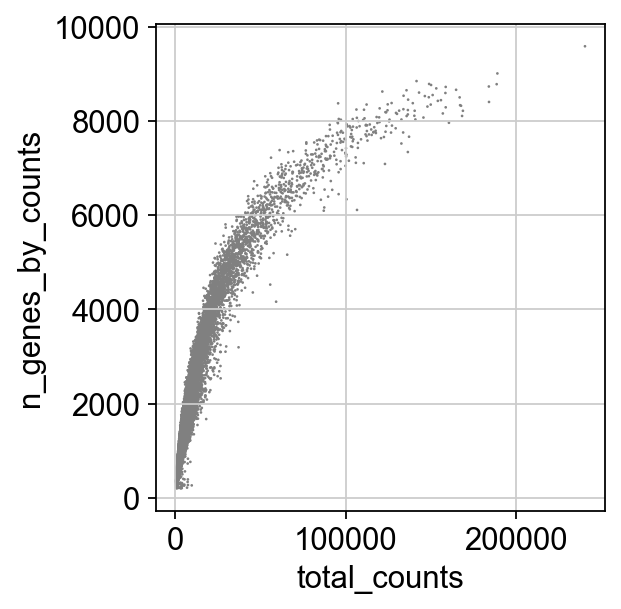

In [51]:
plt.rcParams["figure.figsize"] = (4,4)
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [52]:
adata = adata[adata.obs.n_genes_by_counts < 9000, :] #cell has too many genes maybe doublets
adata = adata[adata.obs.pct_counts_mt < 20, :]
#Filter Doublets
#adata = adata[adata.obs['doublet']< 0.5]

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [53]:
fulldata = fulldata[fulldata.obs.n_genes_by_counts < 9000, :] #cell has too many genes maybe doublets
fulldata = fulldata[fulldata.obs.pct_counts_mt < 20, :]
#Filter Doublets

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


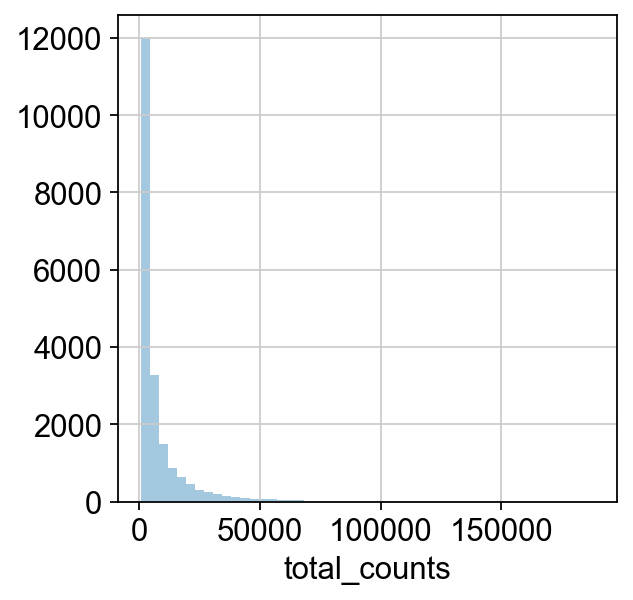

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


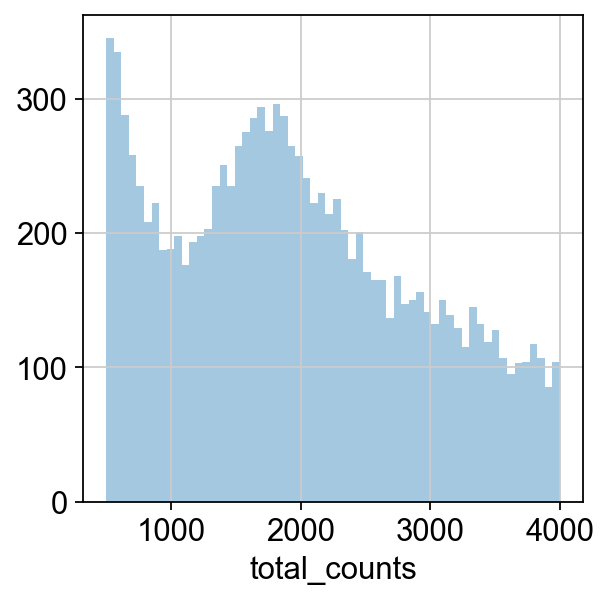

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


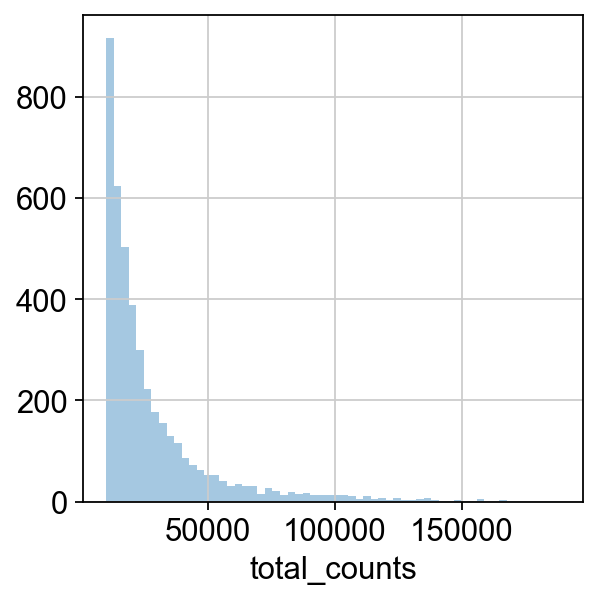

In [54]:
#plt.hist(adata.obs.n_genes_by_counts)
#plt.hist(adata[adata.obs.n_genes_by_counts < 2000,:].obs.n_genes_by_counts)
#plt.xscale('log')
#Thresholding decision: counts
plt.figure(figsize=(4,4))
p3 = sb.distplot(adata.obs['total_counts'], kde=False)
plt.show()

p4 = sb.distplot(adata.obs['total_counts'][adata.obs['total_counts']<4000], kde=False, bins=60)
plt.show()

p5 = sb.distplot(adata.obs['total_counts'][adata.obs['total_counts']>10000], kde=False, bins=60)
plt.show()

In [55]:
sc.pp.filter_cells(adata, min_counts = 1000)  #Needs this filter 
print('Number of cells after min count filter: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(adata, max_counts = 100000)#Needs this filter 
print('Number of cells after max count filter: {:d}'.format(adata.n_obs))

filtered out 2181 cells that have less than 1000 counts


Trying to set attribute `.obs` of view, copying.
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


Number of cells after min count filter: 18290
filtered out 120 cells that have more than 100000 counts
Number of cells after max count filter: 18170


In [56]:
sc.pp.filter_cells(fulldata, min_counts = 1000)  #Needs this filter 
print('Number of cells after min count filter: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(fulldata, max_counts = 100000)#Needs this filter 
print('Number of cells after max count filter: {:d}'.format(adata.n_obs))

filtered out 5744 cells that have less than 1000 counts


Trying to set attribute `.obs` of view, copying.


Number of cells after min count filter: 18170
filtered out 240 cells that have more than 100000 counts
Number of cells after max count filter: 18170


In [57]:
sc.pp.normalize_total(adata, target_sum=1e4)

normalizing counts per cell
    finished (0:00:00)


In [58]:
sc.pp.normalize_total(fulldata, target_sum=1e4)

normalizing counts per cell
    finished (0:00:00)


In [59]:
sc.pp.log1p(adata)

In [60]:
sc.pp.log1p(fulldata)

In [63]:
#sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=10, min_disp=0.5) 
sc.pp.highly_variable_genes(adata, n_top_genes=4000) #best_practice_package
print('\n','Number of highly variable genes: {:d}'.format(np.sum(adata.var['highly_variable'])))

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)

 Number of highly variable genes: 3999


In [64]:
#sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=10, min_disp=0.5) 
sc.pp.highly_variable_genes(fulldata, n_top_genes=4000) #best_practice_package
print('\n','Number of highly variable genes: {:d}'.format(np.sum(fulldata.var['highly_variable'])))

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)

 Number of highly variable genes: 3999


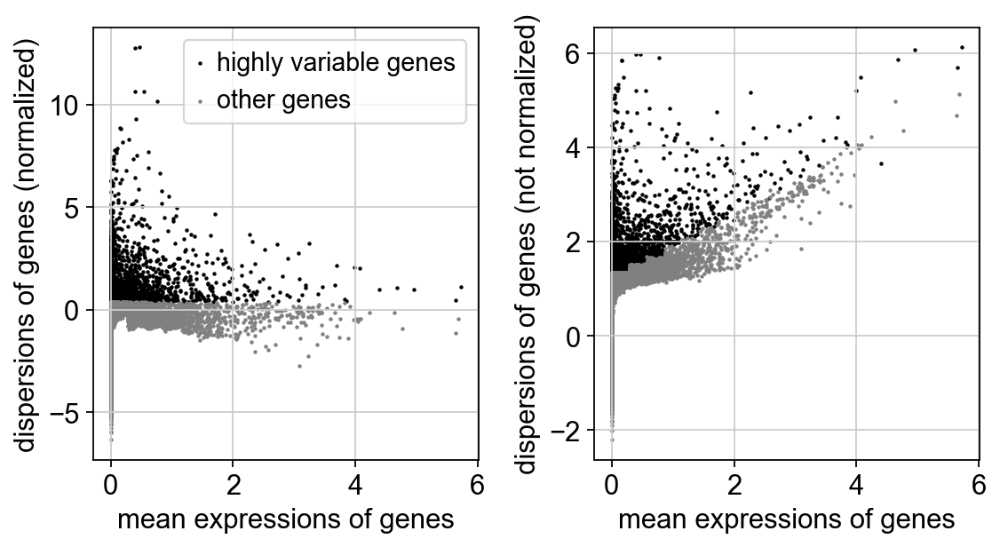

In [65]:
sc.pl.highly_variable_genes(adata)

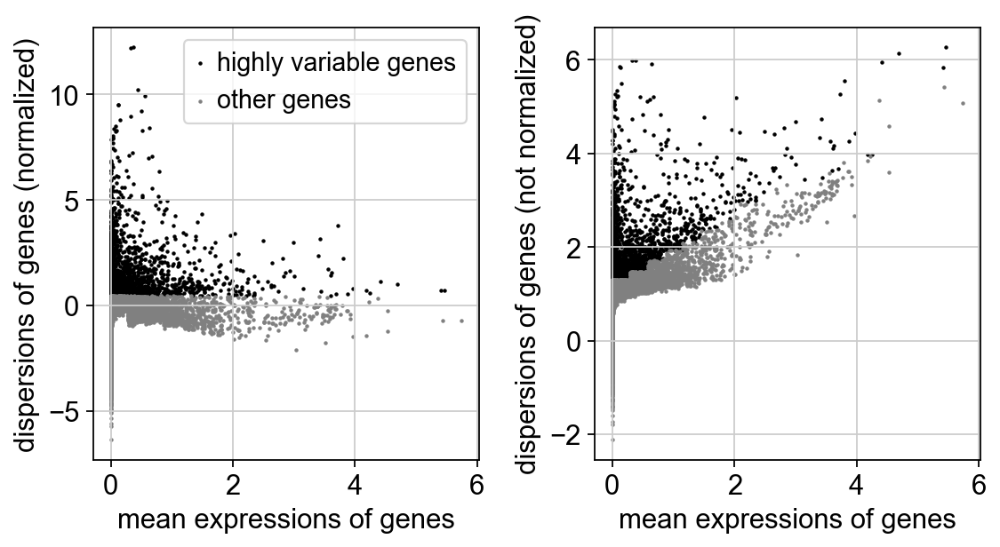

In [66]:
sc.pl.highly_variable_genes(fulldata)

In [67]:
adata.raw = adata
fulldata.raw = fulldata
#raw layer is log transformed , normalized data; before scale & batch correction

In [68]:
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])
sc.pp.regress_out(fulldata, ['total_counts', 'pct_counts_mt'])

regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished (0:02:54)
regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use


... storing 'treat' as categorical
... storing 'feature_types' as categorical


    finished (0:08:43)


In [69]:
sc.pp.scale(adata, max_value=10)
sc.pp.scale(fulldata, max_value=10)
#sc.pp.scale(adata)
#Scale each gene to unit variance. Clip values exceeding standard deviation 10.

In [70]:
#sc.tl.pca(adata, use_highly_variable=True, svd_solver='arpack')
sc.tl.pca(adata,svd_solver='arpack')#Use high variable genes
sc.pp.neighbors(adata)

#sc.tl.pca(adata, use_highly_variable=True, svd_solver='arpack')
sc.tl.pca(fulldata,svd_solver='arpack')#Use high variable genes
sc.pp.neighbors(fulldata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:03)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)
computing PCA
    on highly variable genes
    with n_comps=50


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished (0:00:09)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:09)


computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:09)


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


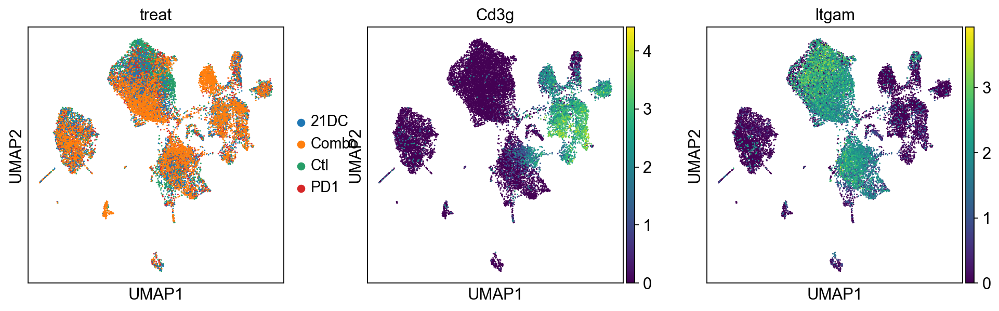

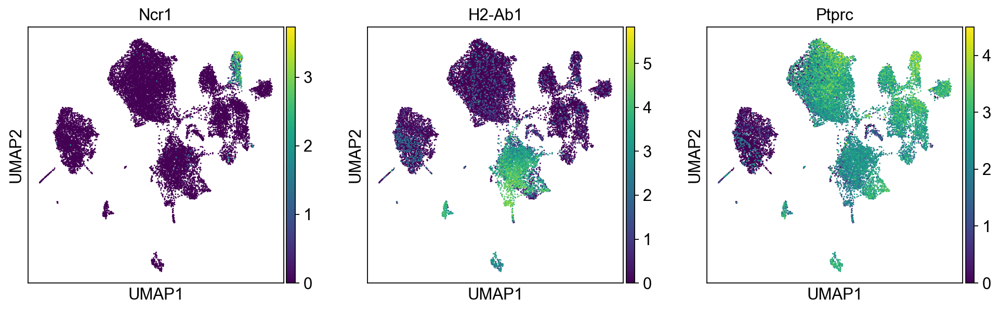

18170

In [73]:
#Before batch correction, regress out 
sc.tl.umap(adata)
sc.pl.umap(adata,color=['treat', 'Cd3g', 'Itgam'])
sc.pl.umap(adata,color=['Ncr1', 'H2-Ab1', 'Ptprc'])
adata.n_obs

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:30)


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


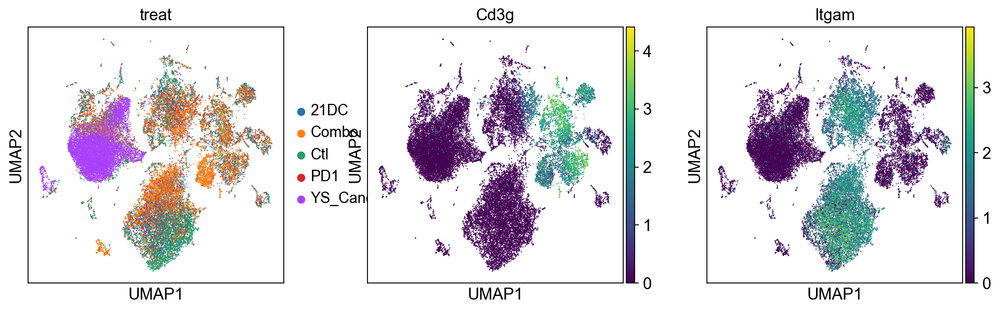

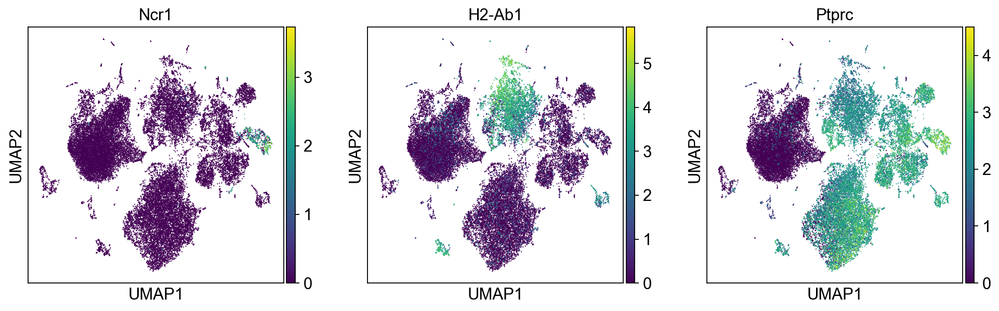

18170

In [71]:
#Before batch correction, regress out 
sc.tl.umap(fulldata)
sc.pl.umap(fulldata,color=['treat', 'Cd3g', 'Itgam'])
sc.pl.umap(fulldata,color=['Ncr1', 'H2-Ab1', 'Ptprc'])
adata.n_obs

In [72]:
#Batch Correction with bbknn
##sc.external.pp.bbknn(adata, batch_key='batch') 


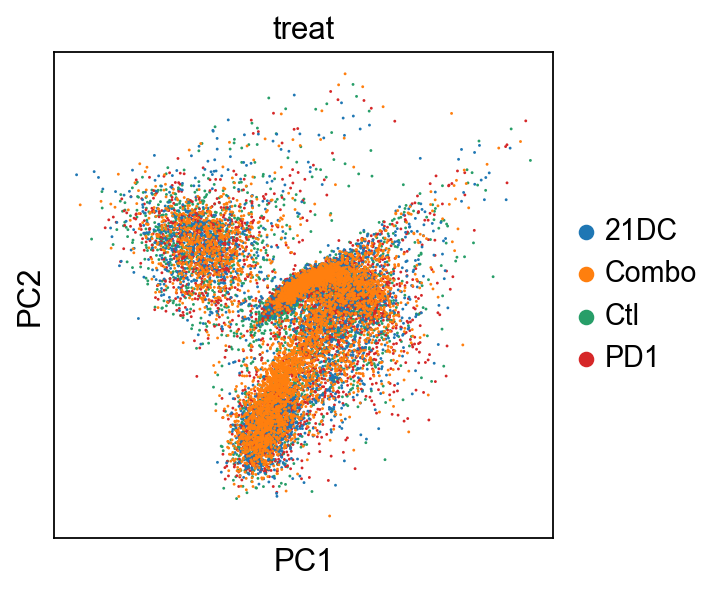

In [22]:
sc.pl.pca(adata, color='treat')

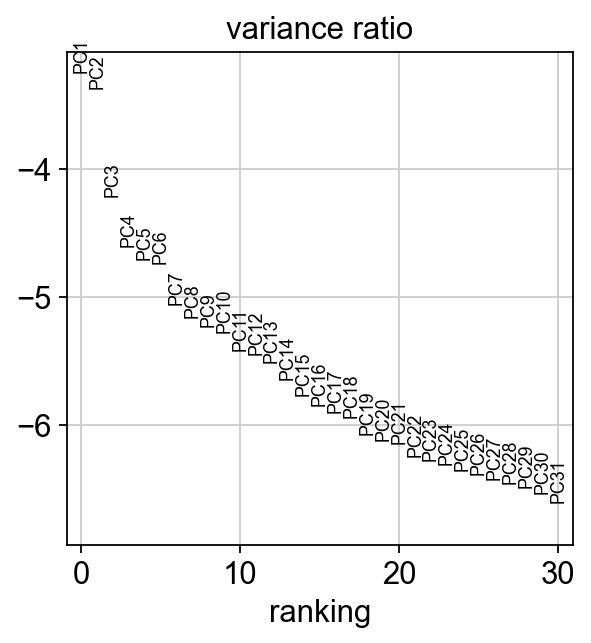

In [23]:
sc.pl.pca_variance_ratio(adata, log=True)

# Cell cycle scoring

Known sources of technical variation in the data have been investigated and corrected for (e.g. batch, count depth). A known source of biological variation that can explain the data is the cell cycle. Here, a gene list from Macosko et al., Cell 161 (2015) is used to score the cell cycle effect in the data and classify cells by cell cycle phase. The file can be found on the single-cell-tutorial github repository, or be taken from the supplementary material of the paper.
Please note, that s the gene list was generated for human HeLa cells, the gene names are put into lower case with a leading capital letter to map to the respective mouse genes. When adapting this script to your own data, this must be taken into account for data from species other than mouse.
We perform cell cycle scoring on the full batch-corrected data set in adata.

In [24]:
cc_genes_file = '../ref_genes.txt'
cc_genes_file = '../../Macosko_cell_cycle_genes.txt'
#Score cell cycle and visualize the effect:
cc_genes = pd.read_table(cc_genes_file, delimiter='\t')
#s_genes = cc_genes['CELL CYCLE: G1/S'].dropna()
#g2m_genes = cc_genes['CELL CYCLE: G2/M'].dropna()
s_genes = cc_genes['S'].dropna()
g2m_genes = cc_genes['G2.M'].dropna()

s_genes_mm = [gene.lower().capitalize() for gene in s_genes]
g2m_genes_mm = [gene.lower().capitalize() for gene in g2m_genes]

s_genes_mm_ens = adata.var_names[np.in1d(adata.var_names, s_genes_mm)]
g2m_genes_mm_ens = adata.var_names[np.in1d(adata.var_names, g2m_genes_mm)]

sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes_mm_ens, g2m_genes=g2m_genes_mm_ens)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    1901 total control genes are used. (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    1907 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'phase' as categorical


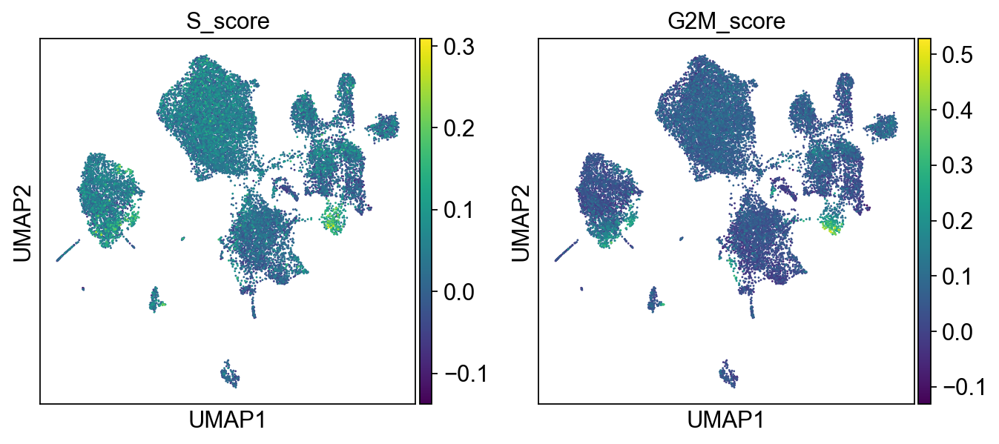

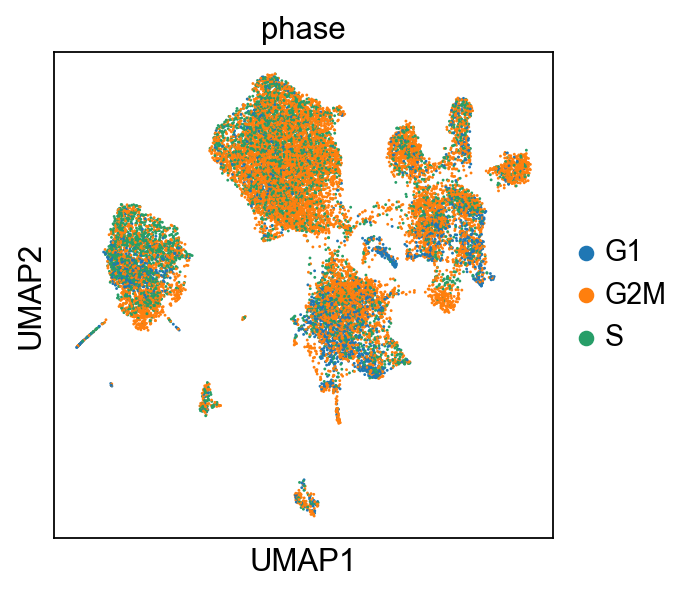

In [25]:
sc.pl.umap(adata, color=['S_score', 'G2M_score'], use_raw=False)
sc.pl.umap(adata, color='phase', use_raw=False)

# Clustering

In [88]:
sc.tl.leiden(adata,resolution=0.05,key_added='louvain_r0.2' )

running Leiden clustering
    finished: found 8 clusters and added
    'louvain_r0.2', the cluster labels (adata.obs, categorical) (0:00:00)


In [77]:
sc.tl.leiden(fulldata,resolution=0.05,key_added='louvain_r0.2' )

running Leiden clustering
    finished: found 12 clusters and added
    'louvain_r0.2', the cluster labels (adata.obs, categorical) (0:00:03)


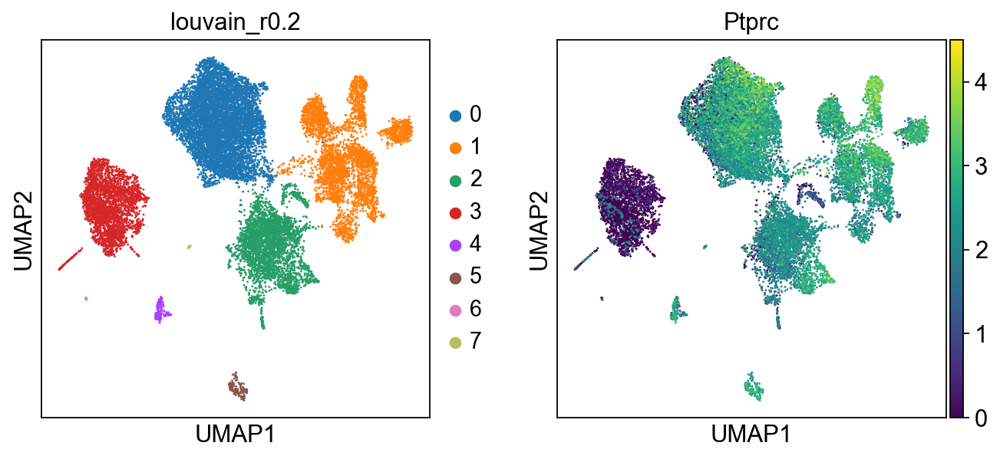

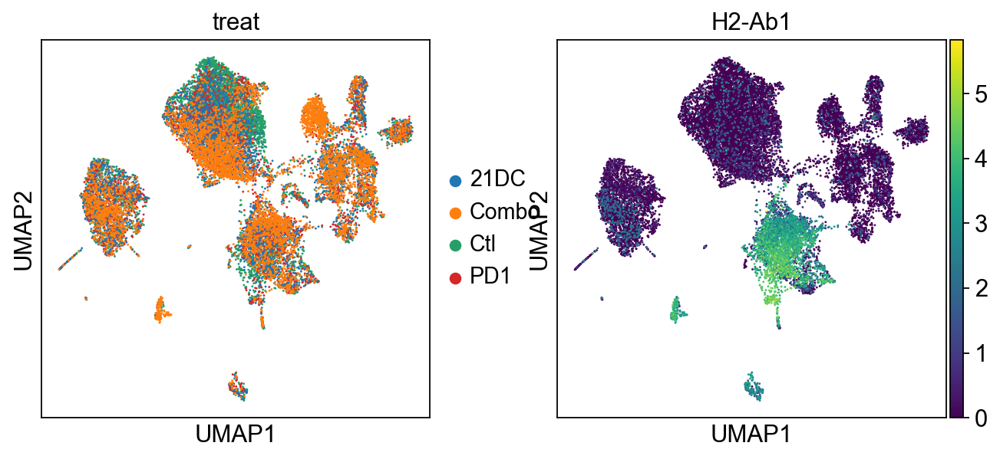

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an erro

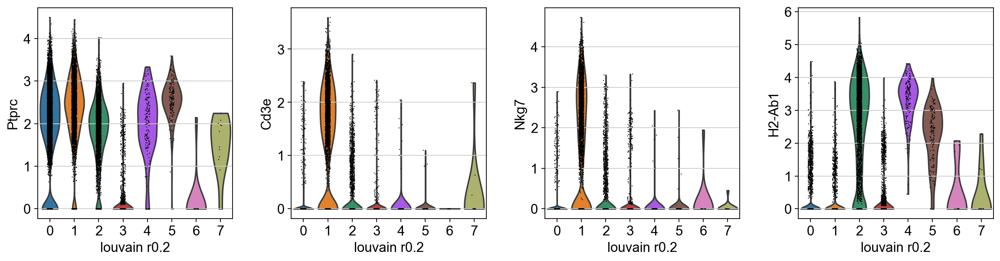

0    7322
1    4039
2    3496
3    2970
4     162
5     156
6      13
7      12
Name: louvain_r0.2, dtype: int64

In [89]:
sc.pl.umap(adata, color=['louvain_r0.2', 'Ptprc']) # resolution=0.2
sc.pl.umap(adata, color=['treat', 'H2-Ab1']) # resolution=0.2
sc.pl.violin(adata, ['Ptprc', 'Cd3e', 'Nkg7','H2-Ab1'], groupby='louvain_r0.2')
adata.obs['louvain_r0.2'].value_counts() 

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


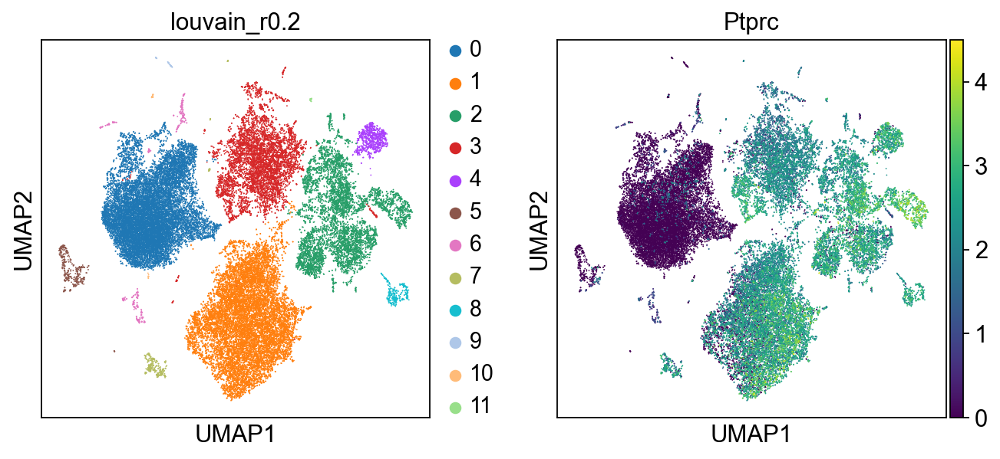

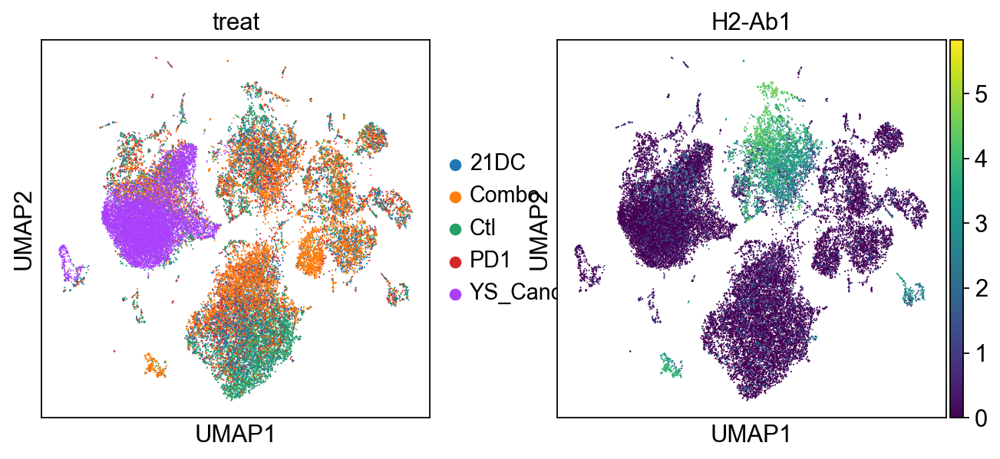

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an erro

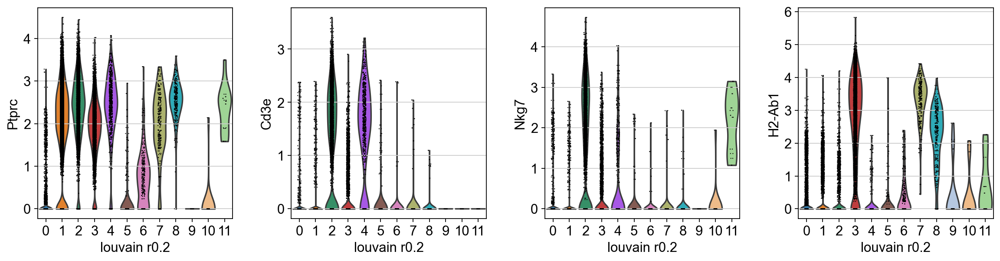

0     16748
1     14589
2      7198
3      6730
4       860
5       392
6       358
7       326
8       316
9        42
10       32
11       22
Name: louvain_r0.2, dtype: int64

In [78]:
sc.pl.umap(fulldata, color=['louvain_r0.2', 'Ptprc']) # resolution=0.2
sc.pl.umap(fulldata, color=['treat', 'H2-Ab1']) # resolution=0.2
sc.pl.violin(fulldata, ['Ptprc', 'Cd3e', 'Nkg7','H2-Ab1'], groupby='louvain_r0.2')
fulldata.obs['louvain_r0.2'].value_counts() 

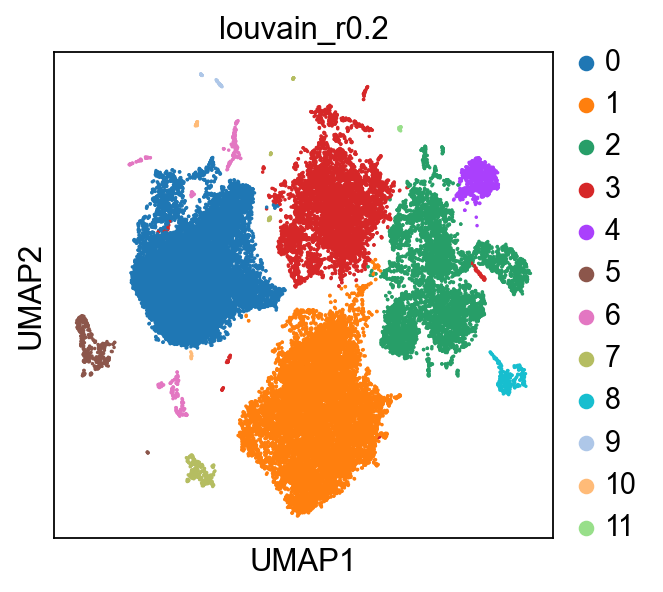

In [137]:
plt.rcParams["figure.figsize"] = (4,4)
ax = sc.pl.umap(fulldata, color='louvain_r0.2', palette=sc.pl.palettes.default_20,size=10,show=False)

#sc.pl.umap(Tdata[Tdata.obs['treat']=='Combo'], color='louvain_r0.5_T', palette=sc.pl.palettes.default_20,size=100,ax=ax)
#sc.pl.umap(Tdata[Tdata.obs['treat']=='Ctl'], color='louvain_r0.5_T', palette=sc.pl.palettes.default_20,size=100,ax=ax)

Trying to set attribute `.uns` of view, copying.


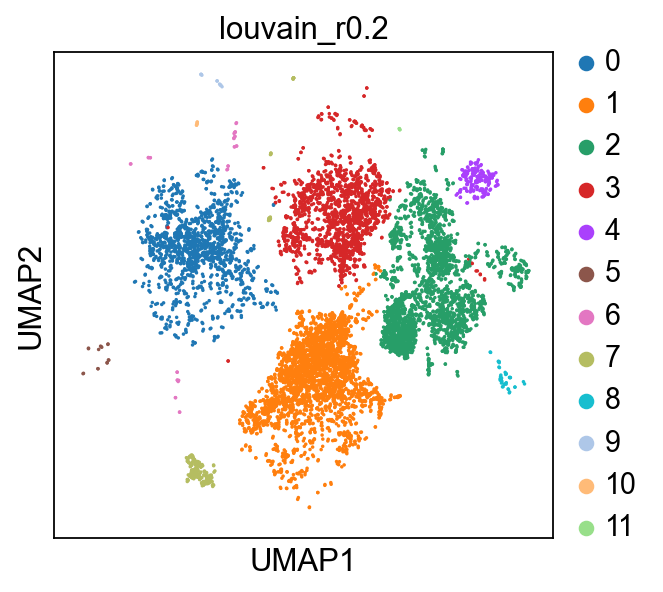

In [138]:
fig,ax2 = plt.subplots()
ax2.set_xlim(ax.get_xlim())
ax2.set_ylim(ax.get_ylim())
sc.pl.umap(fulldata[fulldata.obs['treat']=='Combo'], color='louvain_r0.2', palette=sc.pl.palettes.default_20,size=10,ax=ax2)

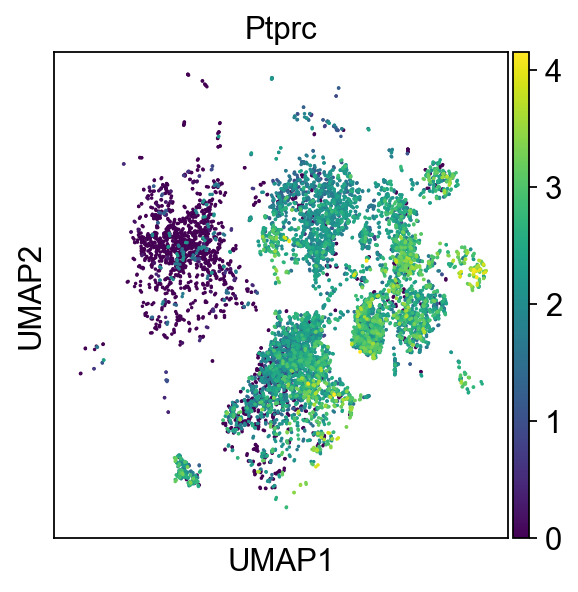

In [141]:
fig,ax2 = plt.subplots()
ax2.set_xlim(ax.get_xlim())
ax2.set_ylim(ax.get_ylim())
sc.pl.umap(fulldata[fulldata.obs['treat']=='Combo'], color='Ptprc', palette=sc.pl.palettes.default_20,size=10,ax=ax2)

Trying to set attribute `.uns` of view, copying.


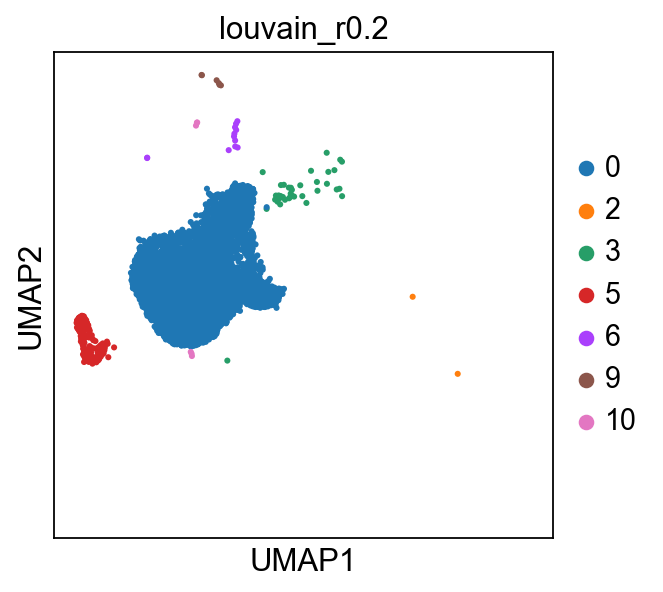

In [139]:
fig,ax2 = plt.subplots()
ax2.set_xlim(ax.get_xlim())
ax2.set_ylim(ax.get_ylim())
sc.pl.umap(fulldata[fulldata.obs['treat']=='YS_Cancer'], color='louvain_r0.2', palette=sc.pl.palettes.default_20,size=30,ax=ax2)
#sc.pl.umap(fulldata[fulldata.obs['treat']=='YS_Cancer'], color='Ptprc', palette=sc.pl.palettes.default_20,size=30,ax=ax2)

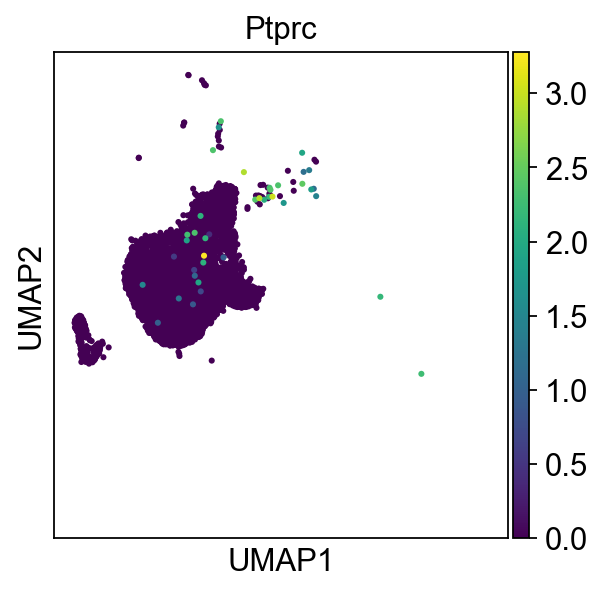

In [140]:
fig,ax2 = plt.subplots()
ax2.set_xlim(ax.get_xlim())
ax2.set_ylim(ax.get_ylim())
#sc.pl.umap(fulldata[fulldata.obs['treat']=='YS_Cancer'], color='louvain_r0.2', palette=sc.pl.palettes.default_20,size=30,ax=ax2)
sc.pl.umap(fulldata[fulldata.obs['treat']=='YS_Cancer'], color='Ptprc', palette=sc.pl.palettes.default_20,size=30,ax=ax2)

In [33]:
#Tmp data storage
adata.write('P_CD45+_adata2_full.h5ad')

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


In [106]:
#Remove non-CD45+ cells, remove cluster 12 with less than 10 cells
#For better visualization, but we can analyze them later on

CD45data=adata[(adata.obs['louvain_r0.2']!='CancerCell') & (adata.obs['louvain_r0.2']!='Fibroblast')]

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


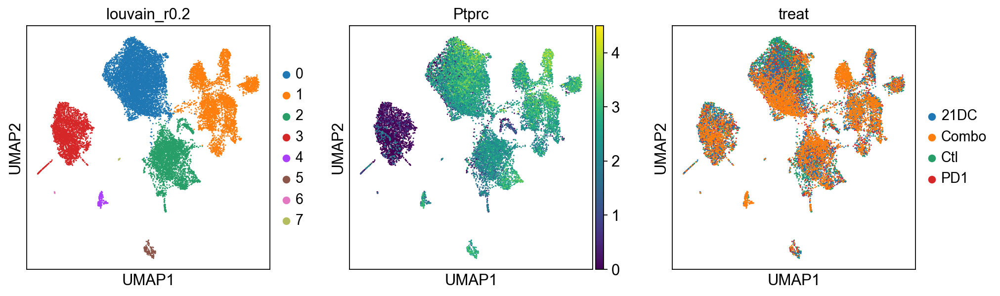

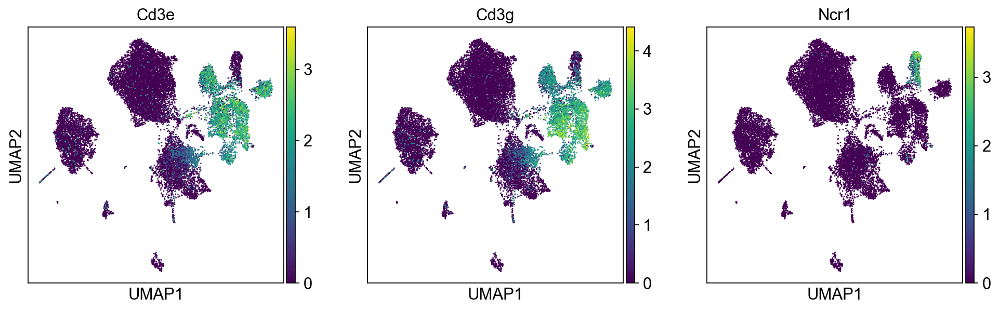

In [90]:
plt.rcParams['figure.figsize']=(4,4)
sc.pl.umap(adata, color=['louvain_r0.2', 'Ptprc', 'treat'],palette=sc.pl.palettes.default_20) # resolution=0.2
sc.pl.umap(adata, color=['Cd3e','Cd3g','Ncr1']) # resolution=0.2

Trying to set attribute `.uns` of view, copying.


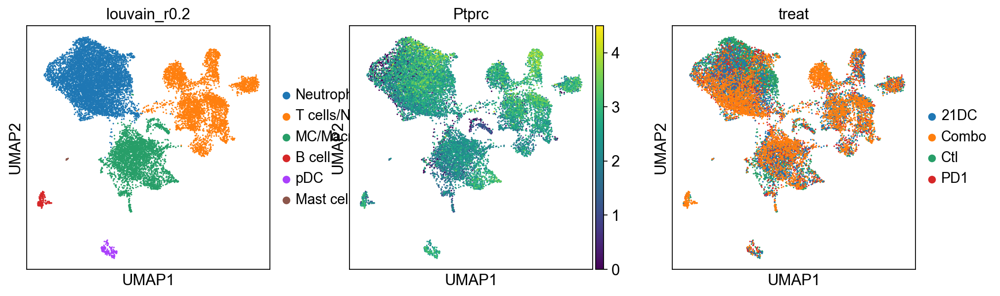

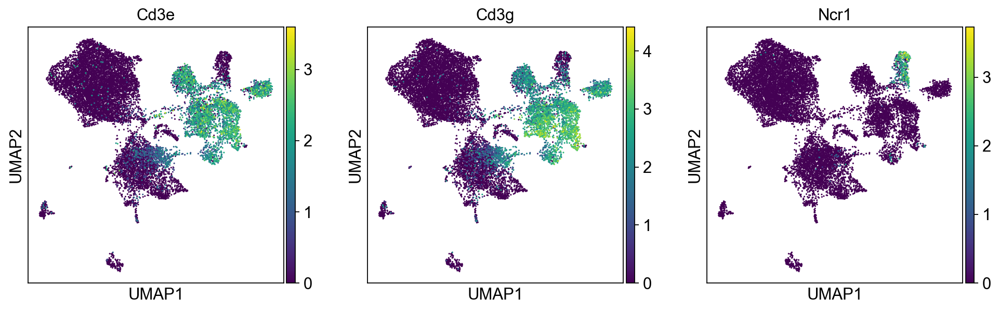

In [107]:
plt.rcParams['figure.figsize']=(4,4)
sc.pl.umap(CD45data, color=['louvain_r0.2', 'Ptprc', 'treat'],palette=sc.pl.palettes.default_20) # resolution=0.2
sc.pl.umap(CD45data, color=['Cd3e','Cd3g','Ncr1']) # resolution=0.2

# Marker Gene and Cluster Annotation

To annotate the clusters we obtained, we find genes that are up-regulated in the cluster compared to all other clusters (marker genes). This differential expression test is performed by a Welch t-test with overestimated variance to be conservative.  The test is automatically performed on the `.raw` data set, which is uncorrected and contains all genes. All genes are taken into account, as any gene may be an informative marker.

ranking genes
    finished: added to `.uns['rank_genes_r0.2']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


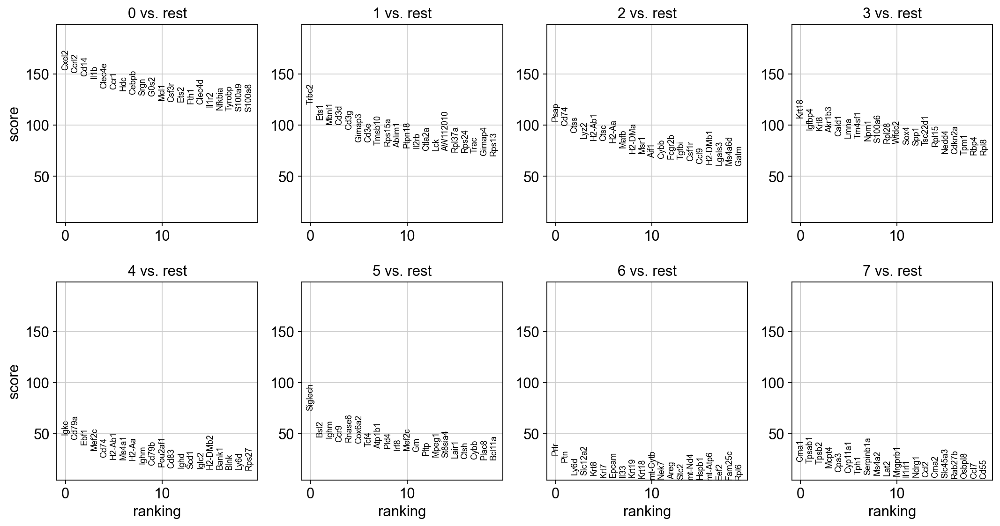

In [91]:
sc.tl.rank_genes_groups(adata, groupby='louvain_r0.2', method='t-test_overestim_var',key_added='rank_genes_r0.2')
#sc.tl.rank_genes_groups(adata, 'leiden', method='logreg')
#sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)
#this one look good

sc.pl.rank_genes_groups(adata, key='rank_genes_r0.2')

In [93]:
adata.uns['rank_genes_r0.2']['names']

rec.array([('Cxcl2', 'Trbc2', 'Psap', 'Krt18', 'Igkc', 'Siglech', 'Prlr', 'Cma1'),
           ('Ccrl2', 'Ets1', 'Cd74', 'Igfbp4', 'Cd79a', 'Bst2', 'Ptn', 'Tpsab1'),
           ('Cd14', 'Mbnl1', 'Ctss', 'Krt8', 'Ebf1', 'Ighm', 'Ly6d', 'Tpsb2'),
           ...,
           ('Rpsa', 'Ftl1', 'Tm4sf1', 'Lcp1', 'Cebpb', 'Ifitm2', 'Cd53', 'Btg2'),
           ('Rps24', 'Fth1', 'Wfdc2', 'Srgn', 'Fxyd5', 'Cebpb', 'Gm42418', 'Lars2'),
           ('Rps4x', 'Cebpb', 'Krt18', 'Ptprc', 'S100a6', 'Junb', 'AY036118', 'Gm42418')],
          dtype=[('0', 'O'), ('1', 'O'), ('2', 'O'), ('3', 'O'), ('4', 'O'), ('5', 'O'), ('6', 'O'), ('7', 'O')])

In [94]:
reffile = '../ref_genes.txt'
refdict = {}
ref_genes = pd.read_table(reffile, delimiter='\t')
for celltype in ref_genes:
    genelist = ref_genes[celltype].dropna()
    refdict[celltype] = [gene.lower().capitalize() for gene in genelist]
marker_genes = refdict
#hand-picked marker gene set
marker_genes['mB cells']=['Cd19','Cd20']
marker_genes['mT cells']=['Cd3d','Cd3e','Cd3g']
marker_genes['mNK cells']=['Ncr1','Klrb1b']
marker_genes['mM']=['Itgam','Csf1r']
marker_genes['mNeu']=['Itgam','Csf3r']
marker_genes['mpDC']=['Siglech','Klk1','Ccr9','Tcf4','Bst2'] #Ramin
marker_genes['mcDC']=['Flt3','Dpp4','Zbtb46'] #Ramin
marker_genes['MyoF'] = ['Acta2','Mylk','Myl9']
marker_genes['CAF'] = ['Fap','Ctgf'] # Pdpn

In [95]:
reffile = '../ref_genes_Zhang'
refdict = {}
ref_genes = pd.read_table(reffile, delimiter='\t')
for celltype in ref_genes:
    genelist = ref_genes[celltype].dropna()
    refdict[celltype] = [gene.lower().capitalize() for gene in genelist]
marker_genes_Zhang = refdict
marker_genes_Zhang['Th']=['Tbx21','Csf1','Gata4','Ifitm2']
#marker_genes_Zhang['Th1']=['Tbx21','Ifng','Csf1','Ifngr2','Il21r','Il12rb2','Il18r1']
#marker_genes_Zhang['Th2']=['Gata3','Il4','Fcgrf','Ifitm2']
#marker_genes_Zhang['Th17']=['Il17f','Il17a','Il21','Il2','Ptgfm']

cell_annotation = sc.tl.marker_gene_overlap(adata, marker_genes, key='rank_genes_r0.2',top_n_markers=200)
cell_annotation_Zhang = sc.tl.marker_gene_overlap(adata,marker_genes_Zhang, key='rank_genes_r0.2',method='overlap_coef',top_n_markers=200)

cell_annotation_Zhang

,0,1,2,3,4,5,6,7
Naive Markers,0.25,0.000,0.00,0.0,0.25,0.0,0.0,0.000000
Inhibitory Receptors,0.00,0.200,0.00,0.0,0.00,0.0,0.0,0.000000
Cytokines and effector molecules,0.00,0.125,0.00,0.0,0.00,0.0,0.0,0.000000
Co-stimulatory molecules,0.00,0.500,0.00,0.0,0.00,0.0,0.0,0.000000
Transcription factos,0.00,0.125,0.25,0.0,0.00,0.0,0.0,0.000000
Treg markers,0.00,0.000,0.00,0.0,0.00,0.0,0.0,0.333333
Th,0.50,0.000,0.00,0.0,0.00,0.0,0.0,0.000000


<AxesSubplot:>

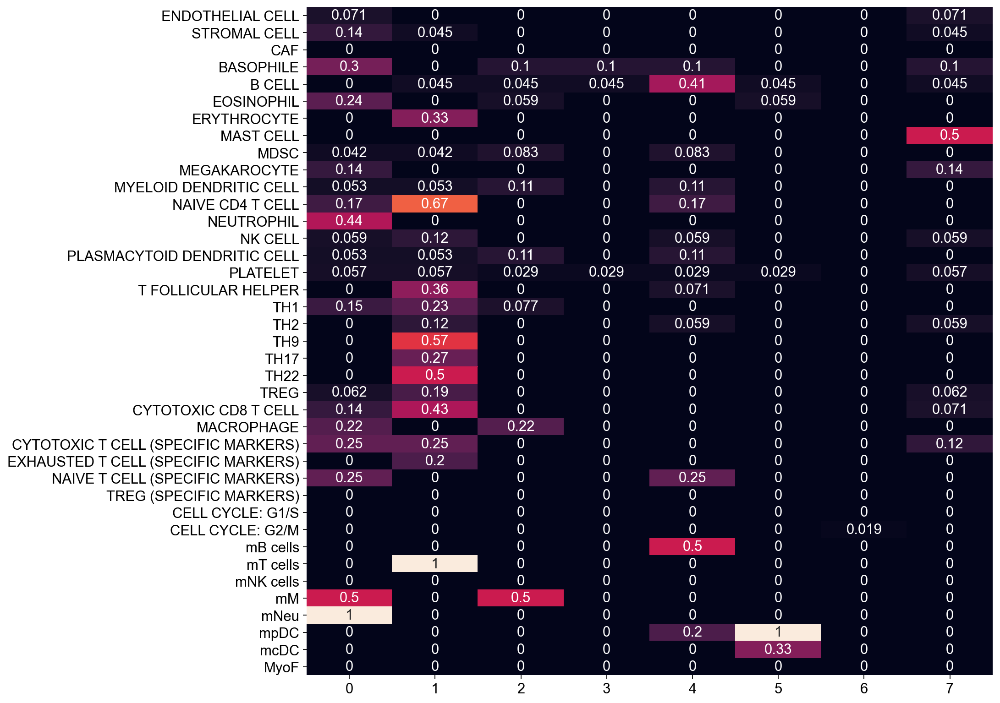

In [96]:
plt.rcParams["figure.figsize"] = (12,12)
cell_annotation_norm = sc.tl.marker_gene_overlap(adata, marker_genes, key='rank_genes_r0.2', normalize='reference',top_n_markers=200)
cell_annotation_norm_Zhang = sc.tl.marker_gene_overlap(adata, marker_genes_Zhang, key='rank_genes_r0.2', normalize='reference',top_n_markers=200)
sb.heatmap(cell_annotation_norm, cbar=False, annot=True)
#sb.heatmap(cell_annotation_norm_Zhang, cbar=False, annot=True)

In [133]:
#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

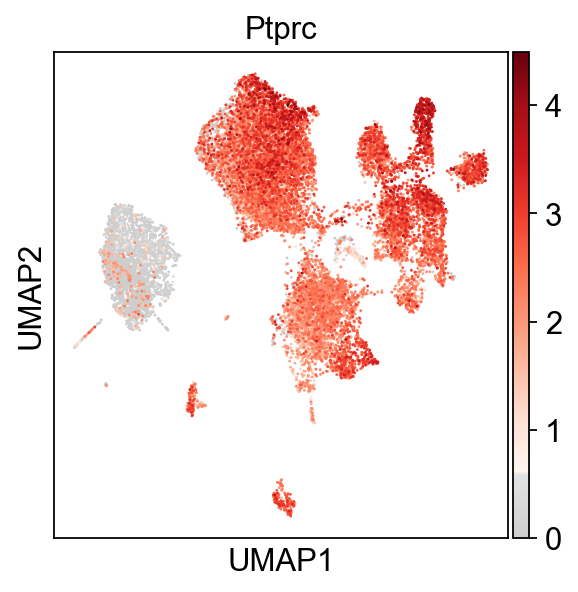

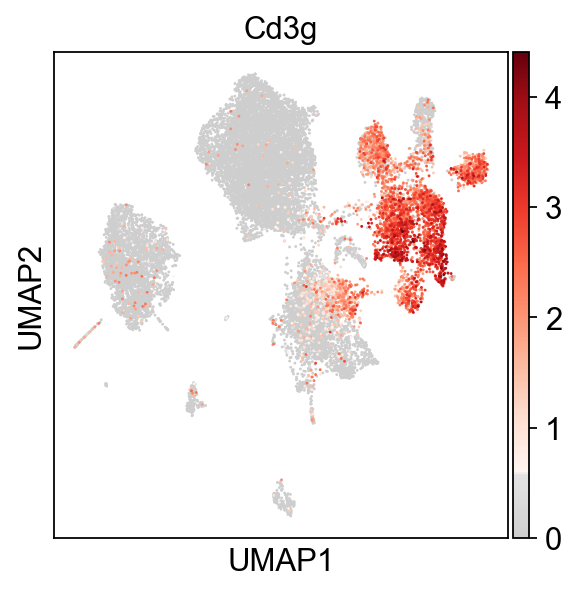

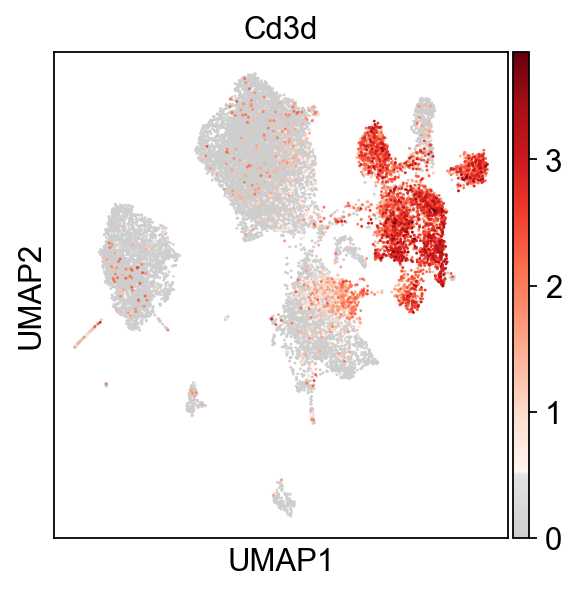

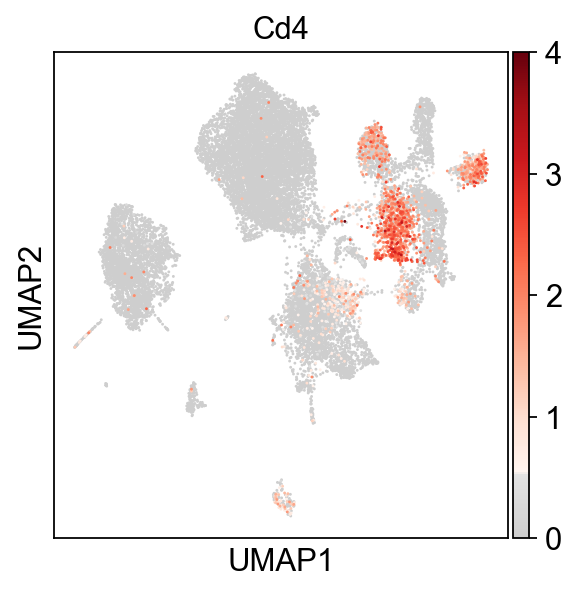

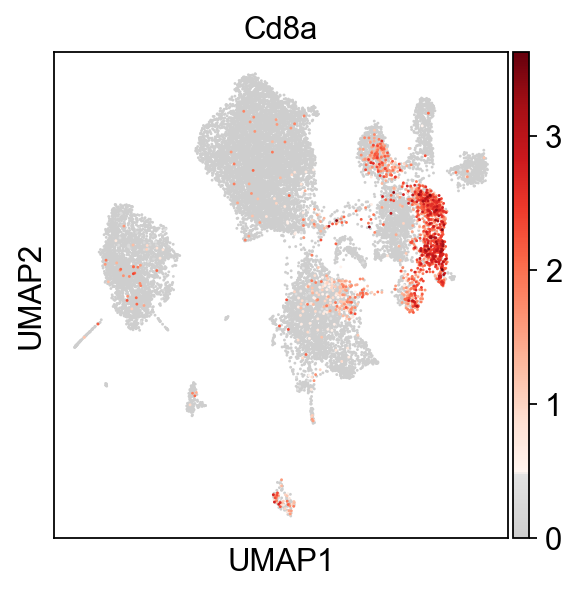

...

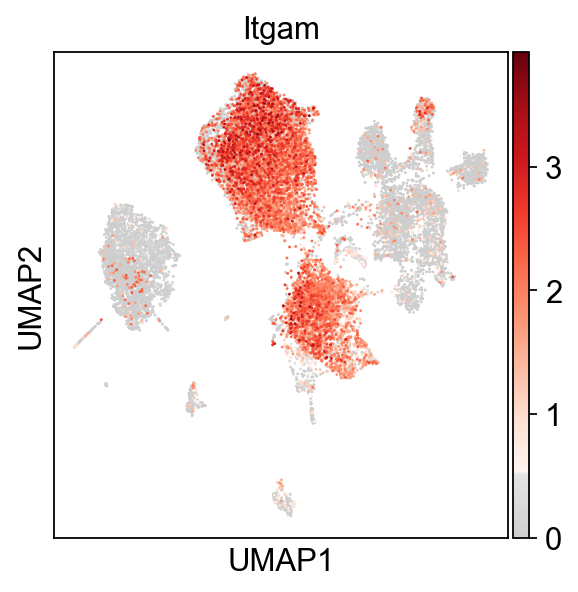

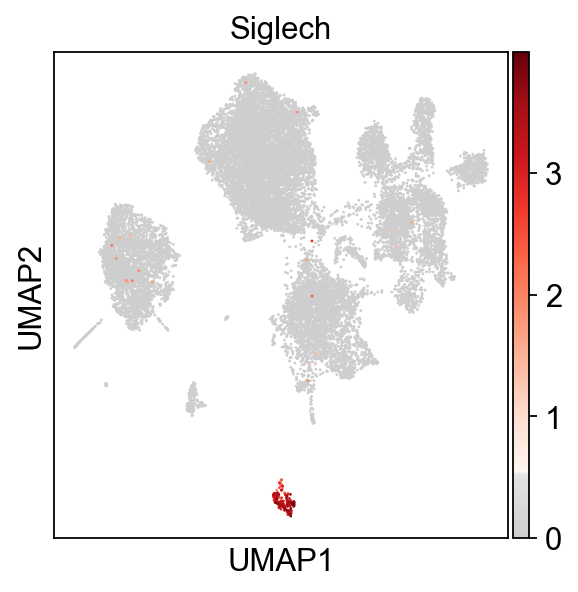

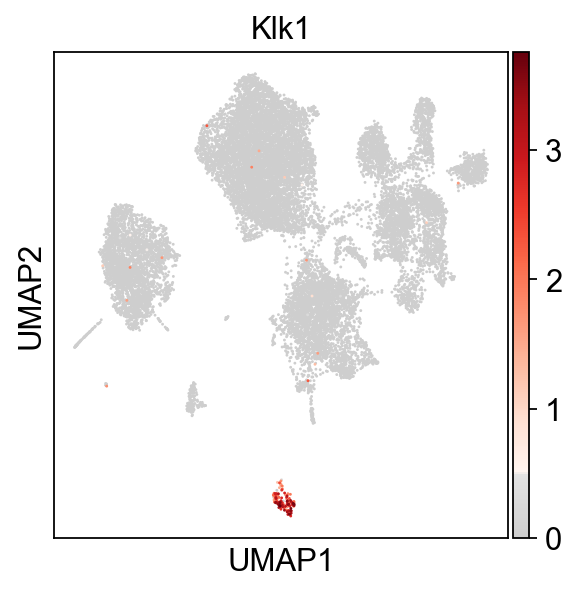

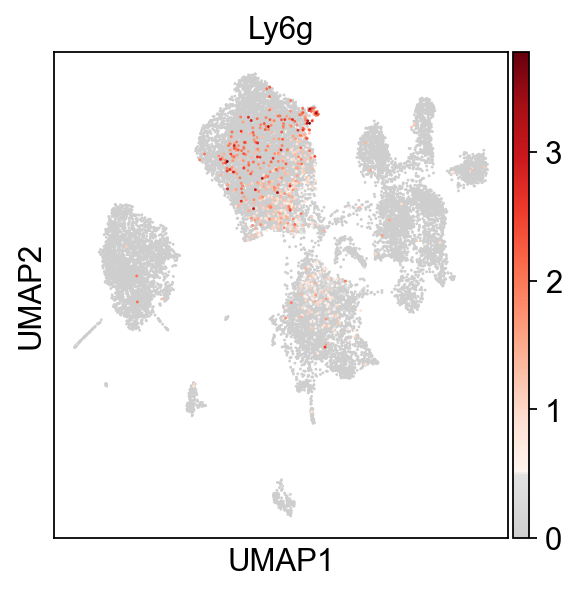

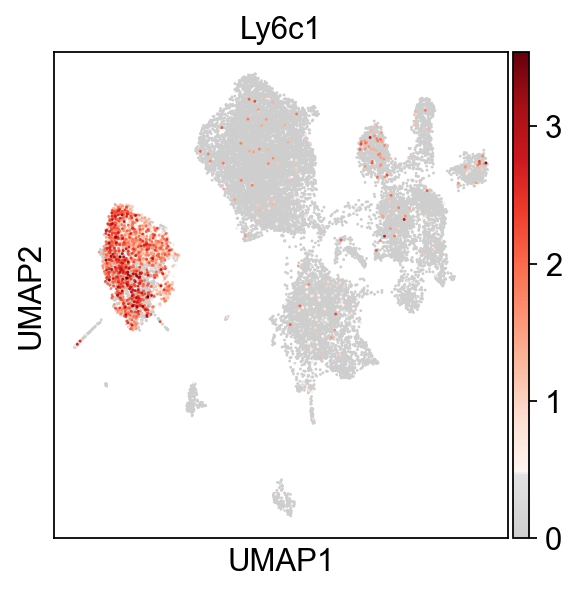

In [134]:
#Plot signiture marker gene
plt.rcParams["figure.figsize"] = (4,4)
sc.pl.umap(adata, color='Ptprc', use_raw=True, color_map=mymap) #CD45
sc.pl.umap(adata, color='Cd3g', use_raw=True, color_map=mymap)
sc.pl.umap(adata, color='Cd3d', use_raw=True, color_map=mymap) 
sc.pl.umap(adata, color='Cd4', use_raw=True, color_map=mymap)
sc.pl.umap(adata, color='Cd8a', use_raw=True, color_map=mymap)
sc.pl.umap(adata, color='H2-Ab1', use_raw=True, color_map=mymap)
sc.pl.umap(adata, color='Ncr1', use_raw=True, color_map=mymap) #macrophage
sc.pl.umap(adata, color='Cd19', use_raw=True, color_map=mymap) #APC
sc.pl.umap(adata, color='Cd14', use_raw=True, color_map=mymap) 
sc.pl.umap(adata, color='Csf1r', use_raw=True, color_map=mymap) #epithelial
sc.pl.umap(adata, color='Csf3r', use_raw=True, color_map=mymap)
sc.pl.umap(adata, color='Itgam', use_raw=True, color_map=mymap) 
sc.pl.umap(adata, color='Siglech', use_raw=True, color_map=mymap) #pDC
sc.pl.umap(adata, color='Klk1', use_raw=True, color_map=mymap) 
sc.pl.umap(adata, color='Ly6g', use_raw=True, color_map=mymap) 
sc.pl.umap(adata, color='Ly6c1', use_raw=True, color_map=mymap)

In [108]:
adata.rename_categories('louvain_r0.2', ['Neutrophils', 'T cells/NK cells', 'MC/Macro/cDC','CancerCell','B cell','pDC','Fibroblast','Mast cell'])
#CD45data.rename_categories('louvain_r0.2', ['Neutrophils', 'T cells/NK cells', 'MC/Macro/cDC','B cell','pDC','Mast cell'])

In [112]:
clusters = adata[adata.obs['treat']=='Ctl'].obs['louvain_r0.2'].cat.categories
clusters

Index(['Neutrophils', 'T cells/NK cells', 'MC/Macro/cDC', 'CancerCell',
       'B cell', 'pDC', 'Fibroblast', 'Mast cell'],
      dtype='object')

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


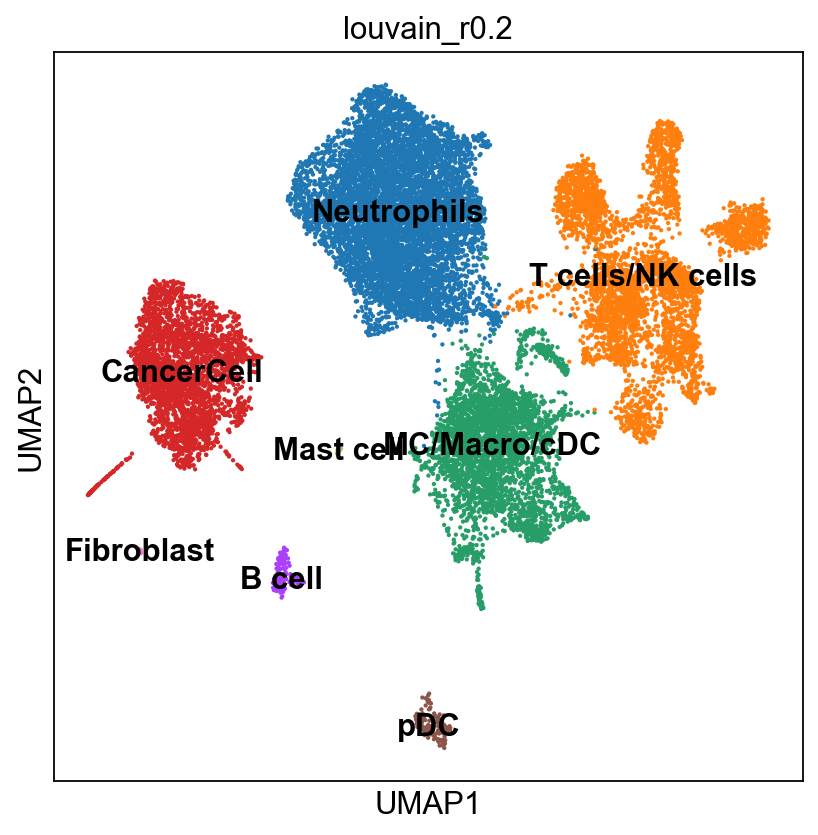

In [98]:
plt.rcParams["figure.figsize"] = (6,6)
sc.pl.umap(adata, color=['louvain_r0.2'], size=15, legend_loc='on data')

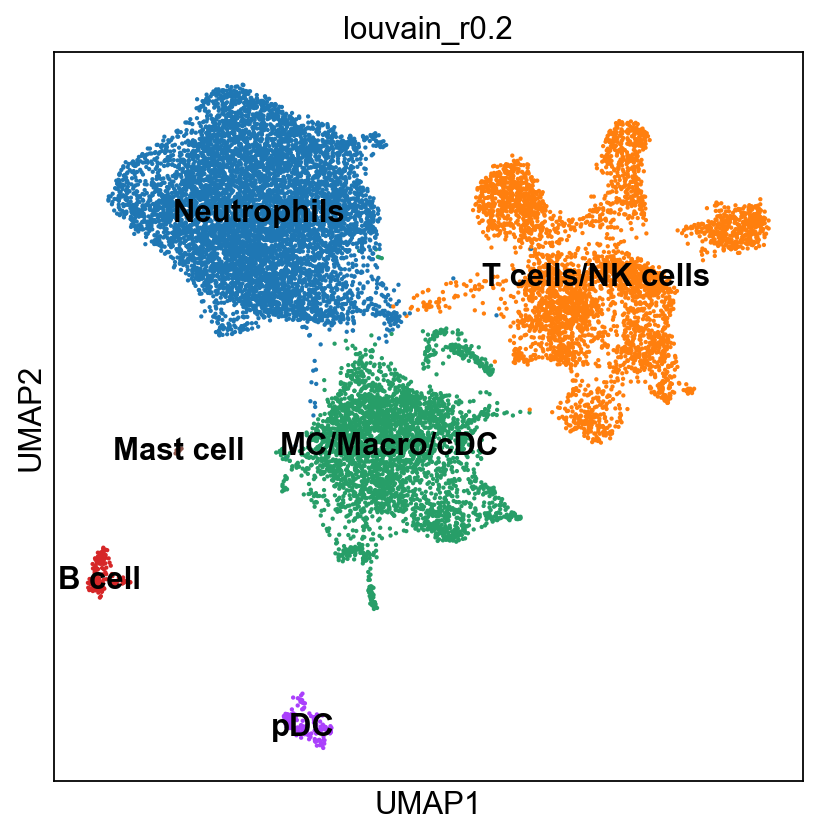

In [109]:
plt.rcParams["figure.figsize"] = (6,6)
sc.pl.umap(CD45data, color=['louvain_r0.2'], size=15, legend_loc='on data')

8
{'Neutrophils': 0.515274949083503, 'T cells/NK cells': 0.14293649324199223, 'MC/Macro/cDC': 0.1690427698574338, 'CancerCell': 0.1570079614886132, 'B cell': 0.0033327161636733937, 'pDC': 0.010738752082947603, 'Fibroblast': 0.0007406035919274209, 'Mast cell': 0.0009257544899092761}
[0.515274949083503, 0.388423645320197, 0.3760907504363002, 0.31663820906848794] [0, 0, 0, 0]
[0.14293649324199223, 0.19310344827586207, 0.22484002326934263, 0.3244166192373364] [0.515274949083503, 0.388423645320197, 0.3760907504363002, 0.31663820906848794]
[0.1690427698574338, 0.21945812807881773, 0.20738801628853984, 0.18573325744640487] [0.6582114423254952, 0.581527093596059, 0.6009307737056429, 0.6410548283058244]
[0.1570079614886132, 0.18300492610837438, 0.17975567190226877, 0.14437488142667426] [0.827254212182929, 0.8009852216748767, 0.8083187899941827, 0.8267880857522293]
[0.0033327161636733937, 0.002955665024630542, 0.0011634671320535194, 0.02428381711250237] [0.9842621736715422, 0.9839901477832511, 0

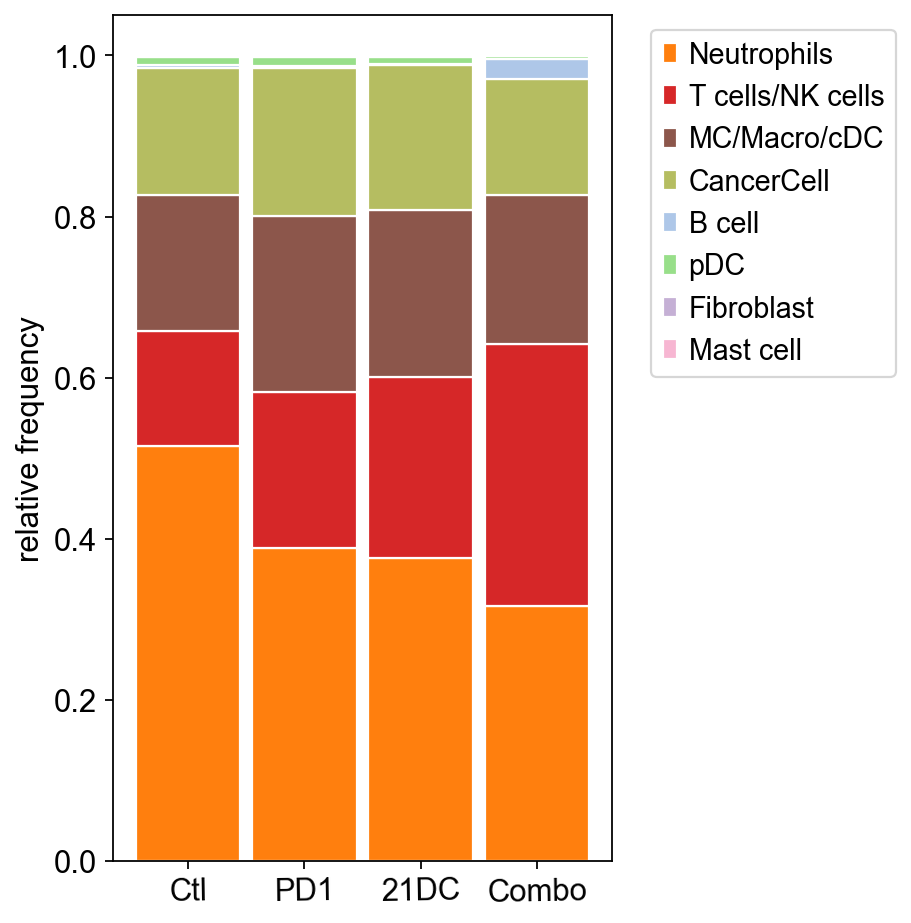

In [113]:

ctlcount = adata[adata.obs['treat']=='Ctl'].obs['louvain_r0.2'].value_counts()
pd1count = adata[adata.obs['treat']=='PD1'].obs['louvain_r0.2'].value_counts()
dccount = adata[adata.obs['treat']=='21DC'].obs['louvain_r0.2'].value_counts()
combocount = adata[adata.obs['treat']=='Combo'].obs['louvain_r0.2'].value_counts()

plt.rcParams["figure.figsize"] = (4,4)
r=[0,1,2,3]
bottom = [0,0,0,0]
ctlfreq={}
pd1freq = {}
dcfreq = {}
combofreq = {}
for i in clusters:
    ctlfreq[i] = ctlcount[i]/sum(ctlcount)
    pd1freq[i] = pd1count[i]/sum(pd1count)
    dcfreq[i] = dccount[i]/sum(dccount)
    combofreq[i] = combocount[i]/sum(combocount)
    
handlelist = []
print (len(ctlcount))
print (ctlfreq)


plt.rcParams["figure.figsize"] = (6,6)
for i in clusters:
    height = [ctlfreq[str(i)],pd1freq[str(i)],dcfreq[str(i)],combofreq[str(i)]]
    print (height,bottom)
    plt.bar(r,height,bottom=bottom)
    ax = plt.bar(r,height,bottom=bottom,edgecolor='white',width=0.9,label=str(i))
#    ax = plt.bar(r,height,bottom=bottom,label='group'+str(i))
    handlelist.append(ax)
    bottom[0] += height[0]
    bottom[1] += height[1]
    bottom[2] += height[2]
    bottom[3] += height[3]
plt.xticks(r,['Ctl','PD1','21DC','Combo'],rotation=True)
plt.grid(False)
plt.ylabel('relative frequency')
plt.legend(handles=handlelist, bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

6
{'Neutrophils': 0.6117828094086613, 'T cells/NK cells': 0.1697076280501209, 'MC/Macro/cDC': 0.20070345130797979, 'B cell': 0.003956913607386239, 'pDC': 0.012750054957133435, 'Mast cell': 0.0010991426687183997}
[0.6117828094086613, 0.47585998792999396, 0.4589989350372737, 0.3703128466829377] [0, 0, 0, 0]
[0.1697076280501209, 0.23657211828605915, 0.2744053958111466, 0.3794098069669403] [0.6117828094086613, 0.47585998792999396, 0.4589989350372737, 0.3703128466829377]
[0.20070345130797979, 0.2688593844296922, 0.25310614128505504, 0.21721766141557577] [0.7814904374587821, 0.7124321062160531, 0.7334043308484203, 0.749722653649878]
[0.003956913607386239, 0.003621001810500905, 0.0014199503017394391, 0.028400266252496118] [0.9821938887667618, 0.9812914906457453, 0.9865104721334753, 0.9669403150654537]
[0.012750054957133435, 0.014182257091128546, 0.011359602413915513, 0.004215664521854893] [0.9861508023741481, 0.9849124924562462, 0.9879304224352148, 0.9953405813179499]
[0.0010991426687183997, 

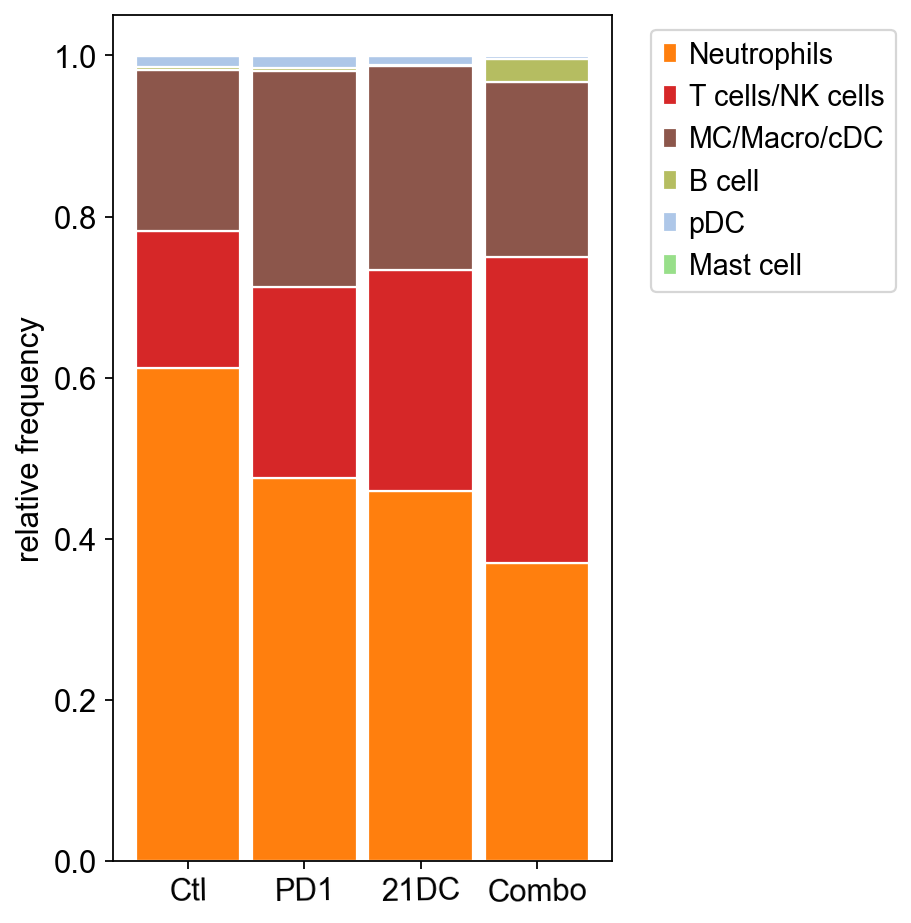

In [114]:


clusters = CD45data[CD45data.obs['treat']=='Ctl'].obs['louvain_r0.2'].cat.categories
clusters


ctlcount = CD45data[CD45data.obs['treat']=='Ctl'].obs['louvain_r0.2'].value_counts()
pd1count = CD45data[CD45data.obs['treat']=='PD1'].obs['louvain_r0.2'].value_counts()
dccount = CD45data[CD45data.obs['treat']=='21DC'].obs['louvain_r0.2'].value_counts()
combocount = CD45data[CD45data.obs['treat']=='Combo'].obs['louvain_r0.2'].value_counts()

plt.rcParams["figure.figsize"] = (4,4)
r=[0,1,2,3]
bottom = [0,0,0,0]
ctlfreq={}
pd1freq = {}
dcfreq = {}
combofreq = {}
for i in clusters:
    ctlfreq[i] = ctlcount[i]/sum(ctlcount)
    pd1freq[i] = pd1count[i]/sum(pd1count)
    dcfreq[i] = dccount[i]/sum(dccount)
    combofreq[i] = combocount[i]/sum(combocount)
    
handlelist = []
print (len(ctlcount))
print (ctlfreq)


plt.rcParams["figure.figsize"] = (6,6)
for i in clusters:
    height = [ctlfreq[str(i)],pd1freq[str(i)],dcfreq[str(i)],combofreq[str(i)]]
    print (height,bottom)
    plt.bar(r,height,bottom=bottom)
    ax = plt.bar(r,height,bottom=bottom,edgecolor='white',width=0.9,label=str(i))
#    ax = plt.bar(r,height,bottom=bottom,label='group'+str(i))
    handlelist.append(ax)
    bottom[0] += height[0]
    bottom[1] += height[1]
    bottom[2] += height[2]
    bottom[3] += height[3]
plt.xticks(r,['Ctl','PD1','21DC','Combo'],rotation=True)
plt.grid(False)
plt.ylabel('relative frequency')
plt.legend(handles=handlelist, bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

In [115]:
print ('Ctl:\n', adata[adata.obs['treat']=='Ctl'].obs['louvain_r0.2'].value_counts())
print ('PD1:\n', adata[adata.obs['treat']=='PD1'].obs['louvain_r0.2'].value_counts())
print ('21DC:\n', adata[adata.obs['treat']=='21DC'].obs['louvain_r0.2'].value_counts())
print ('Combo:\n', adata[adata.obs['treat']=='Combo'].obs['louvain_r0.2'].value_counts())

Ctl:
 Neutrophils         2783
MC/Macro/cDC         913
CancerCell           848
T cells/NK cells     772
pDC                   58
B cell                18
Mast cell              5
Fibroblast             4
Name: louvain_r0.2, dtype: int64
PD1:
 Neutrophils         1577
MC/Macro/cDC         891
T cells/NK cells     784
CancerCell           743
pDC                   47
B cell                12
Mast cell              3
Fibroblast             3
Name: louvain_r0.2, dtype: int64
21DC:
 Neutrophils         1293
T cells/NK cells     773
MC/Macro/cDC         713
CancerCell           618
pDC                   32
B cell                 4
Fibroblast             3
Mast cell              2
Name: louvain_r0.2, dtype: int64
Combo:
 T cells/NK cells    1710
Neutrophils         1669
MC/Macro/cDC         979
CancerCell           761
B cell               128
pDC                   19
Fibroblast             3
Mast cell              2
Name: louvain_r0.2, dtype: int64


In [117]:
#Tmp data storage
adata.write('Bin_Ramin_adata_clusters.h5ad') #Temp Storage

# Subclustering

# CD45- 

In [118]:
Can = adata[adata.obs['louvain_r0.2']== 'CancerCell']

In [119]:
sc.tl.leiden(Can,resolution=0.1,key_added='louvain_r0.5' )

running Leiden clustering


Trying to set attribute `.obs` of view, copying.


    finished: found 3 clusters and added
    'louvain_r0.5', the cluster labels (adata.obs, categorical) (0:00:00)


ranking genes
    finished: added to `.uns['rank_genes_r0.5']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


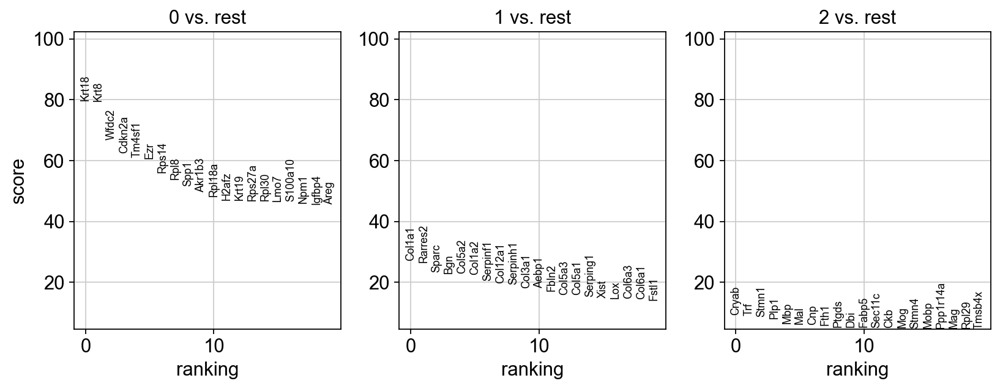

In [120]:
sc.tl.rank_genes_groups(Can, groupby='louvain_r0.5', method='t-test_overestim_var',key_added='rank_genes_r0.5')
#sc.tl.rank_genes_groups(adata, 'leiden', method='logreg')
#sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)
#this one look good
plt.rcParams["figure.figsize"] = (4,4)
sc.pl.rank_genes_groups(Can, key='rank_genes_r0.5')

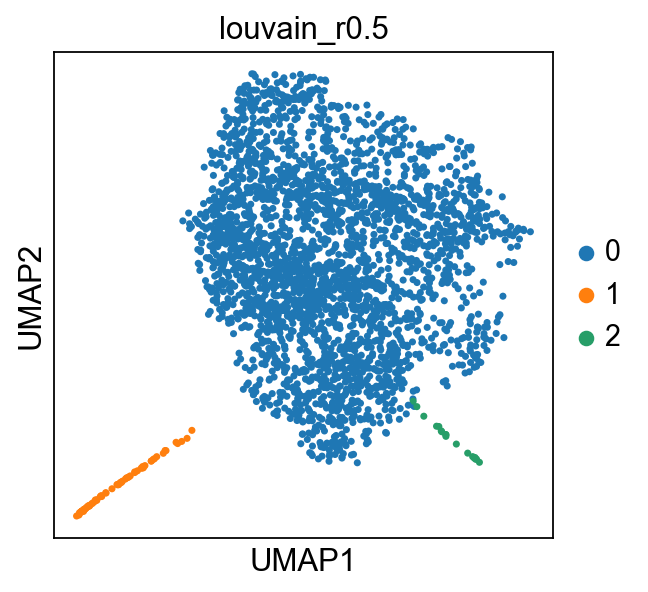

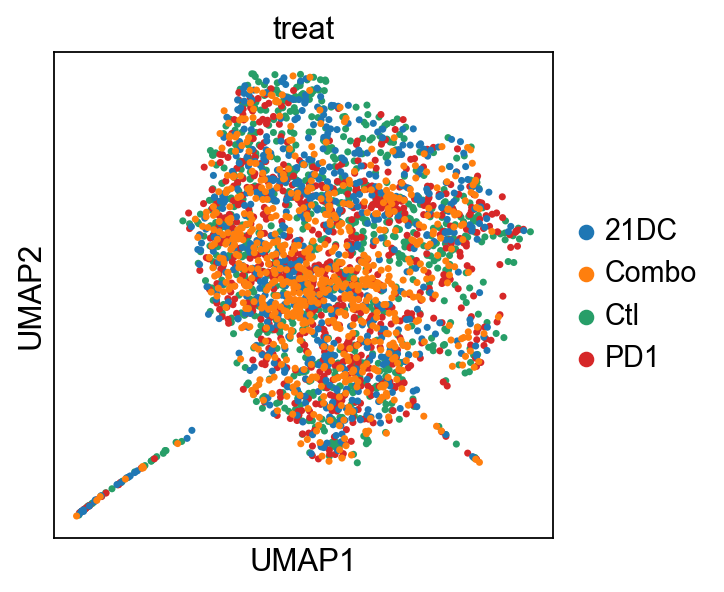

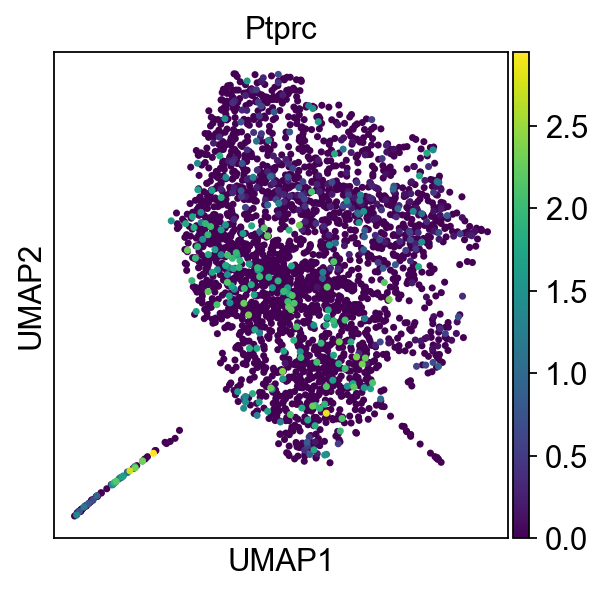

0    2880
1      72
2      18
Name: louvain_r0.5, dtype: int64

In [126]:
plt.rcParams["figure.figsize"] = (4,4)
sc.pl.umap(Can, color='louvain_r0.5', palette=sc.pl.palettes.default_20)
sc.pl.umap(Can, color='treat')
sc.pl.umap(Can, color='Ptprc')
Can.obs['louvain_r0.5'].value_counts()

<AxesSubplot:>

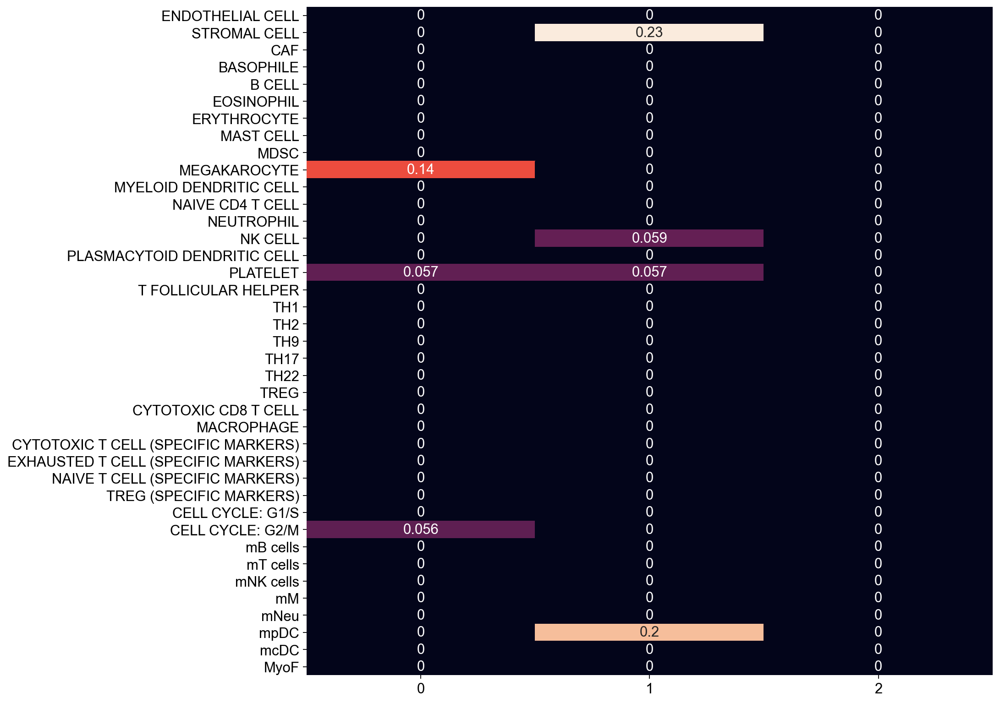

In [122]:
plt.rcParams["figure.figsize"] = (12,12)
cell_annotation_norm = sc.tl.marker_gene_overlap(Can, marker_genes, key='rank_genes_r0.5', normalize='reference',top_n_markers=200)
cell_annotation_norm_Zhang = sc.tl.marker_gene_overlap(Can, marker_genes_Zhang, key='rank_genes_r0.5', normalize='reference',top_n_markers=200)
sb.heatmap(cell_annotation_norm, cbar=False, annot=True)
#sb.heatmap(cell_annotation_norm_Zhang, cbar=False, annot=True)

As cluster 1& 2 has only less than 100 cells, I focused on cluster 0 to do the DE analysis. Also cluster 0 co-cluster with my CD45- enriched cancer, so should be cancer cells.
Cluster1 maybe stromal cells. 

Please note that although the majority of cells are CD45-, there are still a small proportion of cells that showed expression of CD45.

Here I did comparison of each treatment to the rest of treatments, but if you want to perform pair-wise comparision, we can do that as well. 

Also, I plotted the top 30 differential genes, if you want to look at more genes, I can export them into files. 

In [128]:
Cancer=Can[Can.obs['louvain_r0.5']=='0']

ranking genes
    finished: added to `.uns['Can_DE_results']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


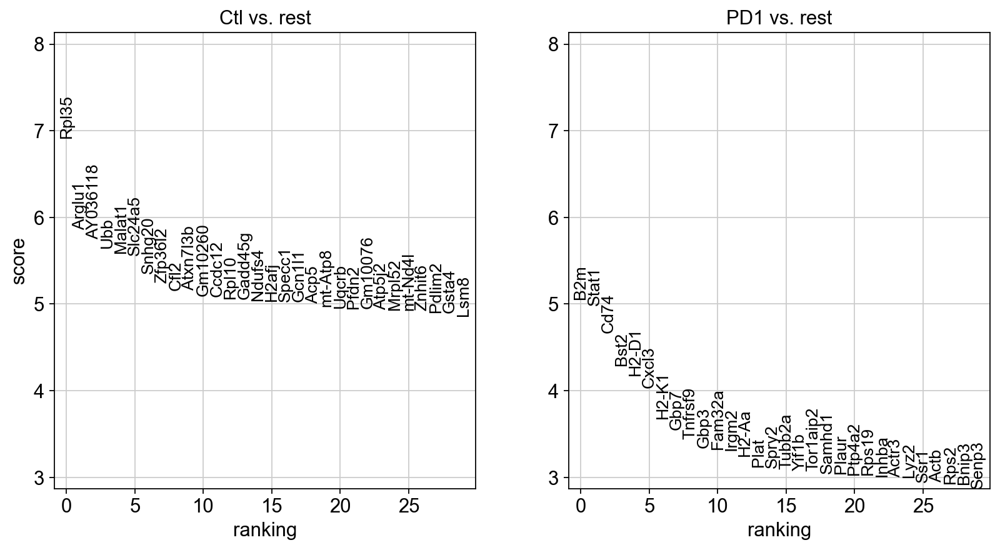

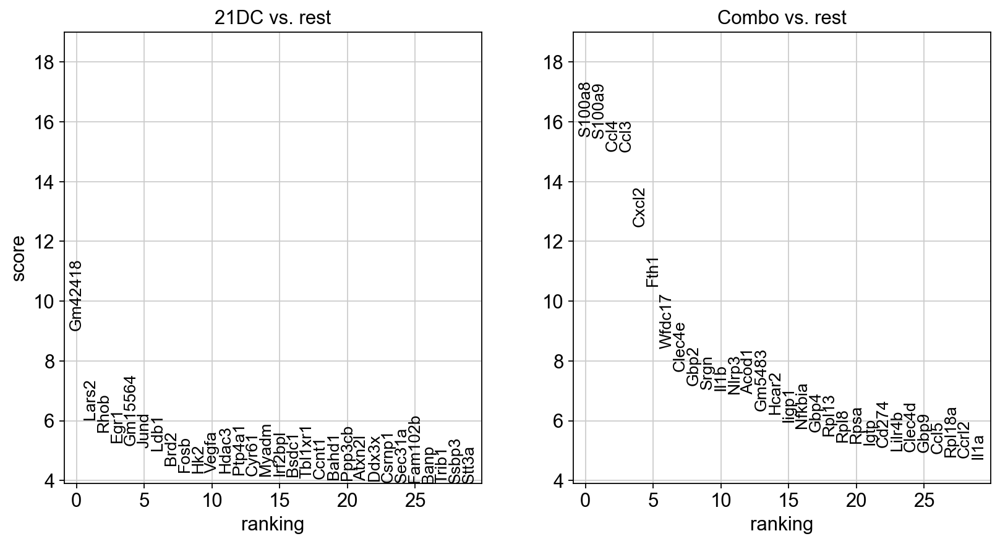

In [131]:
plt.rcParams["figure.figsize"] = (6,6)
sc.tl.rank_genes_groups(Cancer, groupby='treat',groups=['Ctl','PD1','21DC','Combo'],key_added='Can_DE_results',n_genes=1000)
#sc.tl.rank_genes_groups(Cancer, groupby='treat',groups=['WT'],reference='HIS',key_added='Cancer_DE_WTvsHIS',n_genes=1000)
#sc.tl.rank_genes_groups(Cancer, groupby='treat',groups=['HIS'],reference='WT',key_added='Cancer_DE_HISvsWT',n_genes=1000)
#sc.tl.rank_genes_groups(Cancer, groupby='treat',groups=['WT'],reference='Ctl',key_added='Cancer_DE_WTvsCtl',n_genes=1000)
#sc.tl.rank_genes_groups(Cancer, groupby='treat',groups=['HIS'],reference='Ctl',key_added='Cancer_DE_HISvsCtl',n_genes=1000)


sc.pl.rank_genes_groups(Cancer, key='Can_DE_results', groups=['Ctl','PD1'],fontsize=12,n_genes=30)
sc.pl.rank_genes_groups(Cancer, key='Can_DE_results', groups=['21DC','Combo'],fontsize=12,n_genes=30)
#sc.pl.rank_genes_groups(Cancer, key='Cancer_DE_WTvsHIS', fontsize=12)
#sc.pl.rank_genes_groups(Cancer, key='Cancer_DE_HISvsWT', fontsize=12)
#sc.pl.rank_genes_groups(Cancer, key='Cancer_DE_WTvsCtl', fontsize=12)
#sc.pl.rank_genes_groups(Cancer, key='Cancer_DE_HISvsCtl', fontsize=12)
#sc.pl.rank_genes_groups_heatmap(Cancer, key='Cancer_DE_WTvsHIS',n_genes=15,show_gene_labels=True, cmap='RdYlBu_r')

# Neutrophil 

In [153]:
Neu = CD45data[CD45data.obs['louvain_r0.2']== 'Neutrophils']

In [173]:
sc.tl.leiden(Neu,resolution=0.3,key_added='louvain_r0.5' )

running Leiden clustering
    finished: found 4 clusters and added
    'louvain_r0.5', the cluster labels (adata.obs, categorical) (0:00:00)


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


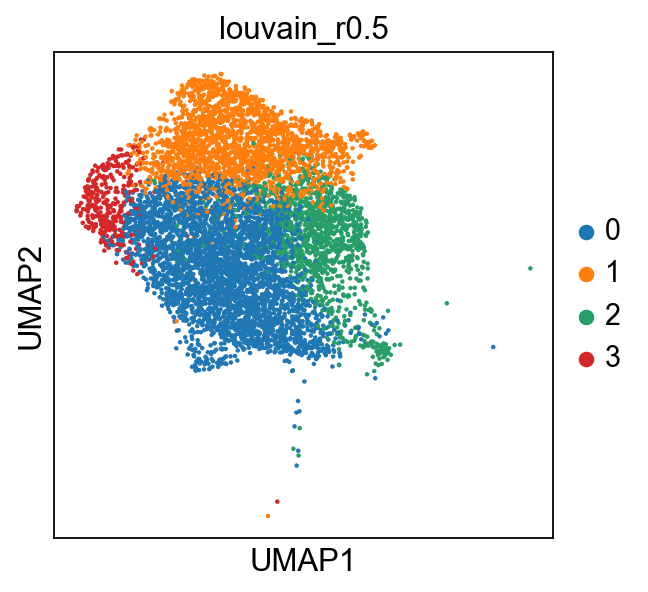

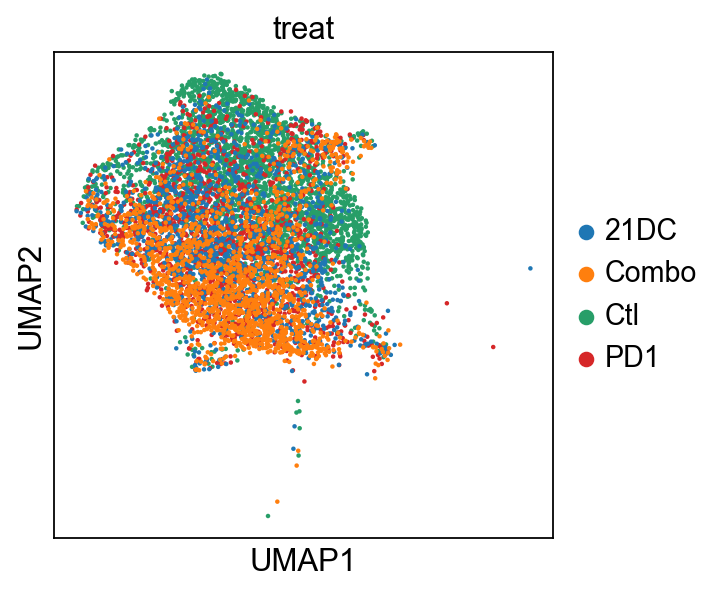

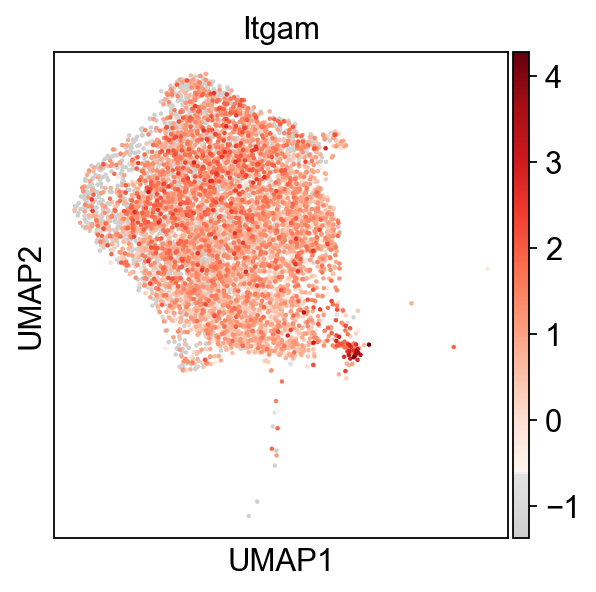

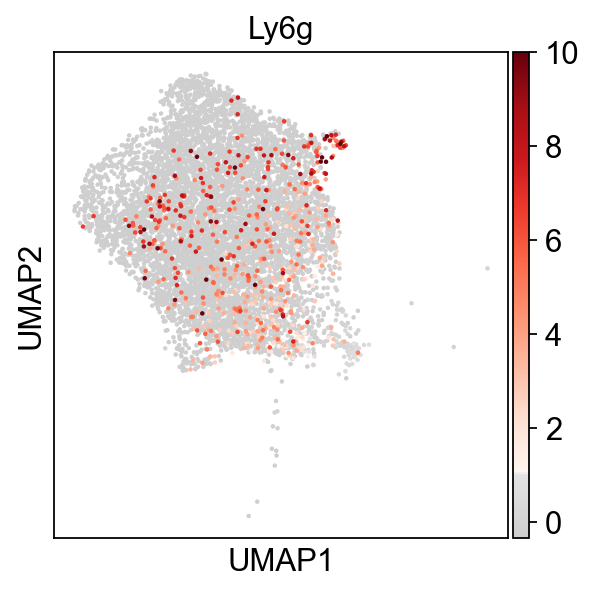

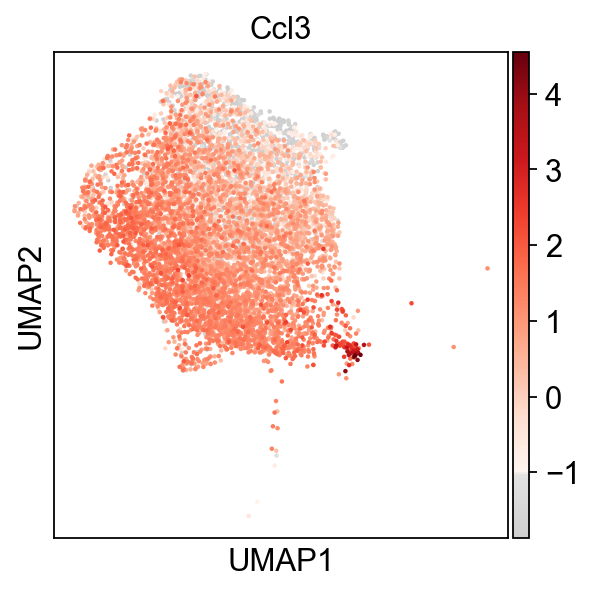

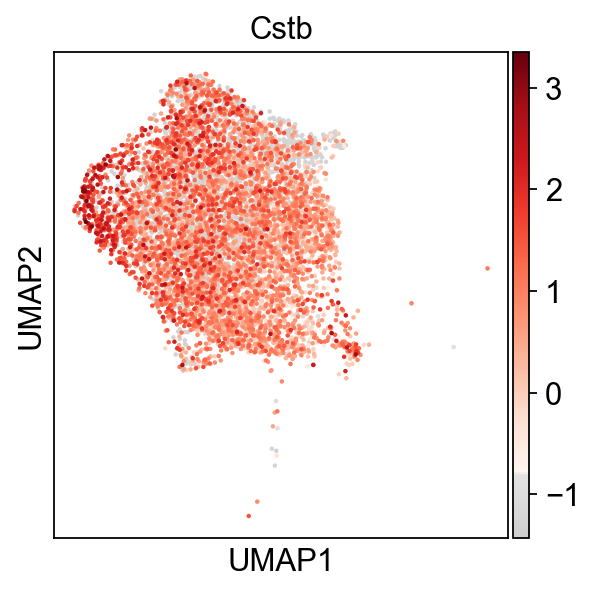

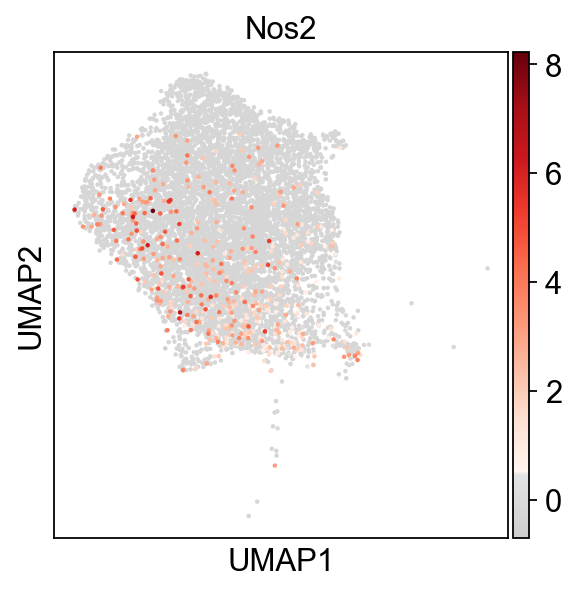

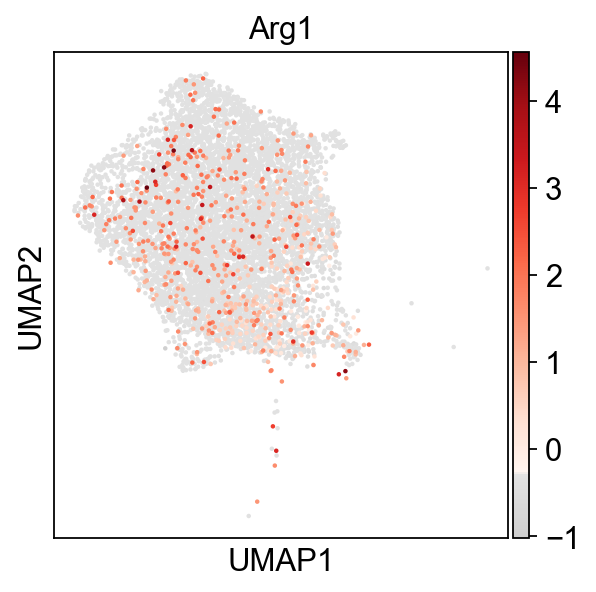

In [174]:
plt.rcParams["figure.figsize"] = (4,4)
sc.pl.umap(Neu, color='louvain_r0.5', palette=sc.pl.palettes.default_20)
sc.pl.umap(Neu, color='treat')
sc.pl.umap(Neu, color='Itgam', use_raw=False, color_map=mymap) 
sc.pl.umap(Neu, color='Ly6g', use_raw=False, color_map=mymap) 
sc.pl.umap(Neu, color='Ccl3', use_raw=False, color_map=mymap) 
sc.pl.umap(Neu, color='Cstb', use_raw=False, color_map=mymap) 
sc.pl.umap(Neu, color='Nos2', use_raw=False, color_map=mymap)  #MDSC marker, not significant
sc.pl.umap(Neu, color='Arg1', use_raw=False, color_map=mymap) 

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


1    1247
2     845
0     559
3     132
Name: louvain_r0.5, dtype: int64
[0.20086237872799137, 0.6569435637285986, 0.5475638051044084, 0.8124625524266027] [0, 0, 0, 0]
[0.4480776140855192, 0.20355104629042486, 0.2273781902552204, 0.11683642899940083] [0.20086237872799137, 0.6569435637285986, 0.5475638051044084, 0.8124625524266027]
[0.3036291771469637, 0.08814204185161699, 0.16705336426914152, 0.033553025763930495] [0.6489399928135106, 0.8604946100190235, 0.7749419953596288, 0.9292989814260035]
[0.04743083003952569, 0.05136334812935954, 0.058004640371229696, 0.03714799281006591] [0.9525691699604742, 0.9486366518706405, 0.9419953596287703, 0.962852007189934]


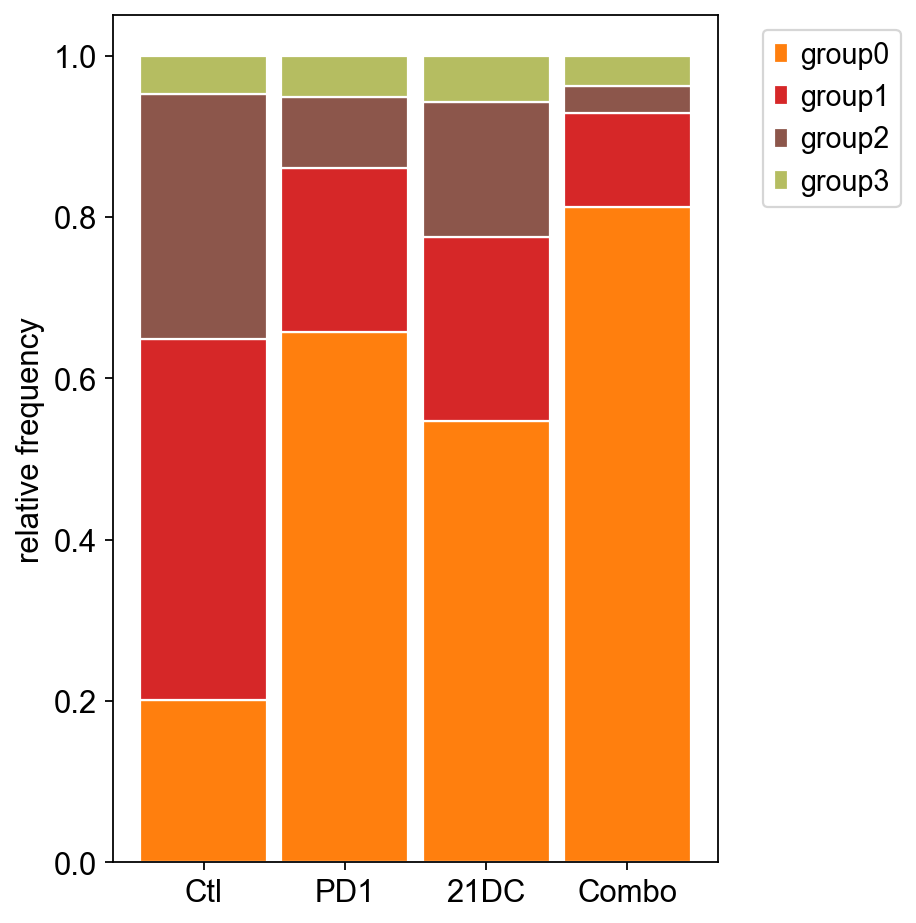

In [175]:
ctlcount = Neu[Neu.obs['treat']=='Ctl'].obs['louvain_r0.5'].value_counts()
pd1count = Neu[Neu.obs['treat']=='PD1'].obs['louvain_r0.5'].value_counts()
dccount = Neu[Neu.obs['treat']=='21DC'].obs['louvain_r0.5'].value_counts()
combocount = Neu[Neu.obs['treat']=='Combo'].obs['louvain_r0.5'].value_counts()
print (ctlcount)

plt.rcParams["figure.figsize"] = (6,6)
r=[0,1,2,3]
bottom = [0,0,0,0]
ctlfreq = {}
pd1freq = {}
dcfreq = {}
combofreq = {}
for i in range(len(ctlcount)):
    ctlfreq[ctlcount.index[i]] = ctlcount[i]/sum(ctlcount)
    pd1freq[pd1count.index[i]] = pd1count[i]/sum(pd1count)
    dcfreq[dccount.index[i]] = dccount[i]/sum(dccount)
    combofreq[combocount.index[i]] = combocount[i]/sum(combocount)
    
handlelist = []

for i in range(len(ctlcount)):
    height = [ctlfreq[str(i)],pd1freq[str(i)],dcfreq[str(i)],combofreq[str(i)]]
    print (height,bottom)
    plt.bar(r,height,bottom=bottom)
    ax = plt.bar(r,height,bottom=bottom,edgecolor='white',width=0.9,label='group'+str(i))
#    ax = plt.bar(r,height,bottom=bottom,label='group'+str(i))
    handlelist.append(ax)
    bottom[0] += height[0]
    bottom[1] += height[1]
    bottom[2] += height[2]
    bottom[3] += height[3]
plt.xticks(r,['Ctl','PD1','21DC','Combo'])
plt.grid(False)
plt.ylabel('relative frequency')
plt.legend(handles=handlelist, bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

ranking genes
    finished: added to `.uns['Neutrophil_Rankgenes_0.5']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


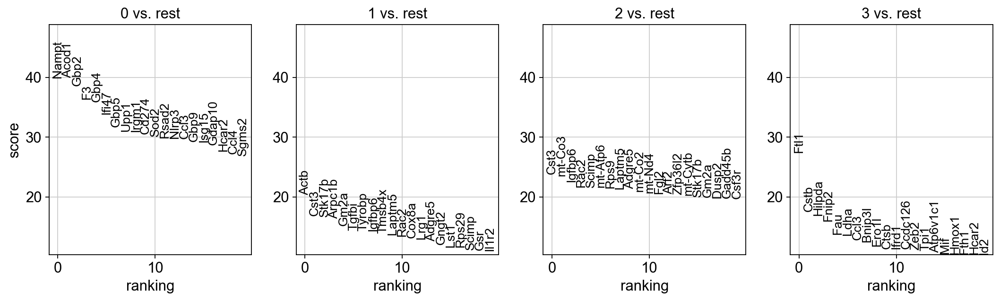

In [177]:
plt.rcParams["figure.figsize"] = (4,4)
#sc.tl.dendrogram(Neu,groupby='louvain_r0.5')
sc.tl.rank_genes_groups(Neu, groupby='louvain_r0.5',key_added='Neutrophil_Rankgenes_0.5',n_genes=200)
sc.pl.rank_genes_groups(Neu, key='Neutrophil_Rankgenes_0.5', groups=['0','1','2','3'], fontsize=12)
#sc.pl.rank_genes_groups(Neu, key='Neutrophil_Rankgenes_0.5', groups=['4','5','6'], fontsize=12)
#sc.pl.rank_genes_groups_heatmap(Neu, key='Neutrophil_Rankgenes', groups=['0','1','2','3','4','5'])
#sc.pl.rank_genes_groups_heatmap(Neu,n_genes=15,show_gene_labels=True, cmap='RdYlBu_r')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_louvain_r0.5']`


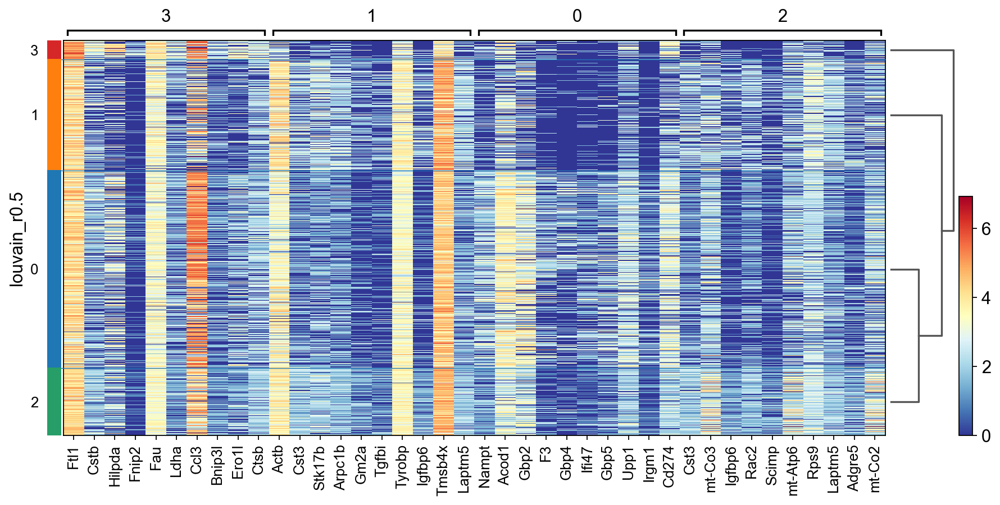

In [178]:

sc.pl.rank_genes_groups_heatmap(Neu, key='Neutrophil_Rankgenes_0.5', groups=['0','1','2','3'],n_genes=10,show_gene_labels=True, cmap='RdYlBu_r')


<AxesSubplot:>

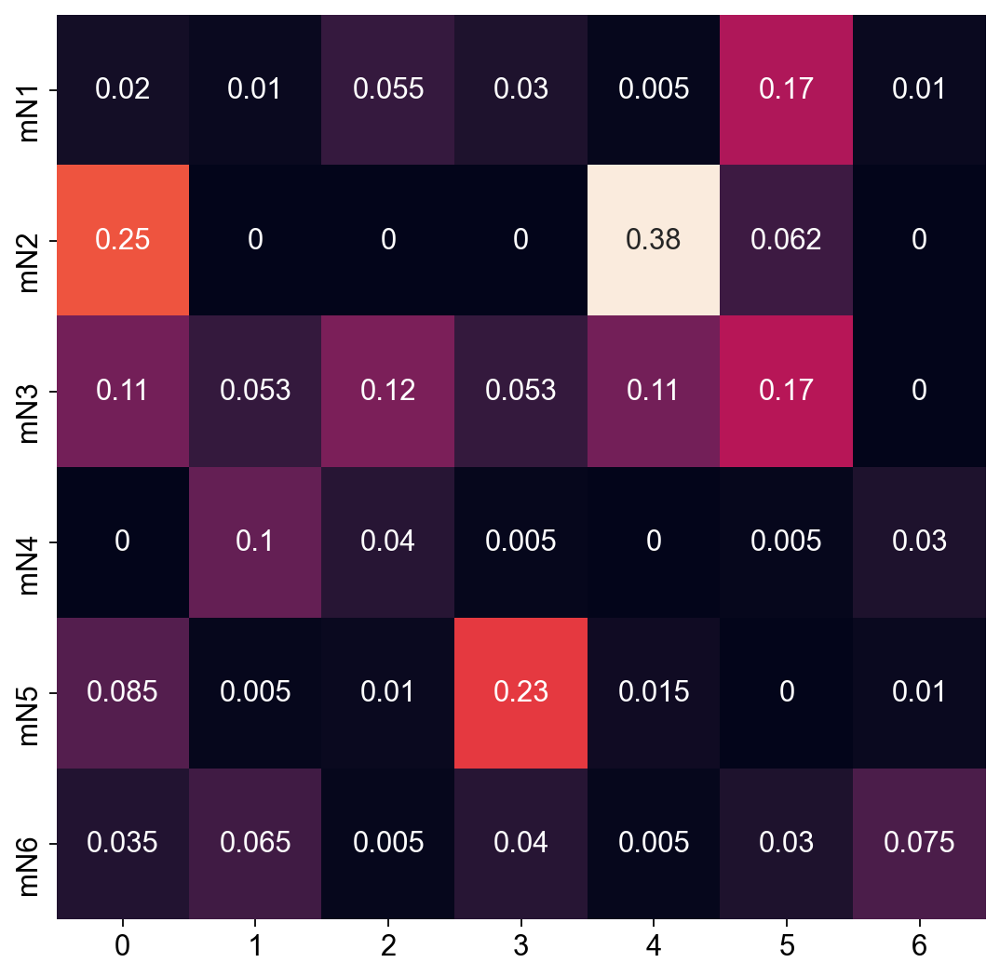

In [163]:
reffile = '../ref_gene_N_Immunity'
refdict = {}
ref_genes = pd.read_table(reffile, delimiter='\t')
for celltype in ref_genes:
    genelist = ref_genes[celltype].dropna()
    refdict[celltype] = [gene.lower().capitalize() for gene in genelist]
marker_genes_N = refdict

#cell_annotation = sc.tl.marker_gene_overlap(adata, marker_genes, key='rank_genes_r0.2',top_n_markers=200)
#cell_annotation = sc.tl.marker_gene_overlap(Neu,marker_genes_N, key='Neutrophil_Rankgenes',method='overlap_coef',top_n_markers=200)
plt.rcParams["figure.figsize"] = (8,8)
cell_annotation_norm = sc.tl.marker_gene_overlap(Neu, marker_genes_N, key='Neutrophil_Rankgenes_0.5', normalize='reference',top_n_markers=200)
#cell_annotation_norm_Zhang = sc.tl.marker_gene_overlap(adata, marker_genes_Zhang, key='rank_genes_r0.2', normalize='reference',top_n_markers=200)
sb.heatmap(cell_annotation_norm, cbar=False, annot=True)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns["dendrogram_['louvain_r0.5']"]`


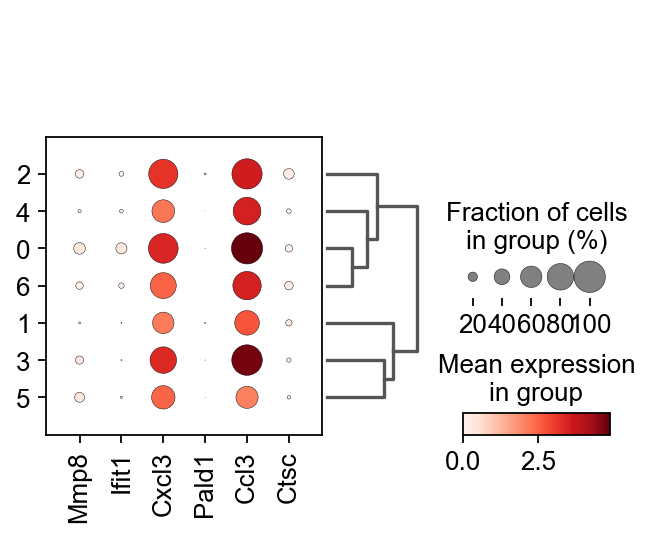

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


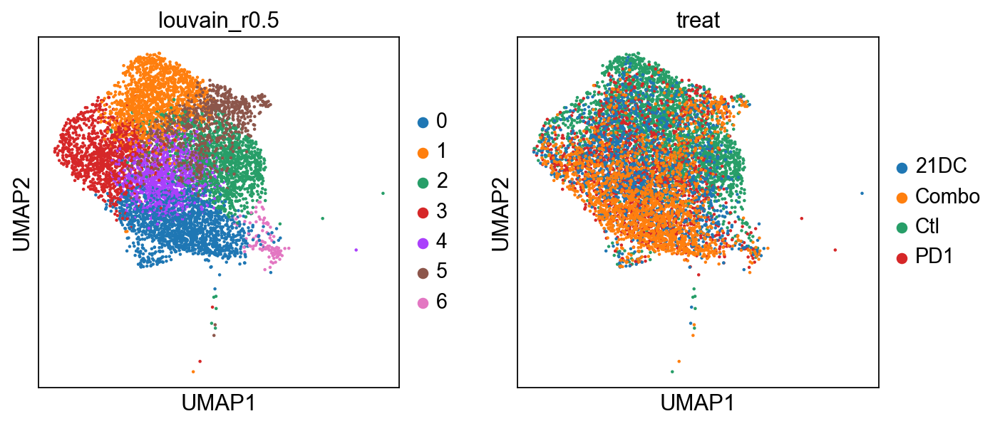

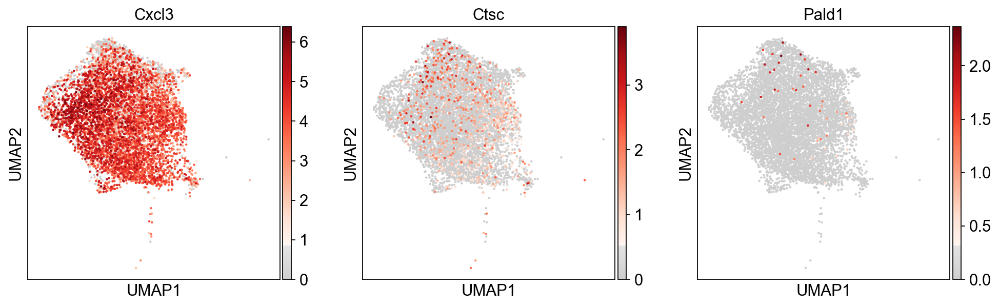

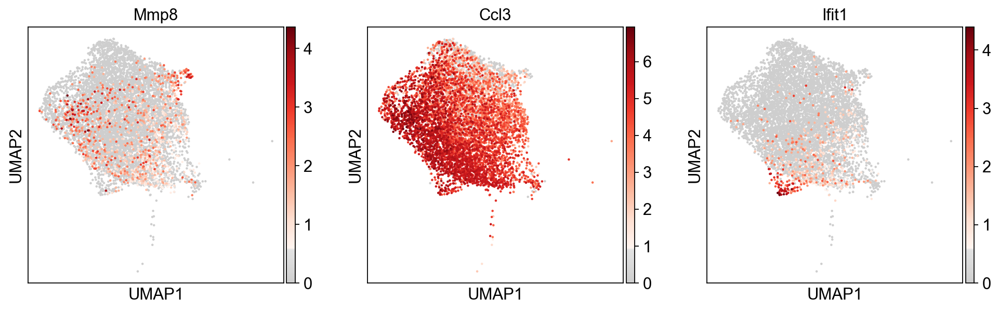

In [164]:
ImmunityMarker=['Mmp8','Ifit1','Cxcl3','Pald1','Ccl3','Ctsc']
sc.pl.dotplot(Neu, ImmunityMarker, groupby='louvain_r0.5', dendrogram=True)
plt.rcParams["figure.figsize"] = (4,4)
sc.pl.umap(Neu,color=['louvain_r0.5','treat'])
stem_genes = Neu.var_names[np.in1d(Neu.var_names, ImmunityMarker)] 
sc.pl.umap(Neu, color=stem_genes[0:3], title=stem_genes[0:3], color_map=mymap)
sc.pl.umap(Neu, color=stem_genes[3:], title=stem_genes[3:], color_map=mymap)

In [226]:
def marker_gene_expression(anndata, marker_dict, partition_key,gene_symbol_key=None, ):
    """A function go get mean z-score expressions of marker genes
    # 
    # Inputs:
    #    anndata         - An AnnData object containing the data set and a partition
    #    marker_dict     - A dictionary with cell-type markers. The markers should be stores as anndata.var_names or 
    #                      an anndata.var field with the key given by the gene_symbol_key input
    #    gene_symbol_key - The key for the anndata.var field with gene IDs or names that correspond to the marker 
    #                      genes
    #    partition_key   - The key for the anndata.obs field where the cluster IDs are stored. The default is
    #                      'louvain_r1' """

    #Test inputs
    if partition_key not in anndata.obs.columns.values:
        print('KeyError: The partition key was not found in the passed AnnData object.')
        print('   Have you done the clustering? If so, please tell pass the cluster IDs with the AnnData object!')
        raise

    if (gene_symbol_key != None) and (gene_symbol_key not in anndata.var.columns.values):
        print('KeyError: The provided gene symbol key was not found in the passed AnnData object.')
        print('   Check that your cell type markers are given in a format that your anndata object knows!')
        raise
        

    if gene_symbol_key:
        gene_ids = anndata.var[gene_symbol_key]
    else:
        gene_ids = anndata.var_names

    clusters = anndata.obs[partition_key].cat.categories
    n_clust = len(clusters)
    marker_exp = pd.DataFrame(columns=clusters)
    marker_exp['cell_type'] = pd.Series({}, dtype='str')
    marker_names = []
    
    z_scores = sc.pp.scale(anndata, copy=True)

    i = 0
    #for group in marker_dict:
        # Find the corresponding columns and get their mean expression in the cluster
    for gene in marker_dict:
        ens_idx = np.in1d(gene_ids, gene) #Note there may be multiple mappings
        if np.sum(ens_idx) == 0:
            continue
        else:
            z_scores.obs[ens_idx[0]] = z_scores.X[:,ens_idx].mean(1) #works for both single and multiple mapping
            ens_idx = ens_idx[0]

        clust_marker_exp = z_scores.obs.groupby(partition_key)[ens_idx].apply(np.mean).tolist()
        clust_marker_exp.append(partition_key)
        marker_exp.loc[i] = clust_marker_exp
        marker_names.append(gene)
        i+=1

    #Replace the rownames with informative gene symbols
    marker_exp.index = marker_names

    return(marker_exp)

#meanexp = marker_gene_expression(adata,adata.var.index)

#meanexp.to_csv("CD45+ClustersGeneExpression.csv")

In [165]:
def marker_gene_expression_dict(anndata, marker_dict, partition_key,gene_symbol_key=None, ):
    """A function go get mean z-score expressions of marker genes
    # 
    # Inputs:
    #    anndata         - An AnnData object containing the data set and a partition
    #    marker_dict     - A dictionary with cell-type markers. The markers should be stores as anndata.var_names or 
    #                      an anndata.var field with the key given by the gene_symbol_key input
    #    gene_symbol_key - The key for the anndata.var field with gene IDs or names that correspond to the marker 
    #                      genes
    #    partition_key   - The key for the anndata.obs field where the cluster IDs are stored. The default is
    #                      'louvain_r1' """

    #Test inputs
    if partition_key not in anndata.obs.columns.values:
        print('KeyError: The partition key was not found in the passed AnnData object.')
        print('   Have you done the clustering? If so, please tell pass the cluster IDs with the AnnData object!')
        raise

    if (gene_symbol_key != None) and (gene_symbol_key not in anndata.var.columns.values):
        print('KeyError: The provided gene symbol key was not found in the passed AnnData object.')
        print('   Check that your cell type markers are given in a format that your anndata object knows!')
        raise
        

    if gene_symbol_key:
        gene_ids = anndata.var[gene_symbol_key]
    else:
        gene_ids = anndata.var_names

    clusters = anndata.obs[partition_key].cat.categories
    n_clust = len(clusters)
    marker_exp = pd.DataFrame(columns=clusters)
    marker_exp['cell_type'] = pd.Series({}, dtype='str')
    marker_names = []
    
    z_scores = sc.pp.scale(anndata, copy=True)

    i = 0
    #for group in marker_dict:
        # Find the corresponding columns and get their mean expression in the cluster
    marker_dict_filter={}
    for key in marker_dict:
        marker_dict_filter[key]=[]
        for gene in marker_dict[key]:
            ens_idx = np.in1d(gene_ids, gene) #Note there may be multiple mappings
            if np.sum(ens_idx) == 0:
                continue
            else:
                z_scores.obs[ens_idx[0]] = z_scores.X[:,ens_idx].mean(1) #works for both single and multiple mapping
                ens_idx = ens_idx[0]
                marker_dict_filter[key].append(gene)

            clust_marker_exp = z_scores.obs.groupby(partition_key)[ens_idx].apply(np.mean).tolist()
            clust_marker_exp.append(partition_key)
            marker_exp.loc[i] = clust_marker_exp
            marker_names.append(gene)
            i+=1

        #Replace the rownames with informative gene symbols
        marker_exp.index = marker_names
    print (i)
    return(marker_exp,marker_dict_filter)

#meanexp = marker_gene_expression(adata,adata.var.index)

#meanexp.to_csv("CD45+ClustersGeneExpression.csv")

In [ ]:
Compare with Immunity Paper
![image-3.png](attachment:image-3.png)
![image-5.png](attachment:image-5.png)

In [363]:
marker_genes_N

{'mN1': ['Chsy1',
  'Retnlb',
  'Mmp8',
  'Scnn1a',
  'Dhrs7',
  'Retnlg',
  'Rdh12',
  'Fam63a',
  'Klf2',
  'Emp3',
  'E2f2',
  'Ac109138.1',
  'Carns1',
  'Far1',
  'Arl2bp',
  'Gpi1',
  'Dgat1',
  'Ap1s2',
  'Atp1a3',
  'Arap3',
  'Fam160a2',
  'Hacd4',
  'Slc2a3',
  'Nbeal2',
  'Ab124611',
  'Pbx2',
  'Tob1',
  'Phospho1',
  'Fam32a',
  'Gm15448',
  'Xdh',
  'Ankrd44',
  'Gfod1',
  'Csprs',
  'Pten',
  'Pira2',
  'Arrdc3',
  'Sqrdl',
  'Acta2',
  'Atg3',
  'Retnla',
  'S100a6',
  '2310047m10rik',
  'Phactr2',
  'Scrg1',
  'Tnfrsf21',
  'Kdm7a',
  'Mrpl33',
  'Gm1840',
  'Svopl',
  'Cd37',
  'Snrk',
  'Mettl9',
  'Map3k5',
  'Pirb',
  'Rnf125',
  'Slc44a1',
  'H3f3a',
  'Slc35a5',
  'Stk10',
  '6430548m08rik',
  'Tcp11l2',
  'Map4k2',
  'Xpo6',
  'Slpi',
  'Tecr',
  'Hmgb2',
  'Dlgap4',
  'Itga4',
  'Inpp1',
  'Cpne2',
  'Alox5ap',
  'Wbp1l',
  'Inpp5k',
  'Pcgf2',
  'Trem3',
  'Mtus1',
  'Rcsd1',
  'Tmpo',
  'Anxa1',
  'Prr13',
  'St3gal5',
  'Cytip',
  'Ccnd3',
  'Ceacam1',
  'Gl

In [179]:
meanexp_N,marker_genes_filter = marker_gene_expression_dict(Neu,marker_genes_N,'louvain_r0.5')

961


In [169]:
x=[len(marker_genes_filter[x]) for x in marker_genes_filter.keys()]
xlist=[sum(x[0:i[0]]) for i in enumerate(x)]
xlabel=list(marker_genes_filter.keys())
xlabel
xlist

[0, 179, 304, 434, 614, 802]

In [170]:
#meanexp_N[0:5]
tmpdf = meanexp_N.filter(items=list(meanexp_N)[:11]).transpose()
tmpdf

,Chsy1,Retnlb,Mmp8,Scnn1a,Dhrs7,Retnlg,Rdh12,Klf2,Emp3,E2f2,...,Rab10,Rps15,Zfhx3,Ddx10,Psmd6,Naca,Cc2d1a,Anxa7,Rps18,Abracl
0,-0.0357925,0.0770414,0.161887,-0.0264702,0.0611239,0.263198,9.16732e-06,0.0799968,-0.113137,-0.0525805,...,0.0142514,-0.164362,-0.0401694,-0.0894152,-0.112308,-0.154137,-0.0426427,-0.0413046,-0.160027,-0.132451
1,-0.00214337,-0.0503776,-0.309191,-0.119936,-0.0766086,-0.54619,-0.0319102,-0.0373511,0.179249,0.053339,...,0.0754055,0.442809,0.0983977,0.175356,0.233757,0.387658,0.0592271,0.0841264,0.401074,0.36164
2,0.101683,-0.0455846,-0.0421111,0.0105429,0.0813388,-0.0669979,0.0598757,0.416536,-0.0319789,0.0757974,...,0.0664255,0.1873,0.118491,-0.0110144,-0.0882035,0.218047,0.0731523,0.0487613,0.0586879,0.330598
3,-0.12142,-0.0123678,0.176568,-0.0811276,-0.0430576,-0.00132102,0.0334339,-0.183217,0.0245837,-0.0532663,...,-0.0572818,0.065338,-0.0737738,0.050775,0.0235013,0.0960626,0.0158587,0.0239759,0.0593865,-0.203544
4,-0.0659563,-0.0114578,-0.268923,0.0369217,-0.200781,-0.373725,-0.0747398,-0.131808,0.0932313,-0.0116109,...,-0.0531674,-0.173999,-0.0900924,-0.00160668,0.054385,-0.201416,-0.0352225,-0.0390851,-0.0333843,-0.151636
5,0.180547,0.0206409,0.278594,0.238898,0.153821,0.785482,0.00313645,-0.324813,0.0694992,-0.00609688,...,-0.0263205,-0.200311,-0.037908,-0.0450286,0.0330559,-0.203263,-0.0633317,-0.0594995,-0.0166511,-0.222508
6,-0.236248,0.080306,0.397234,0.139529,0.29629,0.673526,0.082901,0.476169,-2.01669,-0.0253774,...,-0.541233,-2.36704,0.0528693,-0.828288,-1.26998,-2.22094,-0.209537,-0.325793,-3.43149,-0.693489
cell_type,louvain_r0.5,louvain_r0.5,louvain_r0.5,louvain_r0.5,louvain_r0.5,louvain_r0.5,louvain_r0.5,louvain_r0.5,louvain_r0.5,louvain_r0.5,...,louvain_r0.5,louvain_r0.5,louvain_r0.5,louvain_r0.5,louvain_r0.5,louvain_r0.5,louvain_r0.5,louvain_r0.5,louvain_r0.5,louvain_r0.5


([<matplotlib.axis.XTick at 0x7fc6163190d0>,
 [Text(0, 0, 'mN1'),
  Text(179, 0, 'mN2'),
  Text(304, 0, 'mN3'),
  Text(434, 0, 'mN4'),
  Text(614, 0, 'mN5'),
  Text(802, 0, 'mN6')])

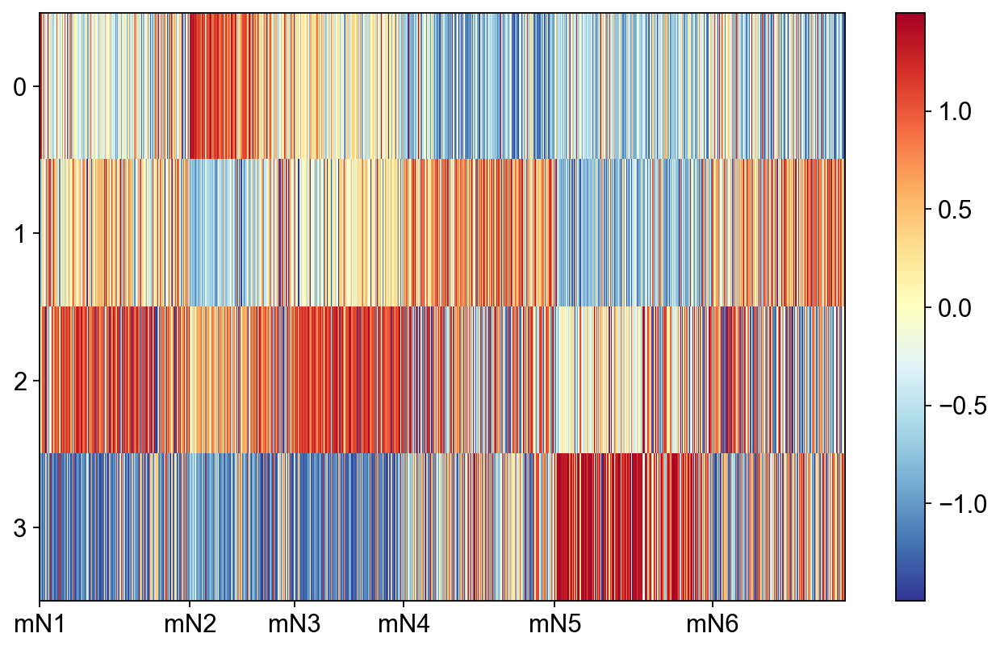

In [181]:
plt.rcParams["figure.figsize"] = (10,6)
tmpdf = meanexp_N.filter(items=list(meanexp_N)[:4]).transpose()
df_norm_col=(tmpdf-tmpdf.mean())/tmpdf.std()

im=plt.imshow(df_norm_col, cmap='RdYlBu_r',aspect='auto',interpolation='none')
#ax=plt.imshow(df_norm_col, cmap='RdYlBu_r',aspect='auto',interpolation='none')
plt.colorbar(im)
plt.grid(False)
#plt.imshow(df_norm_col,aspect='auto',interpolation='none')
#plt.savefig('N_tmp.png')
plt.yticks(np.arange(len(list(meanexp_N)[:4])),list(meanexp_N)[:4])
#ax.set_xticks(xlist)
#ax.set_xticklabels(xlabel)
plt.xticks(xlist,xlabel)

ranking genes


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['Neu_DE_results']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


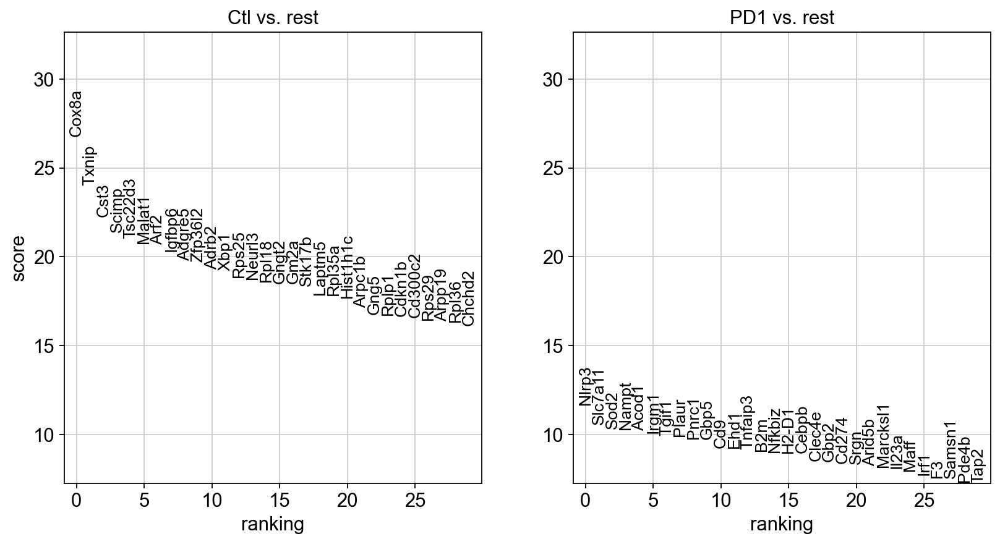

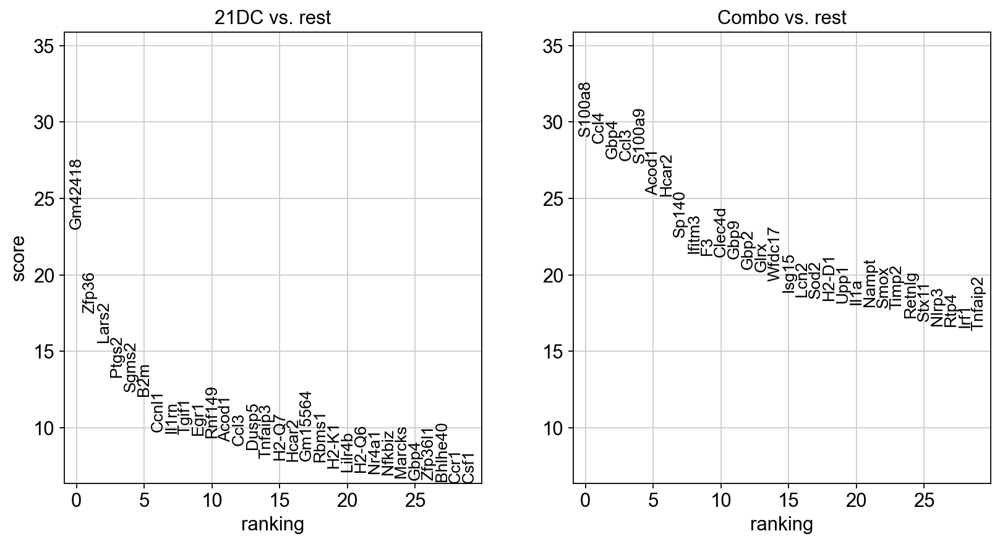

In [182]:
plt.rcParams["figure.figsize"] = (6,6)
sc.tl.rank_genes_groups(Neu, groupby='treat',groups=['Ctl','PD1','21DC','Combo'],key_added='Neu_DE_results',n_genes=1000)

sc.pl.rank_genes_groups(Neu, key='Neu_DE_results', groups=['Ctl','PD1'],fontsize=12,n_genes=30)
sc.pl.rank_genes_groups(Neu, key='Neu_DE_results', groups=['21DC','Combo'],fontsize=12,n_genes=30)


In [191]:
namelist=Neu.uns['Neutrophil_Rankgenes_0.5']['names']
outfile = open('Rank_genes_Neu_Clusters.txt','w')
#outfile.write('\t'.join(['Mono?','Epi','APC?','Treat0','Treat1','Ctl0','Treat2','Ctl1','Treat3','Ctl2','NotSure','Treat4']))
for item in namelist:
    outfile.write('\t'.join(item)+'\n')
outfile.close()

loglist=Neu.uns['Neutrophil_Rankgenes_0.5']['logfoldchanges']
outfile = open('Rank_genes_foldchange_Neu_Clusters.txt','w')
#outfile.write('\t'.join(['Mono?','Epi','APC?','Treat0','Treat1','Ctl0','Treat2','Ctl1','Treat3','Ctl2','NotSure','Treat4']))
for item in loglist:
    outfile.write('\t'.join(map(str,item))+'\n')
outfile.close()

pvals_list=Neu.uns['Neutrophil_Rankgenes_0.5']['pvals_adj']
outfile = open('Rank_genes_pvals_adj_Neu_Clusters.txt','w')
#outfile.write('\t'.join(['Mono?','Epi','APC?','Treat0','Treat1','Ctl0','Treat2','Ctl1','Treat3','Ctl2','NotSure','Treat4']))
for item in loglist:
    outfile.write('\t'.join(map(str,item))+'\n')
outfile.close()

1000 1000 1000
1000 1000 1000


<Figure size 320x320 with 0 Axes>

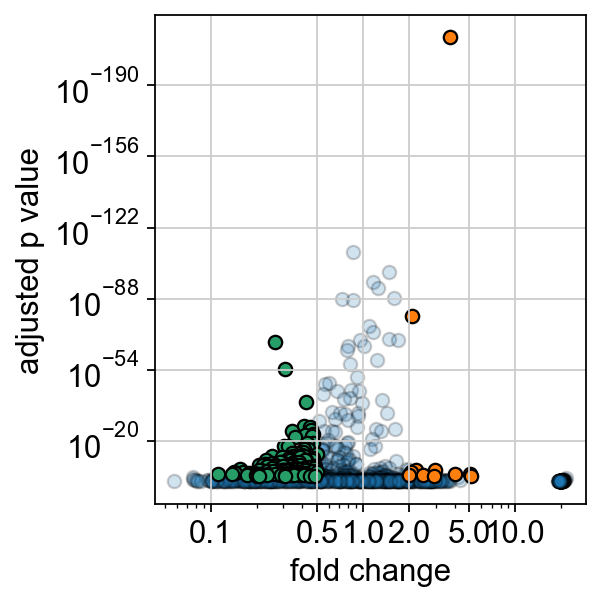

<Figure size 320x320 with 0 Axes>

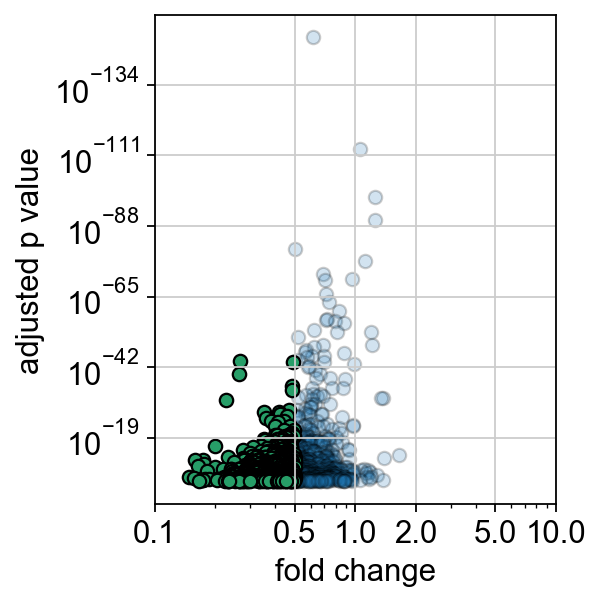

In [628]:
#Did not run this part
for i in range(2):
    plist = []
    flist = []
    nlist = []
    for pvals in padj:
        plist=padj[i].astype(np.float)
    for fvals in fold:
        flist=fold[i].astype(np.float)
    for names in namelist:
        nlist=namelist[i]
    print (len(plist),len(flist),len(nlist))
    pred = [];fred = [];nred = []
    pblue = [];fblue = [];nblue = []
    for pval,fval,name in zip(plist,flist,nlist):
        #print (pval)
       # if (pval<1e-3 and fval>1) or (pval<1e-3 and fval<0.67):
        if (pval<1e-3 and fval>2):
            pred.append(pval)
            fred.append(fval)
            nred.append(name[0])
        if (pval<1e-3 and fval<0.5):
            pblue.append(pval)
            fblue.append(fval)
            nblue.append(name[0])
    plt.figure()
    fig1, ax1 = plt.subplots()
    plt.scatter(flist,plist,edgecolor='black',alpha=0.2)
    plt.scatter(fred,pred,edgecolor='black')
    plt.scatter(fblue,pblue,edgecolor='black')
 #   for i,name in enumerate(nred):
 #       plt.annotate(name,(fred[i],pred[i]),xytext=(fred[i]*1.5,pred[i]/2),
 #                   arrowprops = dict(  arrowstyle="-",
#                      connectionstyle="angle3,angleA=0,angleB=-90"))
    plt.xscale('log')
    plt.yscale('log')
    plt.ylabel('adjusted p value')
    plt.xlabel('fold change')
    plt.xlim= (0.1,10)
    plt.xticks([0.1,0.5,1,2,5,10])
    ax1.get_xaxis().set_major_formatter(matplotlib.ticker.ScalarFormatter())
    plt.gca().invert_yaxis()
    plt.tight_layout()

# MC/Mac/DC -> should be Mo as not all of them are MHCII positive

In [183]:
Mo = adata[adata.obs['louvain_r0.2']== 'MC/Macro/cDC']
sc.tl.leiden(Mo,resolution=0.3,key_added='louvain_r0.5_Mo' )  #0.3 makes most sense

running Leiden clustering


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
Trying to set attribute `.obs` of view, copying.


    finished: found 6 clusters and added
    'louvain_r0.5_Mo', the cluster labels (adata.obs, categorical) (0:00:01)


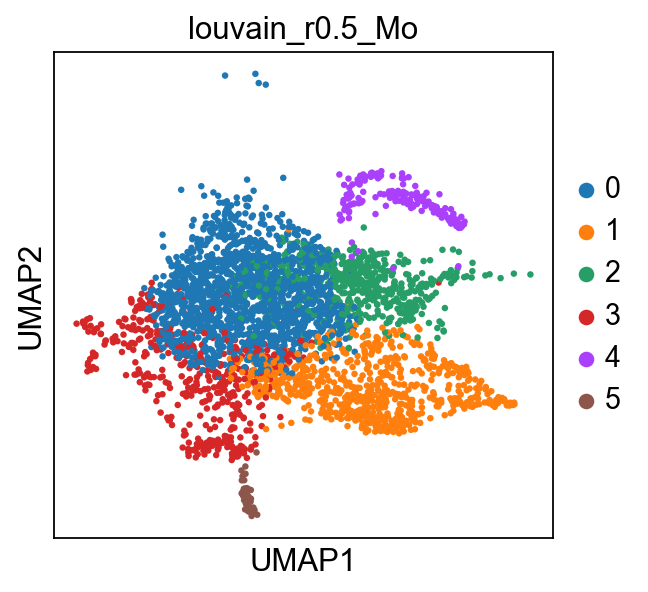

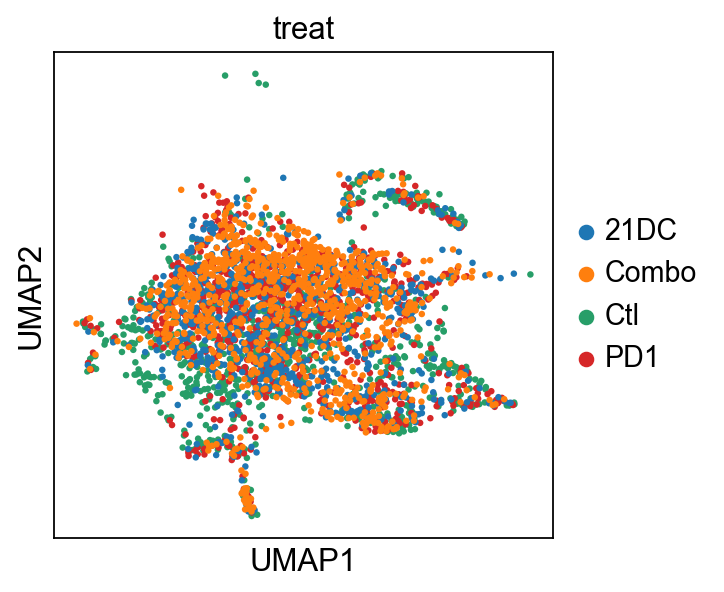

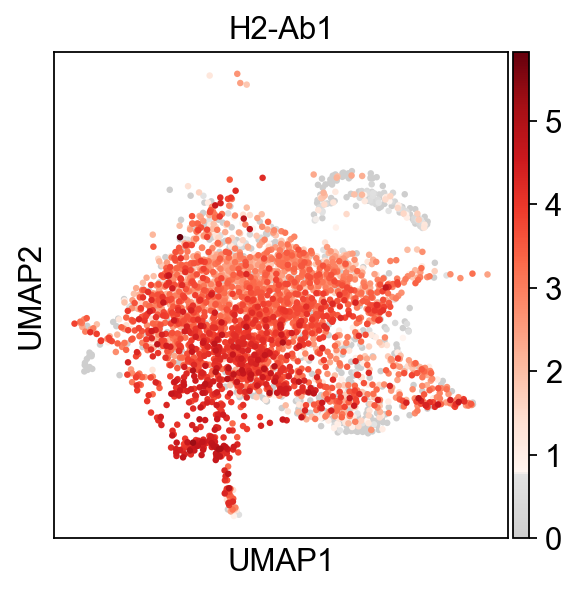

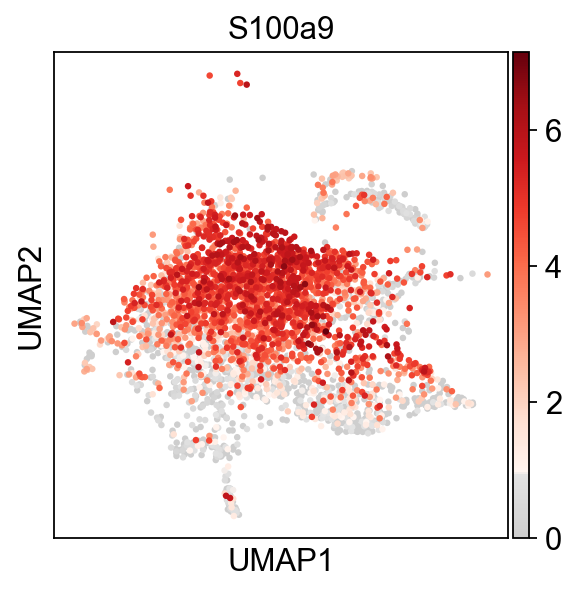

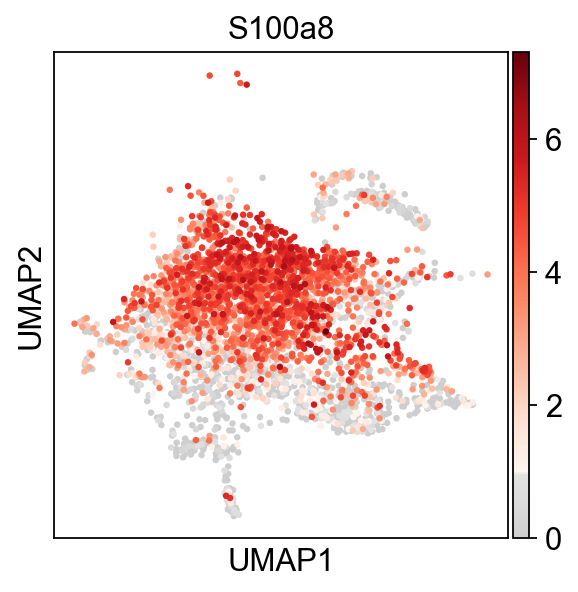

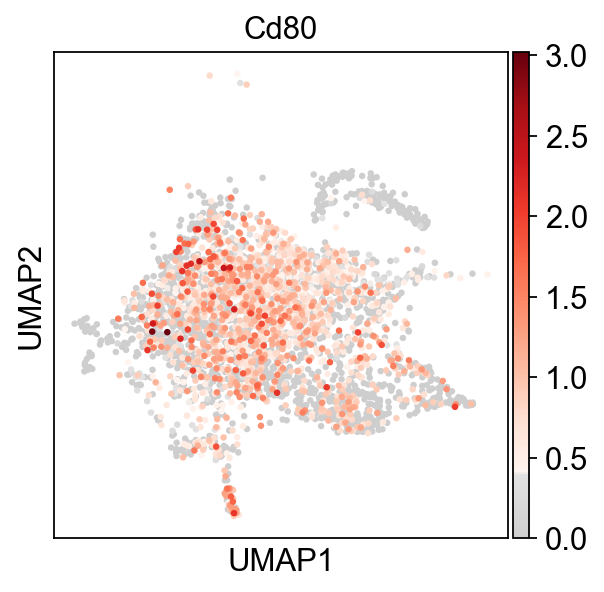

0    1544
1     690
2     557
3     474
4     177
5      54
Name: louvain_r0.5_Mo, dtype: int64

In [184]:
plt.rcParams["figure.figsize"] = (4,4)
sc.pl.umap(Mo, color='louvain_r0.5_Mo', palette=sc.pl.palettes.default_20)
sc.pl.umap(Mo, color='treat')
sc.pl.umap(Mo, color='H2-Ab1', use_raw=True, color_map=mymap)
sc.pl.umap(Mo, color='S100a9', use_raw=True, color_map=mymap) 
sc.pl.umap(Mo, color='S100a8', use_raw=True, color_map=mymap) 
sc.pl.umap(Mo, color='Cd80', use_raw=True, color_map=mymap) 
Mo.obs['louvain_r0.5_Mo'].value_counts()

3    282
0    250
1    188
4     98
2     79
5     16
Name: louvain_r0.5_Mo, dtype: int64
[0.2738225629791895, 0.5028058361391695, 0.46143057503506313, 0.5280898876404494] [0, 0, 0, 0]
[0.2059145673603505, 0.18855218855218855, 0.211781206171108, 0.18692543411644535] [0.2738225629791895, 0.5028058361391695, 0.46143057503506313, 0.5280898876404494]
[0.08652792990142388, 0.17059483726150393, 0.182328190743338, 0.20020429009193055] [0.47973713033954, 0.6913580246913581, 0.6732117812061711, 0.7150153217568948]
[0.3088718510405257, 0.08866442199775533, 0.09817671809256662, 0.043922369765066395] [0.5662650602409639, 0.861952861952862, 0.8555399719495091, 0.9152196118488253]
[0.10733844468784227, 0.03928170594837262, 0.03225806451612903, 0.021450459652706845] [0.8751369112814896, 0.9506172839506174, 0.9537166900420757, 0.9591419816138916]
[0.017524644030668127, 0.010101010101010102, 0.014025245441795231, 0.01940755873340143] [0.9824753559693319, 0.9898989898989901, 0.9859747545582047, 0.980592

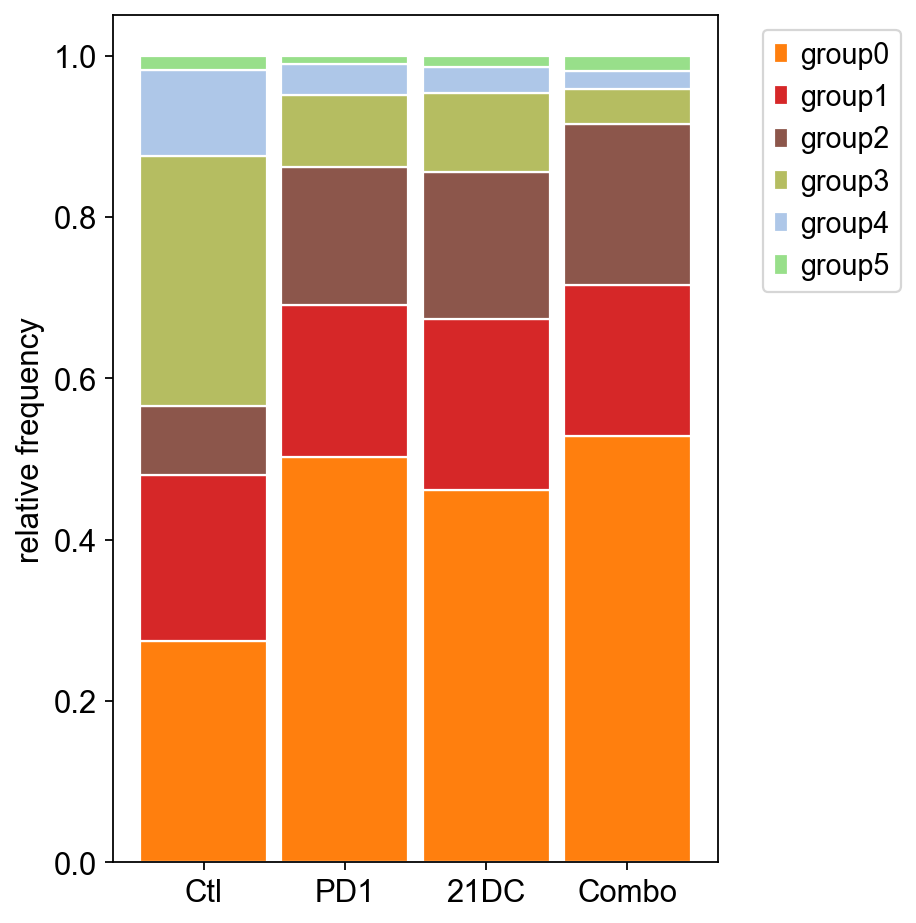

In [187]:
ctlcount = Mo[Mo.obs['treat']=='Ctl'].obs['louvain_r0.5_Mo'].value_counts()
pd1count = Mo[Mo.obs['treat']=='PD1'].obs['louvain_r0.5_Mo'].value_counts()
dccount = Mo[Mo.obs['treat']=='21DC'].obs['louvain_r0.5_Mo'].value_counts()
combocount = Mo[Mo.obs['treat']=='Combo'].obs['louvain_r0.5_Mo'].value_counts()
print (ctlcount)

plt.rcParams["figure.figsize"] = (6,6)
r=[0,1,2,3]
bottom = [0,0,0,0]
ctlfreq = {}
pd1freq = {}
dcfreq = {}
combofreq = {}
for i in range(len(ctlcount)):
    ctlfreq[ctlcount.index[i]] = ctlcount[i]/sum(ctlcount)
    pd1freq[pd1count.index[i]] = pd1count[i]/sum(pd1count)
    dcfreq[dccount.index[i]] = dccount[i]/sum(dccount)
    combofreq[combocount.index[i]] = combocount[i]/sum(combocount)
    
handlelist = []

for i in range(len(ctlcount)):
    height = [ctlfreq[str(i)],pd1freq[str(i)],dcfreq[str(i)],combofreq[str(i)]]
    print (height,bottom)
    plt.bar(r,height,bottom=bottom)
    ax = plt.bar(r,height,bottom=bottom,edgecolor='white',width=0.9,label='group'+str(i))
#    ax = plt.bar(r,height,bottom=bottom,label='group'+str(i))
    handlelist.append(ax)
    bottom[0] += height[0]
    bottom[1] += height[1]
    bottom[2] += height[2]
    bottom[3] += height[3]
plt.xticks(r,['Ctl','PD1','21DC','Combo'])
plt.grid(False)
plt.ylabel('relative frequency')
plt.legend(handles=handlelist, bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()


ranking genes
    finished: added to `.uns['Mo_Rankgenes']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


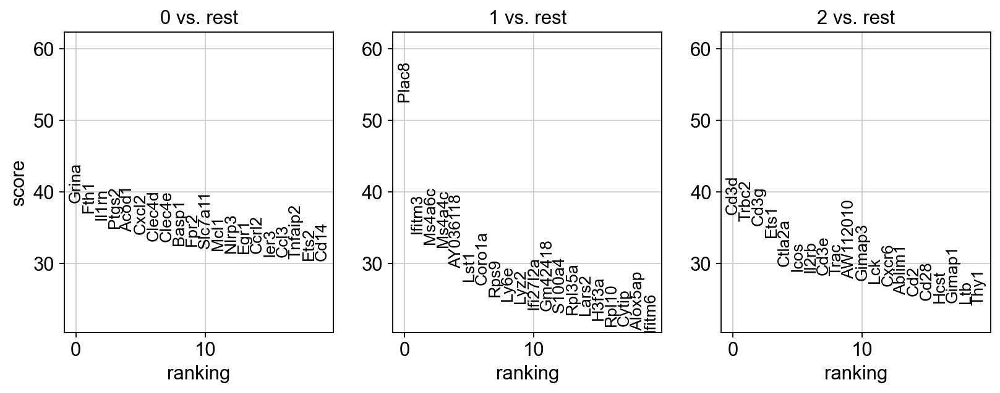

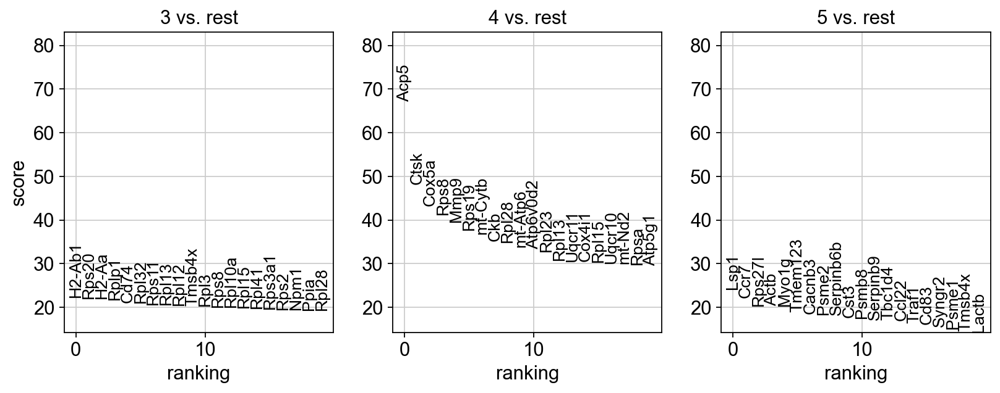

In [188]:
plt.rcParams["figure.figsize"] = (4,4)
sc.tl.rank_genes_groups(Mo, groupby='louvain_r0.5_Mo',key_added='Mo_Rankgenes')
#sc.pl.rank_genes_groups(Mo, key='Mo_Rankgenes', groups=['0','1','2','3','4','5'], fontsize=12)
sc.pl.rank_genes_groups(Mo, key='Mo_Rankgenes', groups=['0','1','2'], fontsize=12)
sc.pl.rank_genes_groups(Mo, key='Mo_Rankgenes', groups=['3','4','5'], fontsize=12)

['Cd86', 'Cd80', 'Cd68', 'Il1r1', 'Tlr2', 'Tlr4', 'Nos2', 'Socs3', 'Cd163', 'Chil3', 'Arg1', 'Egr2', 'Cd200r1', 'Mrc1', 'Tgm2', 'Tlr1', 'Tlr8', 'Btla', 'Ccr7', 'Dpp4', 'Kit', 'Flt3', 'Xcr1', 'Ifi205', 'Hepacam2', 'Cd36', 'Tlr3', 'Eno2', 'Ankrd33b', 'Extl1', 'Fah', 'Cd81', 'Gcsam', 'Xcr1', 'Irf8', 'Sirpa', 'S100a4', 'Cd209a']


<AxesSubplot:>

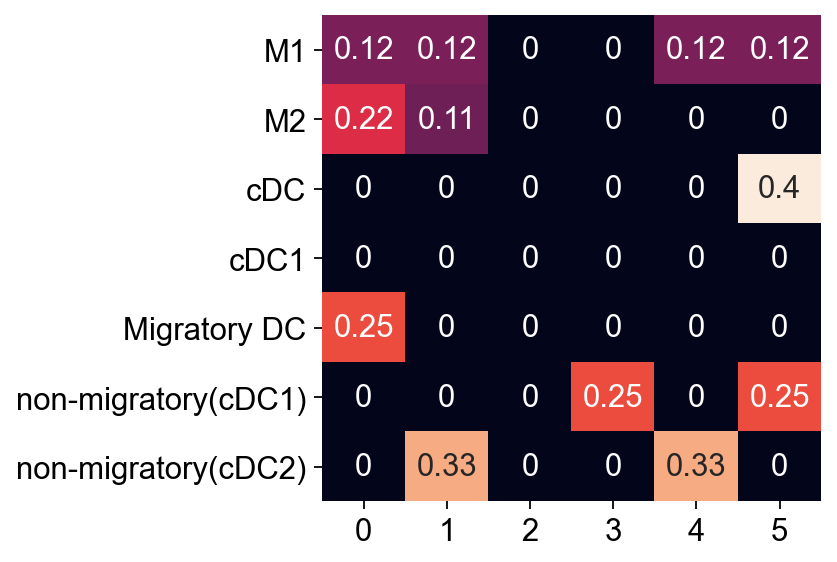

In [189]:
plt.rcParams["figure.figsize"] = (4,4)
reffile = '../ref_gene_M.txt'
refdict = {}
ref_genes = pd.read_table(reffile, delimiter='\t')
for celltype in ref_genes:
    genelist = ref_genes[celltype].dropna()
    refdict[celltype] = [gene for gene in genelist]
marker_genes_M = refdict
marker_genes_M
marker_genes_M_list=[]
for key in marker_genes_M:
    marker_genes_M_list.extend(marker_genes_M[key])
#marker_genes_M_list=list(dict.fromkeys(marker_genes_M_list))
print((marker_genes_M_list))
    
cell_annotation_M = sc.tl.marker_gene_overlap(Mo, marker_genes_M, key='Mo_Rankgenes',top_n_markers=200)
cell_annotation_norm = sc.tl.marker_gene_overlap(Mo, marker_genes_M, key='Mo_Rankgenes', normalize='reference',top_n_markers=200)
#cell_annotation_all = sc.tl.marker_gene_overlap(adata, marker_genes_M, key='Mo_Rankgenes')
#cell_annotation_M
sb.heatmap(cell_annotation_norm, cbar=False, annot=True)
#sb.heatmap(cell_annotation_all, cbar=False, annot=True)

<AxesSubplot:>

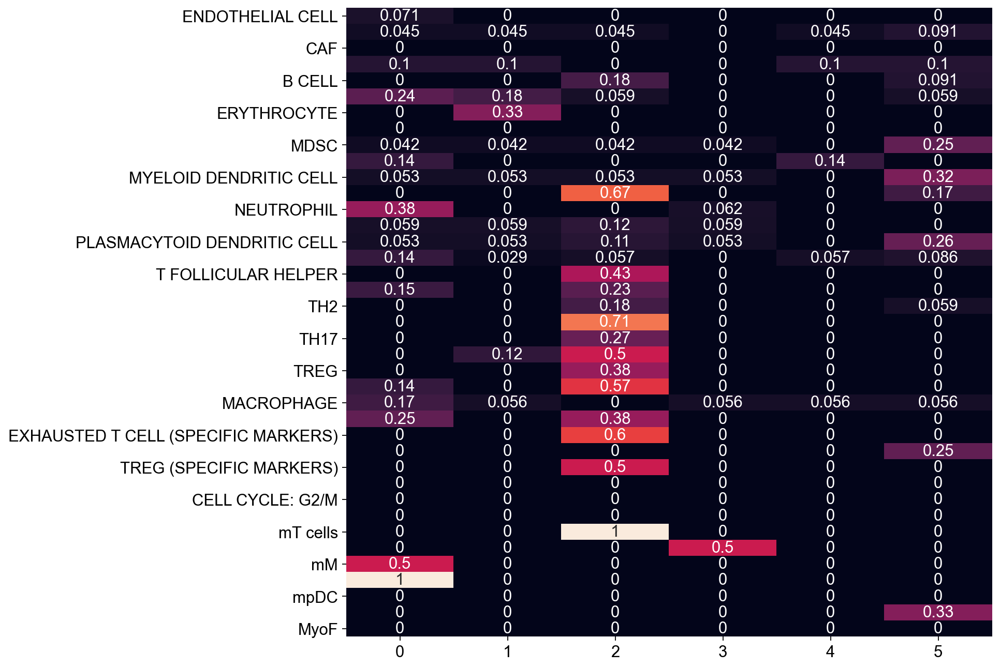

In [190]:
plt.rcParams["figure.figsize"] = (10,10)
cell_annotation_norm = sc.tl.marker_gene_overlap(Mo, marker_genes, key='Mo_Rankgenes', normalize='reference',top_n_markers=200)
cell_annotation_norm_Zhang = sc.tl.marker_gene_overlap(Mo, marker_genes_Zhang, key='Mo_Rankgenes', normalize='reference',top_n_markers=200)
sb.heatmap(cell_annotation_norm, cbar=False, annot=True)
#sb.heatmap(cell_annotation_norm_Zhang, cbar=False, annot=True)

In [331]:
namelist=Mo.uns['Mo_Rankgenes']['names']
outfile = open('Rank_genes_MC_Clusters.txt','w')
#outfile.write('\t'.join(['Mono?','Epi','APC?','Treat0','Treat1','Ctl0','Treat2','Ctl1','Treat3','Ctl2','NotSure','Treat4']))
for item in namelist:
    outfile.write('\t'.join(item)+'\n')
outfile.close()

loglist=Mo.uns['Mo_Rankgenes']['logfoldchanges']
outfile = open('Rank_genes_foldchange_MC_Clusters.txt','w')
#outfile.write('\t'.join(['Mono?','Epi','APC?','Treat0','Treat1','Ctl0','Treat2','Ctl1','Treat3','Ctl2','NotSure','Treat4']))
for item in loglist:
    outfile.write('\t'.join(map(str,item))+'\n')
outfile.close()

pvals_list=Mo.uns['Mo_Rankgenes']['pvals_adj']
outfile = open('Rank_genes_pvals_adj_MC_Clusters.txt','w')
#outfile.write('\t'.join(['Mono?','Epi','APC?','Treat0','Treat1','Ctl0','Treat2','Ctl1','Treat3','Ctl2','NotSure','Treat4']))
for item in loglist:
    outfile.write('\t'.join(map(str,item))+'\n')
outfile.close()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns["dendrogram_['louvain_r0.5_Mo']"]`


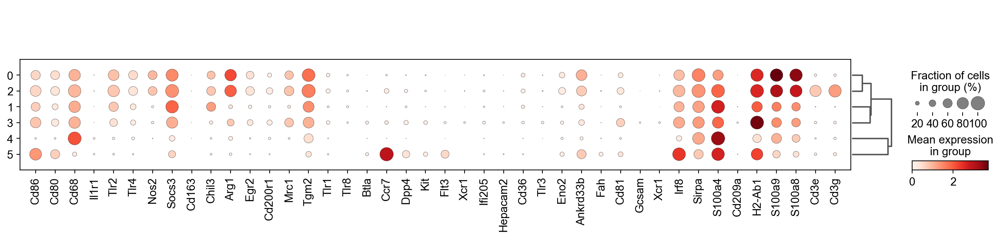

In [191]:
marker_genes_M_list
marker_genes_M_list.remove('Extl1')
marker_genes_M_list.extend(['H2-Ab1','S100a9','S100a8','Cd3e','Cd3g'])
sc.pl.dotplot(Mo, marker_genes_M_list, groupby='louvain_r0.5_Mo', dendrogram=True)

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


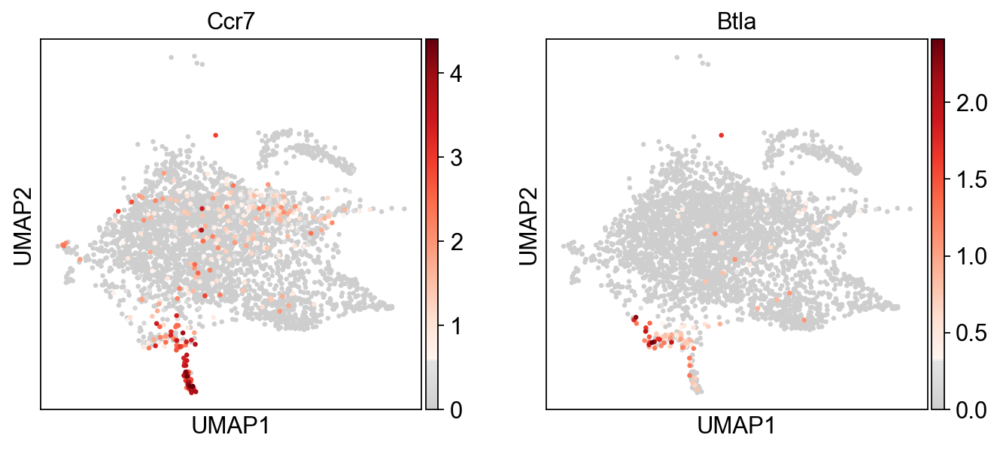

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


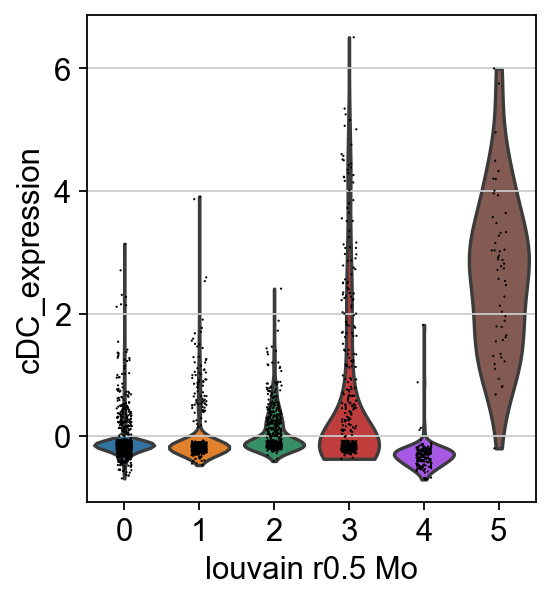

Index(['Dpp4', 'Kit', 'Flt3', 'Ccr7', 'Btla'], dtype='object')

In [192]:
#Check individual cDC markers
plt.rcParams["figure.figsize"] = (4,4)
stem_genes = Mo.var_names[np.in1d(Mo.var_names, marker_genes_M['cDC'])] 
sc.pl.umap(Mo, color=stem_genes[3:], title=stem_genes[3:], color_map=mymap)

#Check stem marker expression
Mo.obs['cDC_expression'] = Mo[:,stem_genes].X.mean(1)

sc.pl.violin(Mo, 'cDC_expression', groupby='louvain_r0.5_Mo')
#sc.pl.umap(Mo, color='cDC_expression', color_map=mymap)
stem_genes = Mo.var_names[np.in1d(Mo.var_names, marker_genes_M['cDC'])] 
stem_genes

# Notes


Group5 is cDC, others need more work.
We can dig into it. 

I seperated cDC and did differential gene expression. If you want, we can try further cluster it. But it only has 54 cells.

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


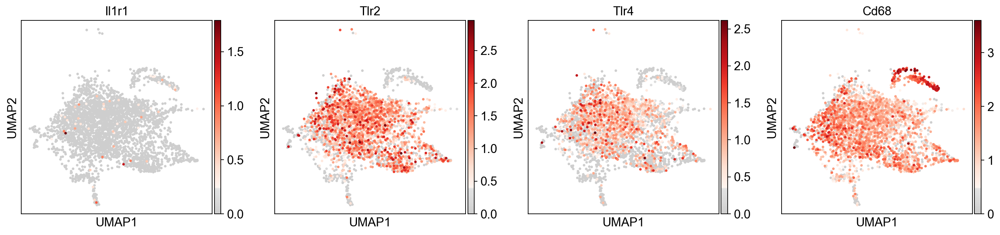

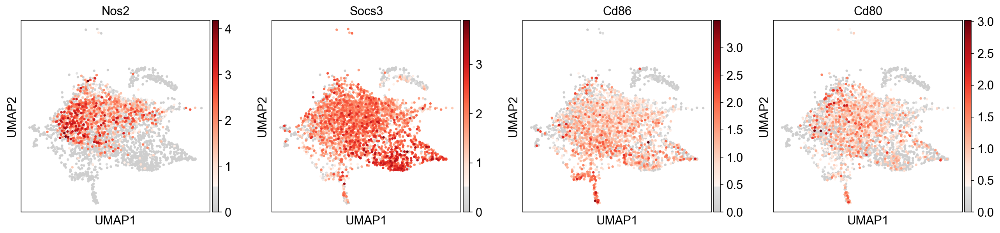

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


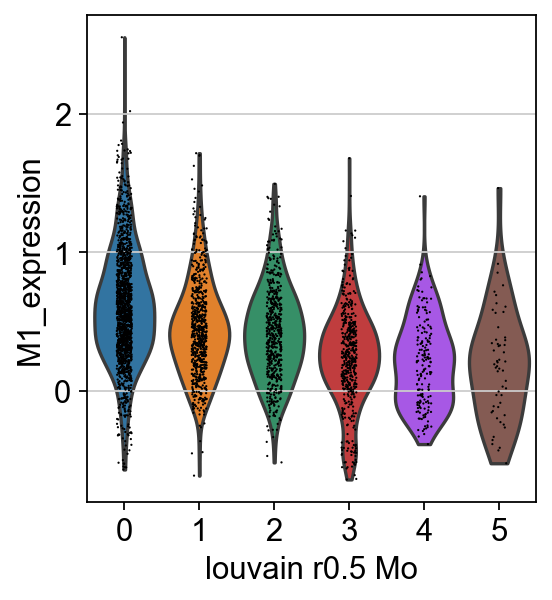

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


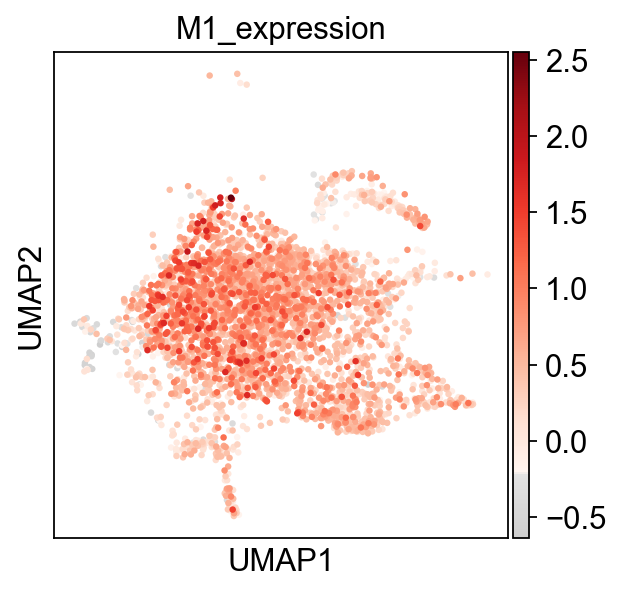

In [193]:
#Check individual M1 markers
stem_genes = Mo.var_names[np.in1d(Mo.var_names, marker_genes_M['M1'])]
sc.pl.umap(Mo, color=stem_genes[:4], title=stem_genes[:4], color_map=mymap)
sc.pl.umap(Mo, color=stem_genes[4:], title=stem_genes[4:], color_map=mymap)

#Check stem marker expression
Mo.obs['M1_expression'] = Mo[:,stem_genes].X.mean(1)

sc.pl.violin(Mo, 'M1_expression', groupby='louvain_r0.5_Mo')
sc.pl.umap(Mo, color='M1_expression', color_map=mymap)


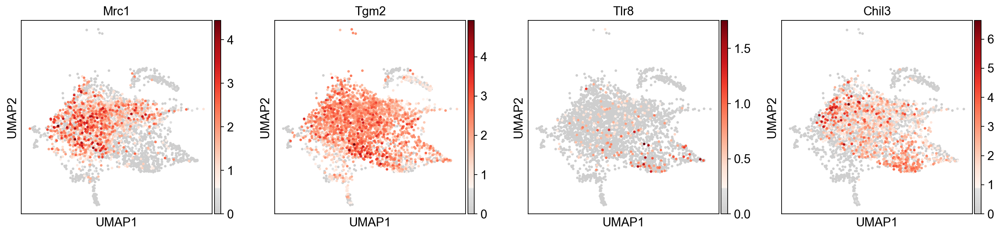

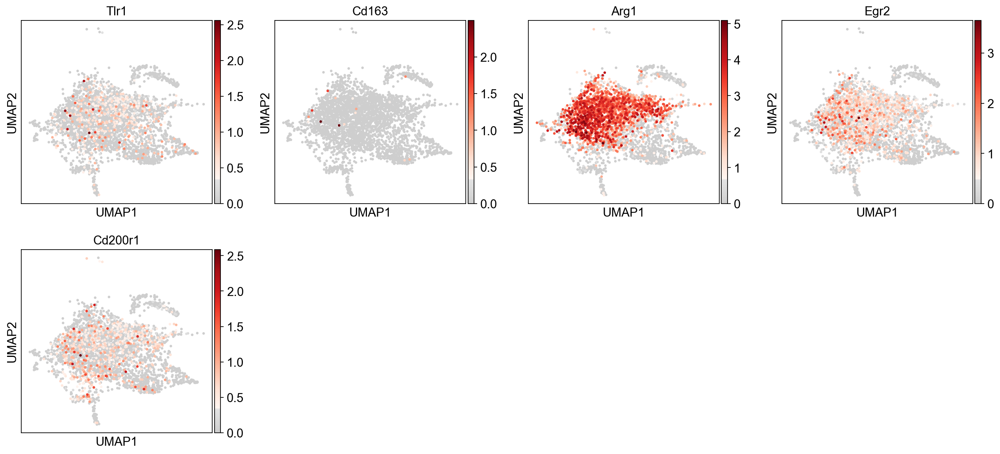

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


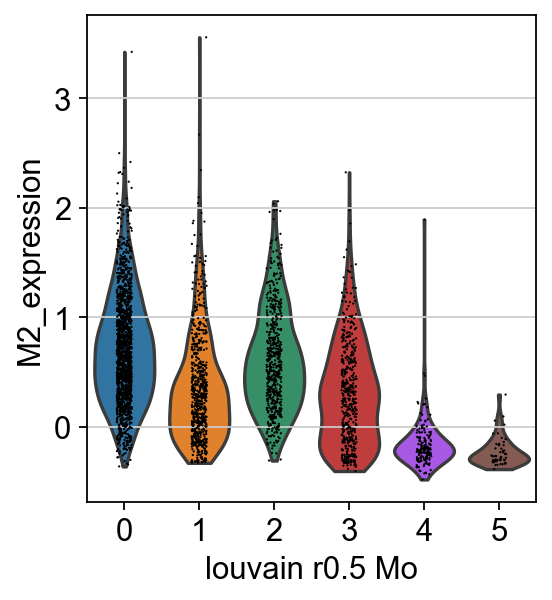

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


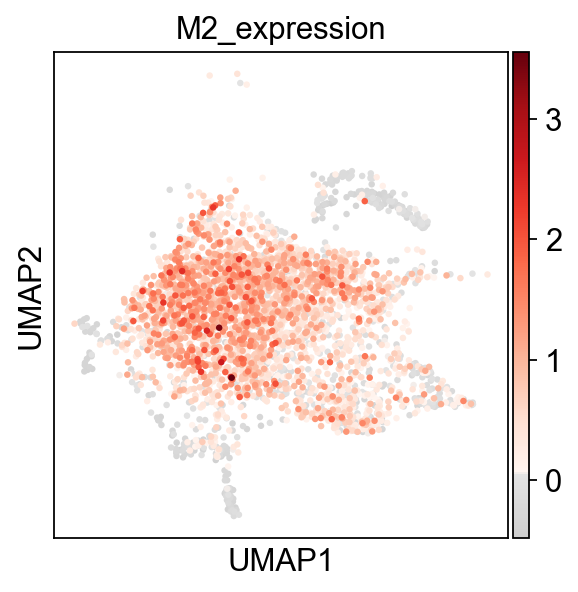

In [194]:
#Check individual M2 markers
stem_genes = Mo.var_names[np.in1d(Mo.var_names, marker_genes_M['M2'])]
sc.pl.umap(Mo, color=stem_genes[:4], title=stem_genes[:4], color_map=mymap)
sc.pl.umap(Mo, color=stem_genes[4:], title=stem_genes[4:], color_map=mymap)

#Check stem marker expression
Mo.obs['M2_expression'] = Mo[:,stem_genes].X.mean(1)

sc.pl.violin(Mo, 'M2_expression', groupby='louvain_r0.5_Mo')
sc.pl.umap(Mo, color='M2_expression', color_map=mymap)

https://els-jbs-prod-cdn.jbs.elsevierhealth.com/cms/attachment/d1537bbb-cb71-4b58-8fd6-ef176f978b47/gr5.jpg![image.png](attachment:image.png)

<AxesSubplot:>

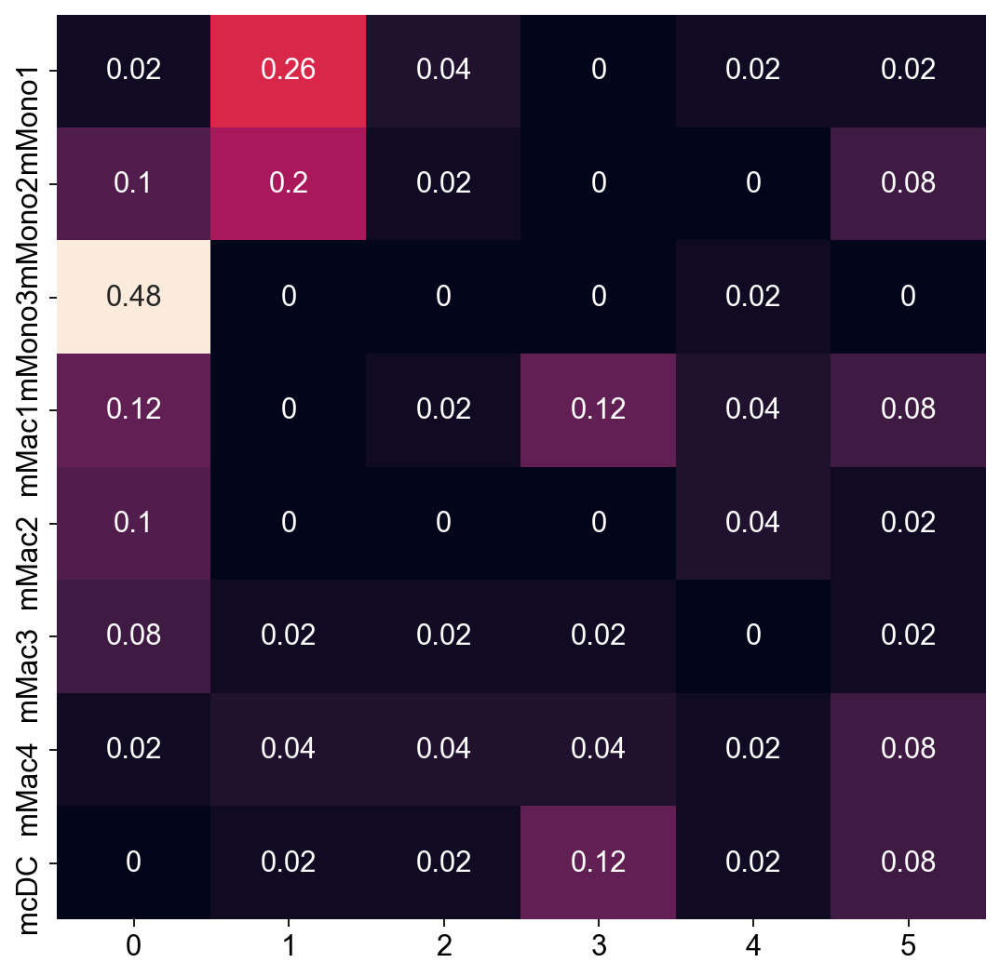

In [195]:
reffile = '../ref_gene_M_Immunity'
refdict = {}
ref_genes = pd.read_table(reffile, delimiter='\t')
for celltype in ref_genes:
    genelist = ref_genes[celltype].dropna()
    refdict[celltype] = [gene.lower().capitalize() for gene in genelist]
marker_genes_M_immunity = refdict

#cell_annotation = sc.tl.marker_gene_overlap(adata, marker_genes, key='rank_genes_r0.2',top_n_markers=200)
#cell_annotation = sc.tl.marker_gene_overlap(Neu,marker_genes_N, key='Neutrophil_Rankgenes',method='overlap_coef',top_n_markers=200)
plt.rcParams["figure.figsize"] = (8,8)
cell_annotation_norm = sc.tl.marker_gene_overlap(Mo, marker_genes_M_immunity, key='Mo_Rankgenes', normalize='reference',top_n_markers=200)
#cell_annotation_norm_Zhang = sc.tl.marker_gene_overlap(adata, marker_genes_Zhang, key='rank_genes_r0.2', normalize='reference',top_n_markers=200)
sb.heatmap(cell_annotation_norm, cbar=False, annot=True)

In [196]:
meanexp_N,marker_genes_filter = marker_gene_expression_dict(Mo,marker_genes_M_immunity,'louvain_r0.5_Mo')

x=[len(marker_genes_filter[x]) for x in marker_genes_filter.keys()]
xlist=[sum(x[0:i[0]]) for i in enumerate(x)]
xlabel=list(marker_genes_filter.keys())
xlabel
xlist

357


[0, 47, 93, 141, 183, 220, 267, 315]

([<matplotlib.axis.XTick at 0x7fc4a76b1ca0>,
 [Text(0, 0, 'mMono1'),
  Text(47, 0, 'mMono2'),
  Text(93, 0, 'mMono3'),
  Text(141, 0, 'mMac1'),
  Text(183, 0, 'mMac2'),
  Text(220, 0, 'mMac3'),
  Text(267, 0, 'mMac4'),
  Text(315, 0, 'mcDC')])

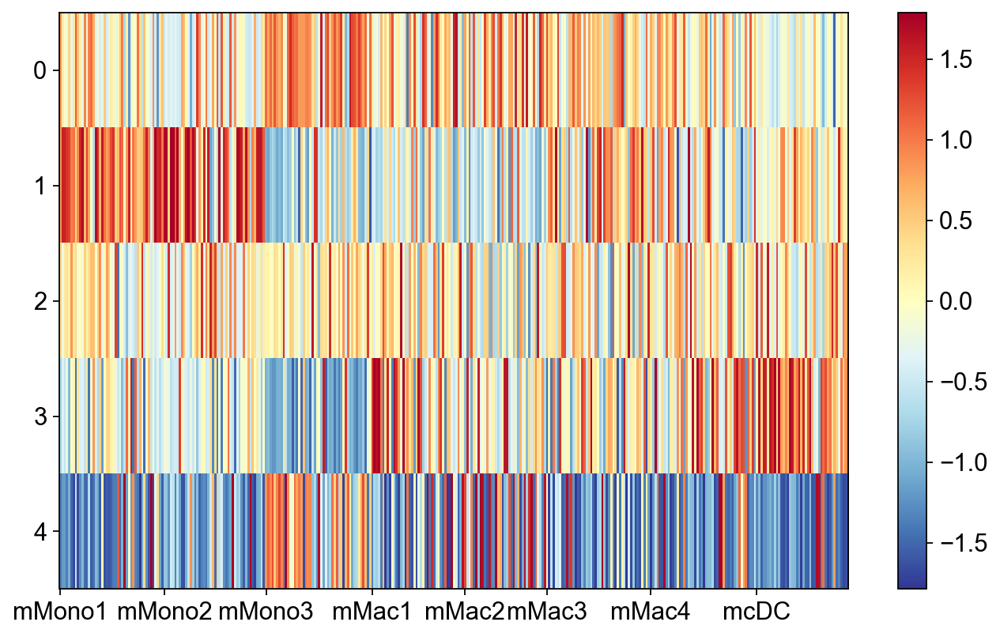

In [201]:
#meanexp_N[0:5]
tmpdf = meanexp_N.filter(items=list(meanexp_N)[:5]).transpose()
tmpdf

plt.rcParams["figure.figsize"] = (10,6)
tmpdf = meanexp_N.filter(items=list(meanexp_N)[:5]).transpose()
df_norm_col=(tmpdf-tmpdf.mean())/tmpdf.std()
im=plt.imshow(df_norm_col, cmap='RdYlBu_r',aspect='auto',interpolation='none')
plt.imshow(df_norm_col, cmap='RdYlBu_r',aspect='auto',interpolation='none')
plt.colorbar(im)
plt.grid(False)
#plt.imshow(df_norm_col,aspect='auto',interpolation='none')
#plt.savefig('N_tmp.png')
#plt.yticks(np.arange(len(list(meanexp_N)[:6])),list(meanexp_N)[:6])
plt.xticks(xlist,xlabel)

In [202]:
cDC=Mo[Mo.obs['louvain_r0.5_Mo']=='5']

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


ranking genes
    finished: added to `.uns['cDC_DE_results']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


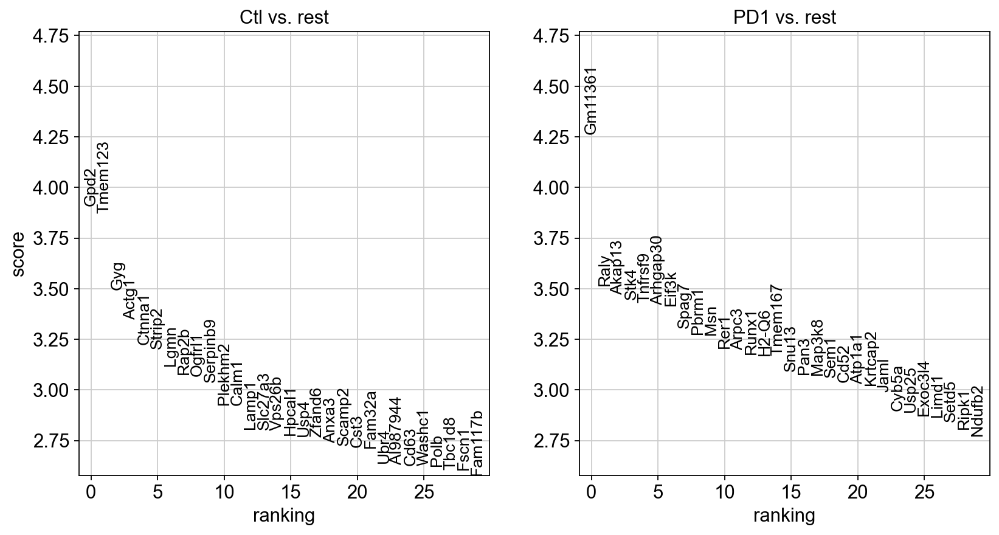

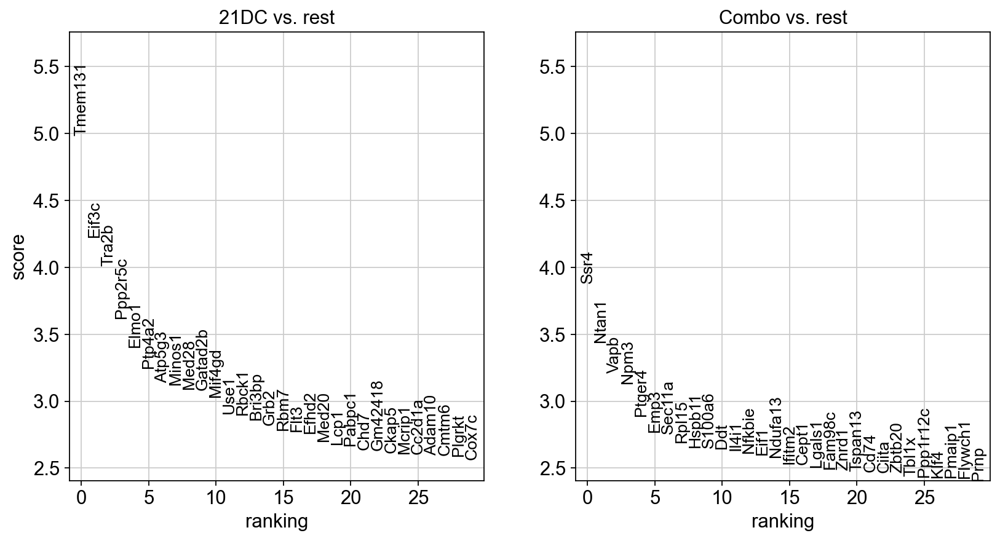

In [204]:
plt.rcParams["figure.figsize"] = (6,6)
sc.tl.rank_genes_groups(cDC, groupby='treat',groups=['Ctl','PD1','21DC','Combo'],key_added='cDC_DE_results',n_genes=1000)

sc.pl.rank_genes_groups(cDC, key='cDC_DE_results', groups=['Ctl','PD1'],fontsize=12,n_genes=30)
sc.pl.rank_genes_groups(cDC, key='cDC_DE_results', groups=['21DC','Combo'],fontsize=12,n_genes=30)


In [361]:

namelist=cDC.uns['cDC_DE_results']['names']
fold = cDC.uns['cDC_DE_results']['logfoldchanges']
padj = cDC.uns['cDC_DE_results']['pvals_adj']
outfile = open('cDC_DE_results','w')
#print (namelist)
for i,item in enumerate(namelist):
    outfile.write(item[0]+'\t'+str(fold[i][0])+'\t'+str(padj[i][0])+'\n')
    #outfile.write(item[0]+'\t'+str(padj[i][0])+'\n')
    #outfile.write(item[1]+'\t'+str(padj[i][1])+'\n')
outfile.close()

#sc.pl.rank_genes_groups(M, key='M_DE_results', groups=['Combo','Ctl'], fontsize=12)
#sc.pl.rank_genes_groups_heatmap(M, key='M_DE_results', groups=['Combo','Ctl'],n_genes=15,show_gene_labels=True, cmap='RdYlBu_r')
#sc.pl.rank_genes_groups(M, key='M_DE_results', groups=['Ctl'], fontsize=12)
#sc.pl.rank_genes_groups_heatmap(M, key='M_DE_results', groups=['Combo'],n_genes=15,show_gene_labels=True, cmap='RdYlBu_r')

# T cells

running Leiden clustering


Trying to set attribute `.obs` of view, copying.


    finished: found 10 clusters and added
    'louvain_r0.5_T', the cluster labels (adata.obs, categorical) (0:00:01)


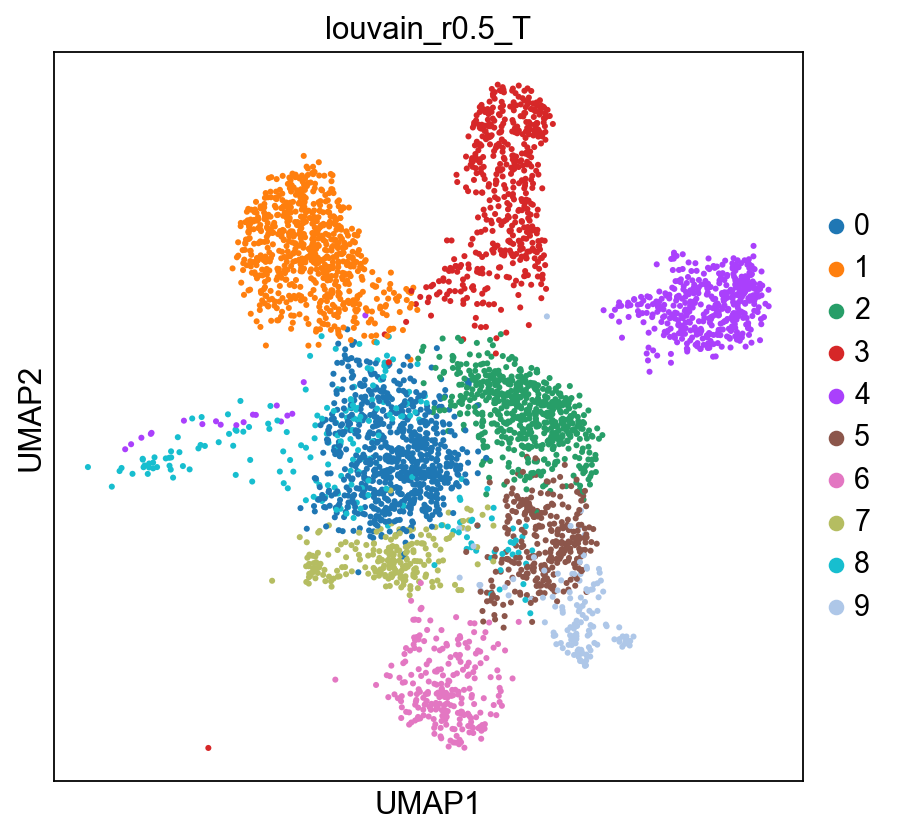

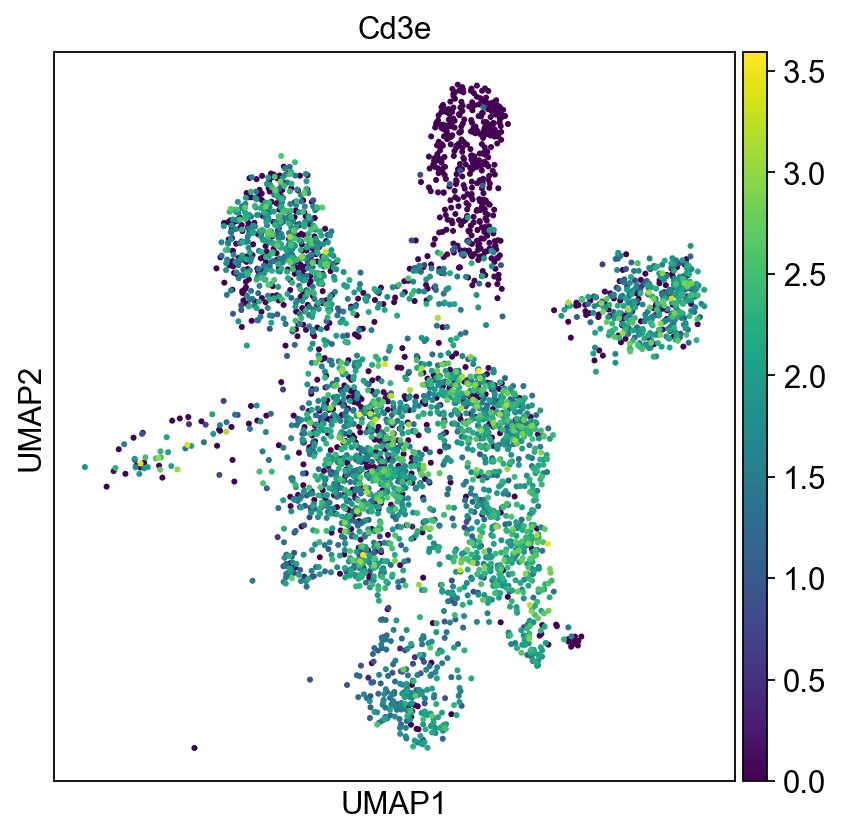

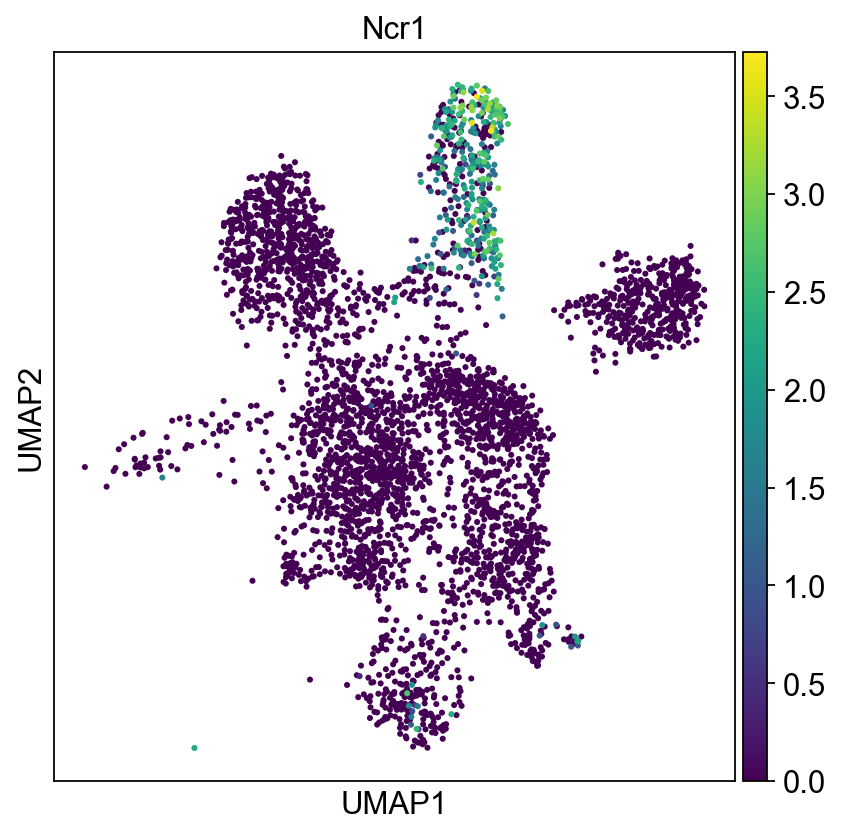

In [211]:
Tdata = adata[adata.obs['louvain_r0.2']== 'T cells/NK cells']
sc.tl.leiden(Tdata,resolution=0.9,key_added='louvain_r0.5_T' )
sc.pl.umap(Tdata, color='louvain_r0.5_T', palette=sc.pl.palettes.default_20)
sc.pl.umap(Tdata, color='Cd3e', palette=sc.pl.palettes.default_20)
sc.pl.umap(Tdata, color='Ncr1', palette=sc.pl.palettes.default_20)

#Cluster3 is NK cells

In [212]:
Tdata=Tdata[Tdata.obs['louvain_r0.5_T']!='3']  #Not looking at NK cells for now

In [216]:
sc.tl.leiden(Tdata,resolution=1,key_added='louvain_r0.5_T' )

running Leiden clustering
    finished: found 11 clusters and added
    'louvain_r0.5_T', the cluster labels (adata.obs, categorical) (0:00:00)


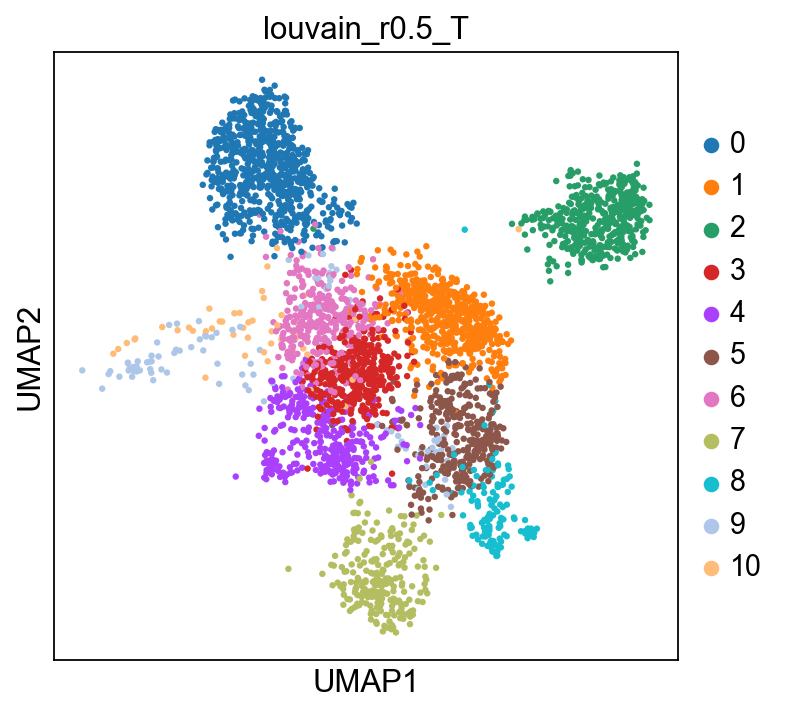

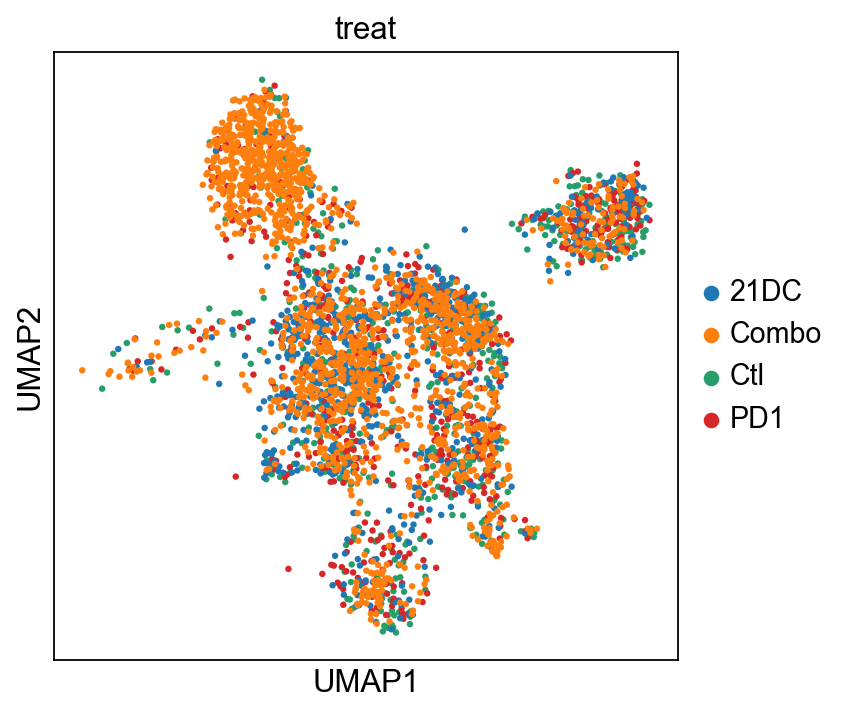

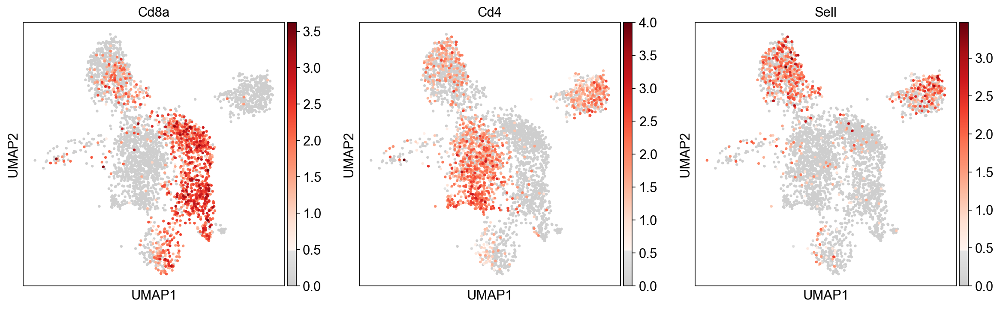

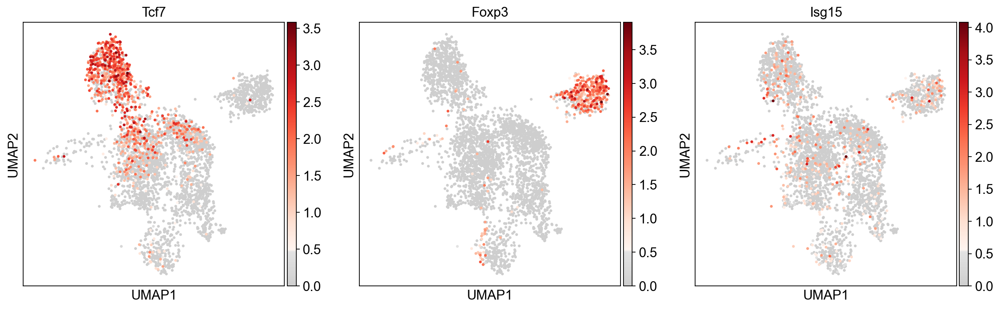

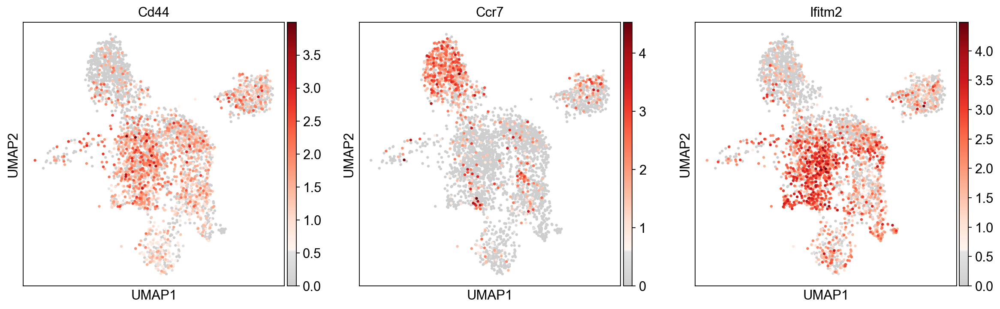

In [217]:
plt.rcParams["figure.figsize"] = (5,5)
sc.pl.umap(Tdata, color='louvain_r0.5_T', palette=sc.pl.palettes.default_20)
sc.pl.umap(Tdata, color='treat')
#sc.pl.umap(Tdata[Tdata.obs['treat']=='Ctl'], color='louvain_r0.5_T', palette=sc.pl.palettes.default_20)
#sc.pl.umap(Tdata[Tdata.obs['treat']=='Combo'], color='louvain_r0.5_T', palette=sc.pl.palettes.default_20)
sc.pl.umap(Tdata, color=['Cd8a','Cd4','Sell'], use_raw=True, color_map=mymap) 
#sc.pl.umap(Tdata, color='Cd4', use_raw=True, color_map=mymap) 
#sc.pl.umap(Tdata, color='Sell', use_raw=True, color_map=mymap) 
sc.pl.umap(Tdata, color=['Tcf7','Foxp3','Isg15'], use_raw=True, color_map=mymap) 
sc.pl.umap(Tdata, color=['Cd44','Ccr7','Ifitm2'], use_raw=True, color_map=mymap) 
#sc.pl.umap(Tdata, color='Ccr7', use_raw=True, color_map=mymap) 


2     139
1     101
5      86
4      66
7      62
3      49
0      46
6      40
8      29
9      19
10     18
Name: louvain_r0.5_T, dtype: int64
[0.07022900763358779, 0.10815047021943573, 0.02923076923076923, 0.34925558312655086] [0, 0, 0, 0]
[0.15419847328244274, 0.14576802507836992, 0.17846153846153845, 0.13895781637717122] [0.07022900763358779, 0.10815047021943573, 0.02923076923076923, 0.34925558312655086]
[0.21221374045801528, 0.18181818181818182, 0.11692307692307692, 0.062034739454094295] [0.22442748091603054, 0.25391849529780564, 0.20769230769230768, 0.4882133995037221]
[0.07480916030534351, 0.07993730407523511, 0.15692307692307692, 0.11104218362282878] [0.4366412213740458, 0.43573667711598746, 0.3246153846153846, 0.5502481389578164]
[0.10076335877862595, 0.10658307210031348, 0.12461538461538461, 0.07258064516129033] [0.5114503816793894, 0.5156739811912225, 0.48153846153846147, 0.6612903225806452]
[0.13129770992366413, 0.11128526645768025, 0.07692307692307693, 0.07692307692307693

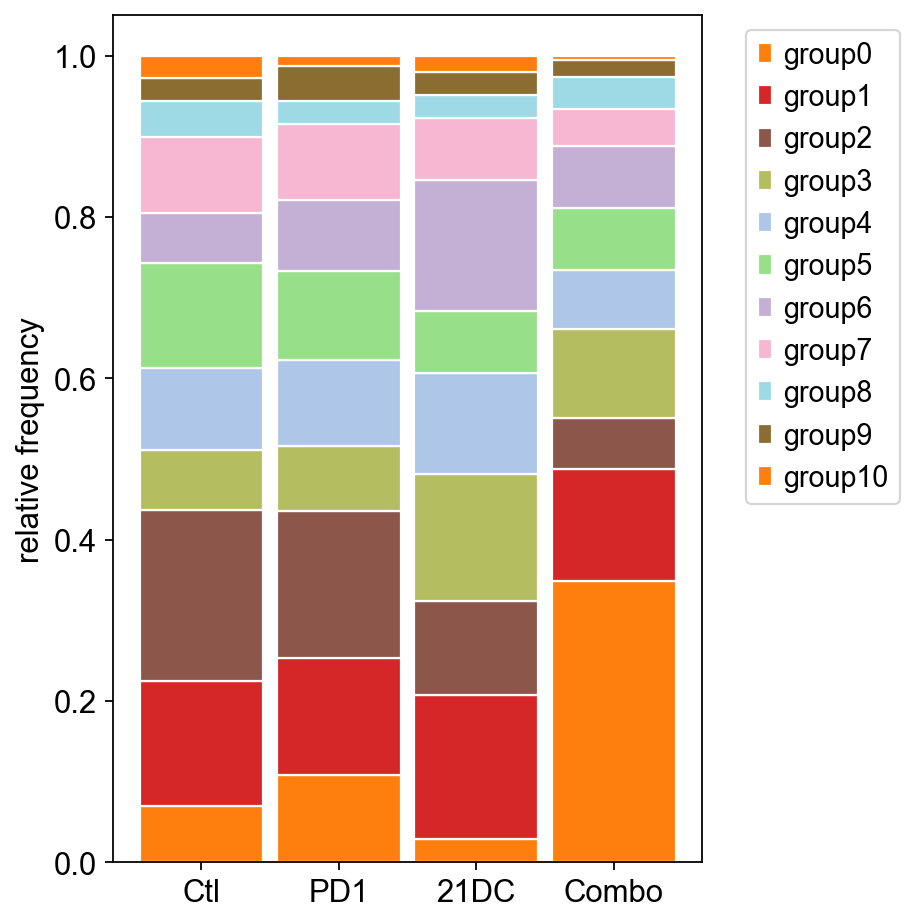

In [219]:
ctlcount = Tdata[Tdata.obs['treat']=='Ctl'].obs['louvain_r0.5_T'].value_counts()
pd1count = Tdata[Tdata.obs['treat']=='PD1'].obs['louvain_r0.5_T'].value_counts()
dccount = Tdata[Tdata.obs['treat']=='21DC'].obs['louvain_r0.5_T'].value_counts()
combocount = Tdata[Tdata.obs['treat']=='Combo'].obs['louvain_r0.5_T'].value_counts()
print (ctlcount)

plt.rcParams["figure.figsize"] = (6,6)
r=[0,1,2,3]
bottom = [0,0,0,0]
ctlfreq = {}
pd1freq = {}
dcfreq = {}
combofreq = {}
for i in range(len(ctlcount)):
    ctlfreq[ctlcount.index[i]] = ctlcount[i]/sum(ctlcount)
    pd1freq[pd1count.index[i]] = pd1count[i]/sum(pd1count)
    dcfreq[dccount.index[i]] = dccount[i]/sum(dccount)
    combofreq[combocount.index[i]] = combocount[i]/sum(combocount)
    
handlelist = []

for i in range(len(ctlcount)):
    height = [ctlfreq[str(i)],pd1freq[str(i)],dcfreq[str(i)],combofreq[str(i)]]
    print (height,bottom)
    plt.bar(r,height,bottom=bottom)
    ax = plt.bar(r,height,bottom=bottom,edgecolor='white',width=0.9,label='group'+str(i))
#    ax = plt.bar(r,height,bottom=bottom,label='group'+str(i))
    handlelist.append(ax)
    bottom[0] += height[0]
    bottom[1] += height[1]
    bottom[2] += height[2]
    bottom[3] += height[3]
plt.xticks(r,['Ctl','PD1','21DC','Combo'])
plt.grid(False)
plt.ylabel('relative frequency')
plt.legend(handles=handlelist, bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()



Trying to set attribute `.uns` of view, copying.


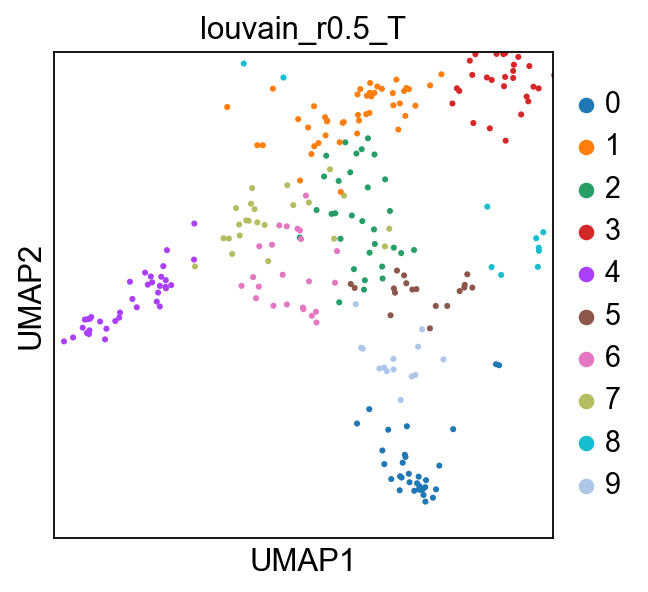

In [466]:
plt.rcParams["figure.figsize"] = (4,4)
ax = sc.pl.umap(Tdata[Tdata.obs['treat']=='Ctl'], color='louvain_r0.5_T', palette=sc.pl.palettes.default_20,size=30,show=False)

#sc.pl.umap(Tdata[Tdata.obs['treat']=='Combo'], color='louvain_r0.5_T', palette=sc.pl.palettes.default_20,size=100,ax=ax)
#sc.pl.umap(Tdata[Tdata.obs['treat']=='Ctl'], color='louvain_r0.5_T', palette=sc.pl.palettes.default_20,size=100,ax=ax)

fig,ax2 = plt.subplots()
ax2.set_xlim(ax.get_xlim())
ax2.set_ylim(ax.get_ylim())
sc.pl.umap(Tdata[Tdata.obs['treat']=='WT'], color='louvain_r0.5_T', palette=sc.pl.palettes.default_20,size=30,ax=ax2)

Trying to set attribute `.uns` of view, copying.


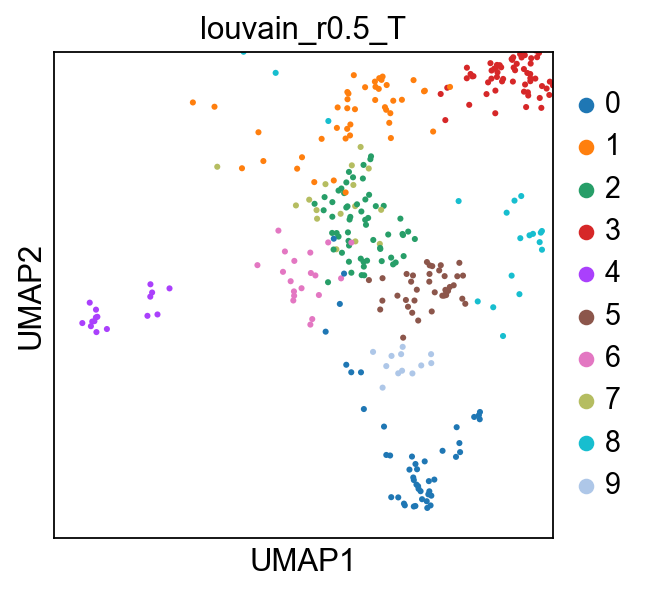

In [467]:
fig,ax2 = plt.subplots()
ax2.set_xlim(ax.get_xlim())
ax2.set_ylim(ax.get_ylim())
sc.pl.umap(Tdata[Tdata.obs['treat']=='HIS'], color='louvain_r0.5_T', palette=sc.pl.palettes.default_20,size=30,ax=ax2)

In [220]:
reffile = '../T_cell_markers'  #T marker genes from Bin
refdict = {}
ref_genes = pd.read_table(reffile, delimiter='\t')
for celltype in ref_genes:
    genelist = ref_genes[celltype].dropna()
    refdict[celltype] = [gene.lower().capitalize() for gene in genelist]
T_markers = refdict['T cell markers']
len(T_markers)

43

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns["dendrogram_['louvain_r0.5_T']"]`


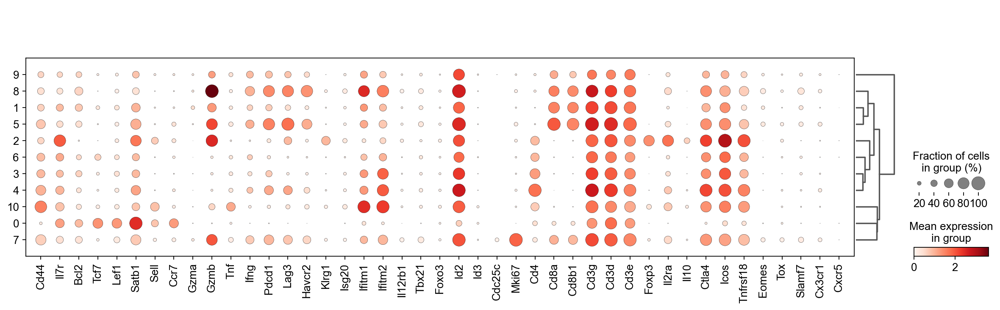

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


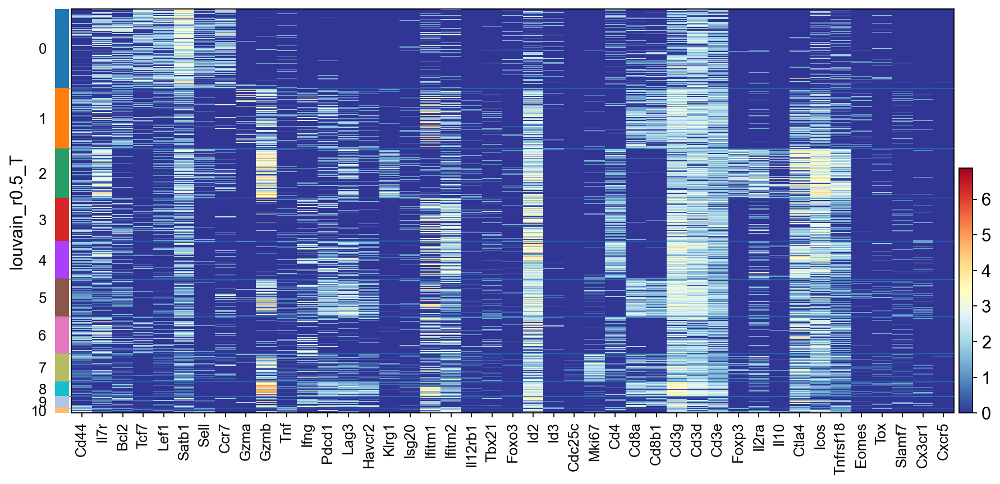

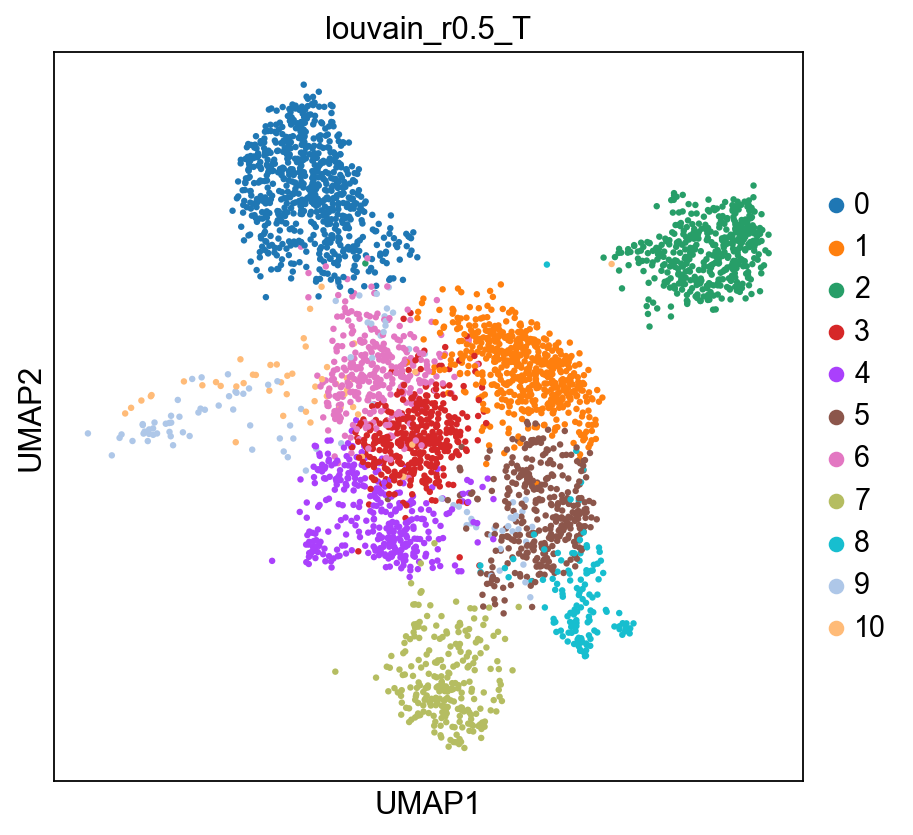

In [221]:
plt.rcParams["figure.figsize"] = (6,6)
#Marker_T=['Mki67','Tcf7','Sell','Ccr7','Il2ra','Il7r','Ctla4','Pdcd1','Foxp3','Ifng','Gzmb','Cd69','Cd44','Cd8a','Cd4']
sc.pl.dotplot(Tdata, T_markers, groupby='louvain_r0.5_T', dendrogram=True)
sc.pl.heatmap(Tdata, T_markers, groupby='louvain_r0.5_T', cmap='RdYlBu_r',interpolation='none')
sc.pl.umap(Tdata, color='louvain_r0.5_T', palette=sc.pl.palettes.default_20)

ranking genes
    finished: added to `.uns['T_Rankgenes']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


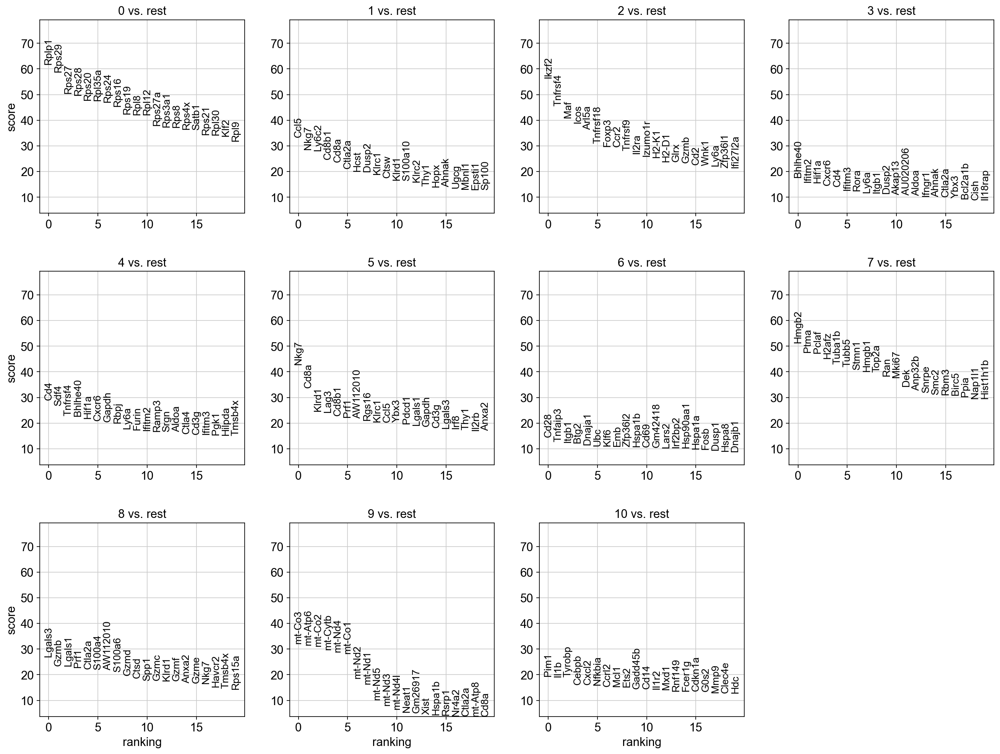

In [224]:
plt.rcParams["figure.figsize"] = (5,5)
sc.tl.rank_genes_groups(Tdata, groupby='louvain_r0.5_T',key_added='T_Rankgenes')
sc.pl.rank_genes_groups(Tdata, key='T_Rankgenes', groups=['0','1','2','3','4','5','6','7','8','9','10'], fontsize=12)

<AxesSubplot:>

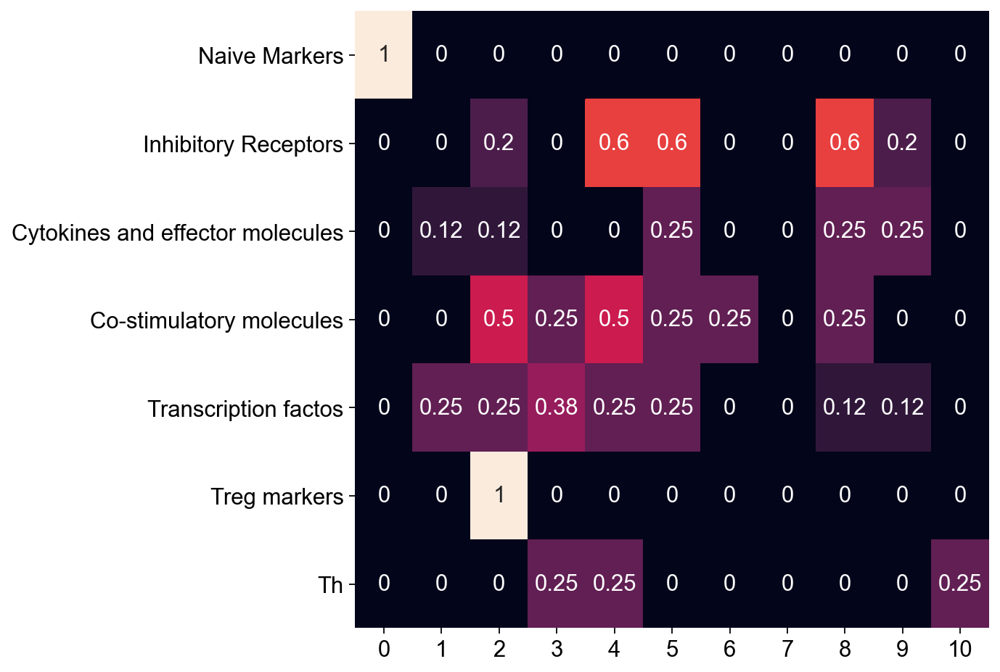

In [223]:
plt.rcParams["figure.figsize"] = (7,7)
cell_annotation_norm = sc.tl.marker_gene_overlap(Tdata, marker_genes_Zhang, key='T_Rankgenes', normalize='reference',top_n_markers=100)
sb.heatmap(cell_annotation_norm, cbar=False, annot=True)
#sc.pl.umap(Tdata, color=['Cd8a','Cd4','louvain_r0.5_T'], use_raw=True, color_map=mymap) 

([<matplotlib.axis.XTick at 0x7fc4b4ee53d0>,
 [Text(0, 0, 'Tcf7'),
  Text(1, 0, 'Sell'),
  Text(2, 0, 'Lef1'),
  Text(3, 0, 'Ccr7'),
  Text(4, 0, 'Lag3'),
  Text(5, 0, 'Tigit'),
  Text(6, 0, 'Pdcd1'),
  Text(7, 0, 'Havcr2'),
  Text(8, 0, 'Ctla4'),
  Text(9, 0, 'Il2'),
  Text(10, 0, 'Gzma'),
  Text(11, 0, 'Prf1'),
  Text(12, 0, 'Gzmb'),
  Text(13, 0, 'Gzmk'),
  Text(14, 0, 'Ifng'),
  Text(15, 0, 'Cd28'),
  Text(16, 0, 'Tnfrsf14'),
  Text(17, 0, 'Icos'),
  Text(18, 0, 'Tnfrsf9'),
  Text(19, 0, 'Eomes'),
  Text(20, 0, 'Hopx'),
  Text(21, 0, 'Tbx21'),
  Text(22, 0, 'Zeb2'),
  Text(23, 0, 'Hif1a'),
  Text(24, 0, 'Id2'),
  Text(25, 0, 'Tox'),
  Text(26, 0, 'Il2ra'),
  Text(27, 0, 'Foxp3'),
  Text(28, 0, 'Ikzf2'),
  Text(29, 0, 'Tbx21'),
  Text(30, 0, 'Csf1'),
  Text(31, 0, 'Ifitm2')])

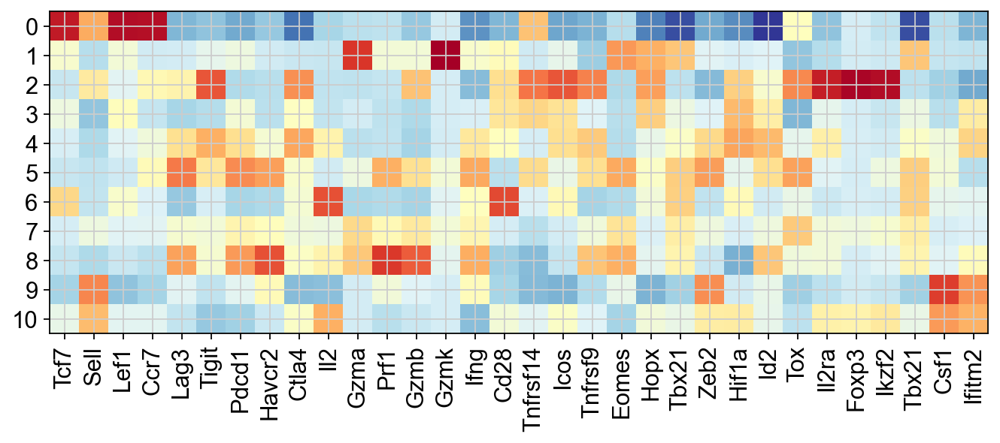

In [227]:
markerlist=[]
for key in marker_genes_Zhang:
    markerlist.extend(marker_genes_Zhang[key])
markerlist
meanexp_Zhang = marker_gene_expression(Tdata,markerlist,'louvain_r0.5_T')

plt.rcParams["figure.figsize"] = (10,10)
tmpdf = meanexp_Zhang.filter(items=list(meanexp_Zhang)[:11]).transpose()
df_norm_col=(tmpdf-tmpdf.mean())/tmpdf.std()
plt.imshow(df_norm_col, cmap='RdYlBu_r')
plt.yticks(np.arange(len(list(meanexp_Zhang)[:11])),list(meanexp_Zhang)[:11])
plt.xticks(np.arange(len(list(meanexp_Zhang.index))),list(meanexp_Zhang.index),rotation='vertical')

([<matplotlib.axis.YTick at 0x7fc4b5ab8790>,
 [Text(0, 0, 'Tcf7'),
  Text(0, 1, 'Sell'),
  Text(0, 2, 'Lef1'),
  Text(0, 3, 'Ccr7'),
  Text(0, 4, 'Lag3'),
  Text(0, 5, 'Tigit'),
  Text(0, 6, 'Pdcd1'),
  Text(0, 7, 'Havcr2'),
  Text(0, 8, 'Ctla4'),
  Text(0, 9, 'Il2'),
  Text(0, 10, 'Gzma'),
  Text(0, 11, 'Prf1'),
  Text(0, 12, 'Gzmb'),
  Text(0, 13, 'Gzmk'),
  Text(0, 14, 'Ifng'),
  Text(0, 15, 'Cd28'),
  Text(0, 16, 'Tnfrsf14'),
  Text(0, 17, 'Icos'),
  Text(0, 18, 'Tnfrsf9'),
  Text(0, 19, 'Eomes'),
  Text(0, 20, 'Hopx'),
  Text(0, 21, 'Tbx21'),
  Text(0, 22, 'Zeb2'),
  Text(0, 23, 'Hif1a'),
  Text(0, 24, 'Id2'),
  Text(0, 25, 'Tox'),
  Text(0, 26, 'Il2ra'),
  Text(0, 27, 'Foxp3'),
  Text(0, 28, 'Ikzf2'),
  Text(0, 29, 'Tbx21'),
  Text(0, 30, 'Csf1'),
  Text(0, 31, 'Ifitm2')])

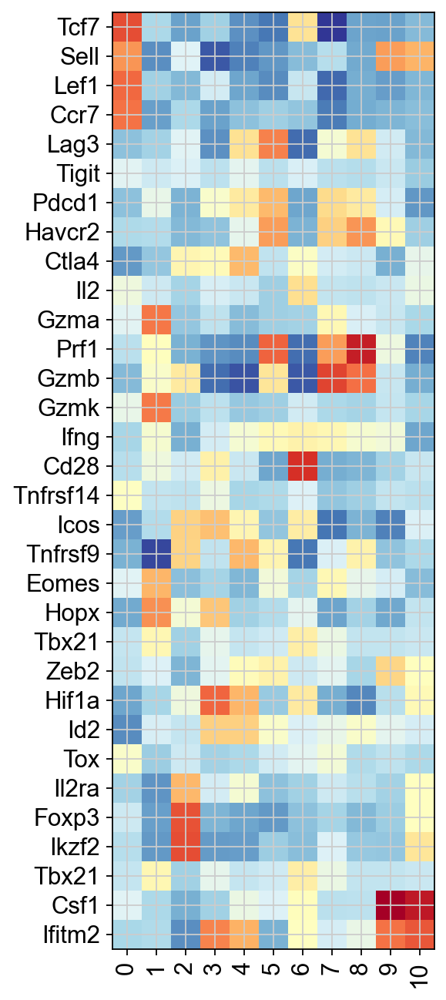

In [228]:
tmpdf = meanexp_Zhang.filter(items=list(meanexp_Zhang)[:11])
df_norm_col=(tmpdf-tmpdf.mean())/tmpdf.std()
plt.imshow(df_norm_col, cmap='RdYlBu_r')
plt.xticks(np.arange(len(list(meanexp_Zhang)[:11])),list(meanexp_Zhang)[:11],rotation=90)
plt.yticks(np.arange(len(list(meanexp_Zhang.index))),list(meanexp_Zhang.index))

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_louvain_r0.5_T']`


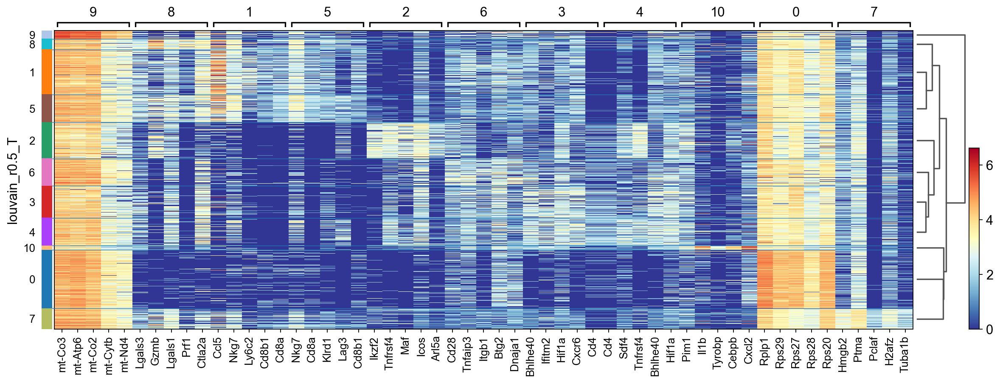

In [229]:
sc.pl.rank_genes_groups_heatmap(Tdata, key='T_Rankgenes',n_genes=5,show_gene_labels=True, cmap='RdYlBu_r',interpolation='none',save='Tr1.heatmap.pdf')


In [484]:
namelist=Tdata.uns['T_Rankgenes']['names']
outfile = open('Rank_genes_T_Clusters.txt','w')
#outfile.write('\t'.join(['Mono?','Epi','APC?','Treat0','Treat1','Ctl0','Treat2','Ctl1','Treat3','Ctl2','NotSure','Treat4']))
for item in namelist:
    outfile.write('\t'.join(item)+'\n')
outfile.close()

loglist=Tdata.uns['T_Rankgenes']['logfoldchanges']
outfile = open('Rank_genes_foldchange_T_Clusters.txt','w')
#outfile.write('\t'.join(['Mono?','Epi','APC?','Treat0','Treat1','Ctl0','Treat2','Ctl1','Treat3','Ctl2','NotSure','Treat4']))
for item in loglist:
    outfile.write('\t'.join(map(str,item))+'\n')
outfile.close()

pvals_list=Tdata.uns['T_Rankgenes']['pvals_adj']
outfile = open('Rank_genes_pvals_adj_T_Clusters.txt','w')
#outfile.write('\t'.join(['Mono?','Epi','APC?','Treat0','Treat1','Ctl0','Treat2','Ctl1','Treat3','Ctl2','NotSure','Treat4']))
for item in loglist:
    outfile.write('\t'.join(map(str,item))+'\n')
outfile.close()

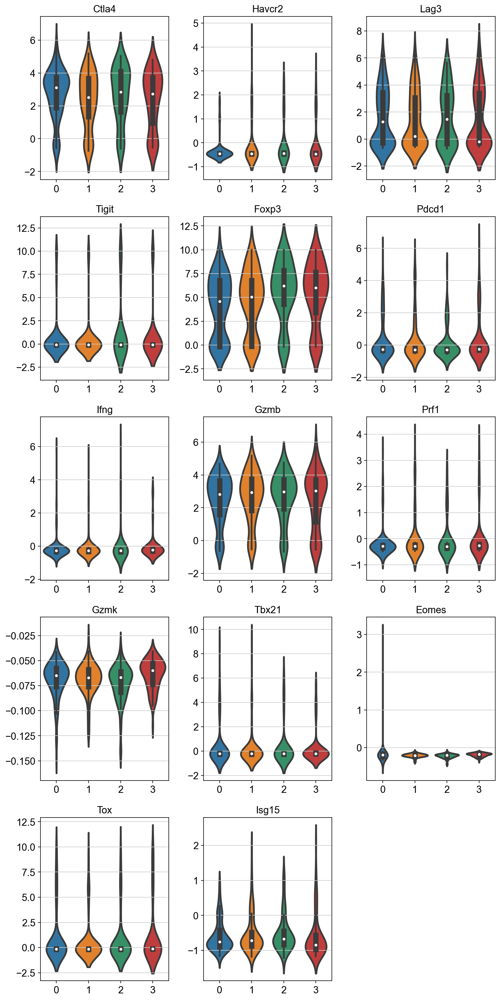

In [233]:
Treg=Tdata[Tdata.obs['louvain_r0.5_T']=='2']

plt.figure(figsize=(10,20))
ploti=0
gdata={}
for gene in ['Ctla4','Havcr2','Lag3','Tigit','Foxp3','Pdcd1','Ifng','Gzmb','Prf1','Gzmk','Tbx21','Eomes','Tox','Isg15']:
    ploti += 1
    gdata['Ctl']=Treg[Treg.obs['treat']=='Ctl'][:,Treg.var.index==gene].X
    gdata['PD1']=Treg[Treg.obs['treat']=='PD1'][:,Treg.var.index==gene].X
    gdata['21DC']=Treg[Treg.obs['treat']=='21DC'][:,Treg.var.index==gene].X
    gdata['Combo']=Treg[Treg.obs['treat']=='Combo'][:,Treg.var.index==gene].X
    #tmpdata['key']=list(gdata.keys())
    #tmpdata['Exp']=[list(gdata['Ctl']),list(gdata['Combo'])]

    test=[list(gdata['Ctl']),list(gdata['PD1']),list(gdata['21DC']),list(gdata['Combo'])]
 #   print(gene, sp.stats.ttest_ind(list(gdata['WT']),list(gdata['HIS'])))
    #plt.hist(list((gdata['Ctl'])))
    plt.subplot(5,3,ploti)

#    sb.boxplot(data=test,linewidth=2.5,width=0.8)
#    sb.swarmplot(data=test,alpha=.75,color='.25')
    
    sb.violinplot(data=test,linewidth=2.5,width=0.8)
    plt.title(gene)

plt.tight_layout()
plt.show()

ranking genes
    finished: added to `.uns['CD8_DE_WTvsHIS']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes
    finished: added to `.uns['CD8_DE_HISvsWT']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


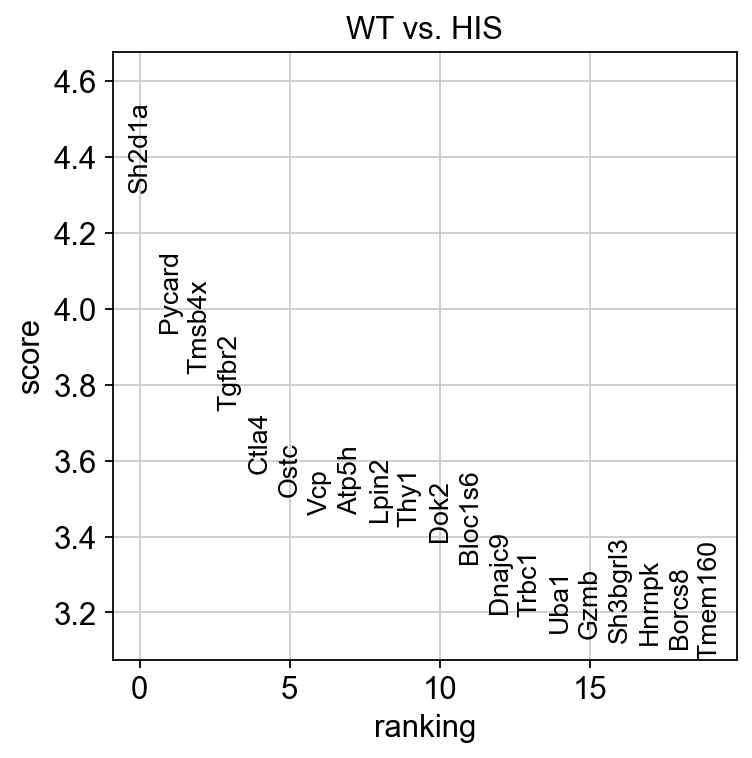

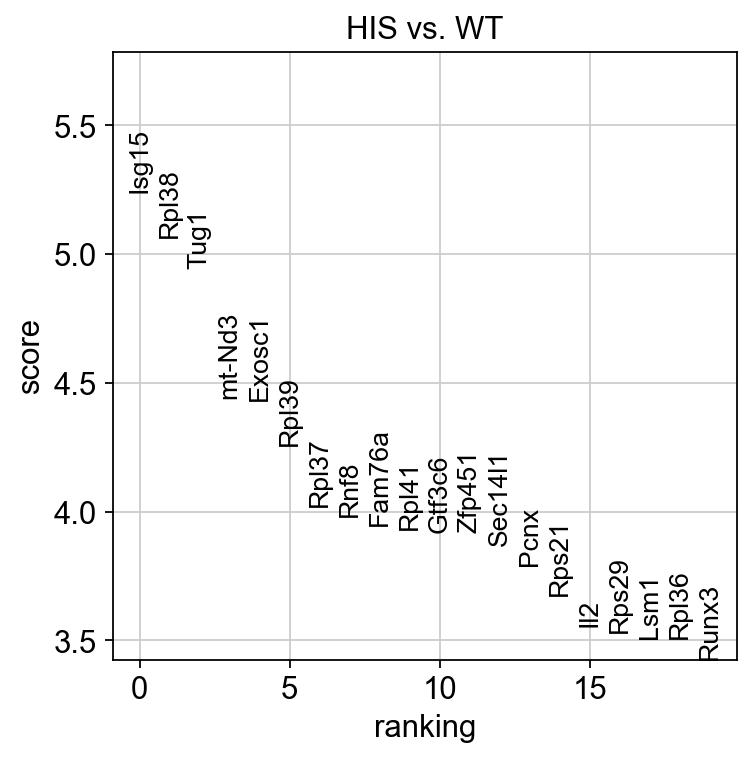

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_treat']`
categories: Ctl, HIS, WT
var_group_labels: HIS


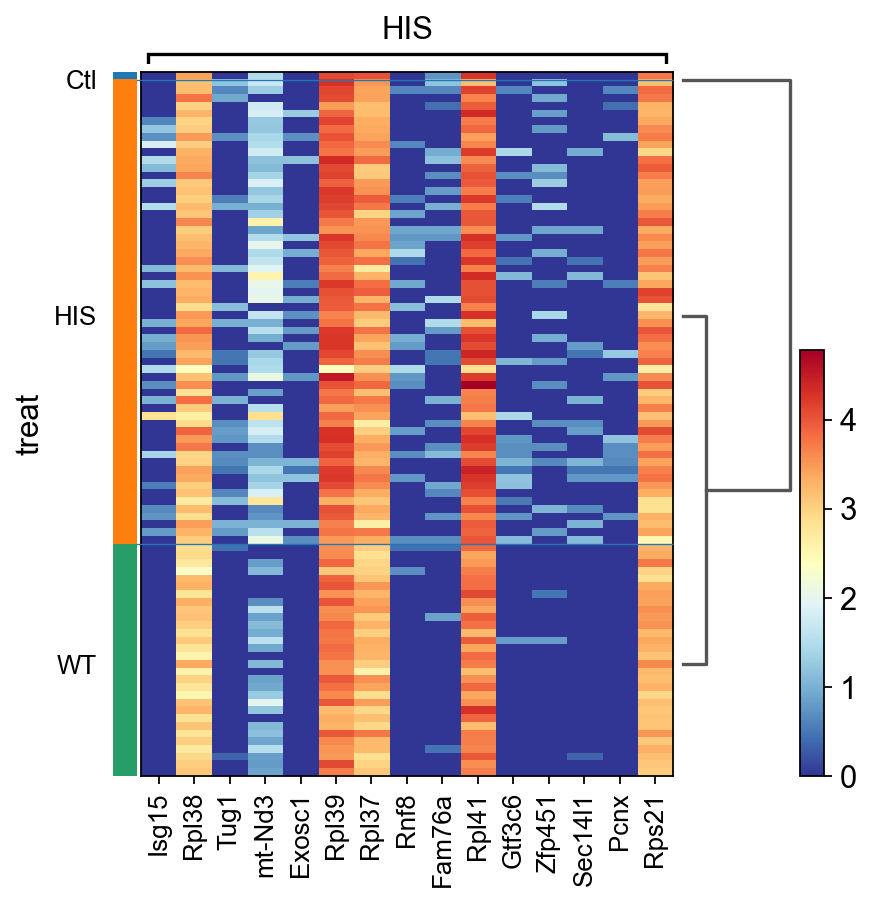

In [495]:
# Did not run this part yet. 

plt.rcParams["figure.figsize"] = (5,5)
#sc.tl.rank_genes_groups(Treg, groupby='treat',groups=['WT','HIS'],key_added='Treg_DE_results',n_genes=1000)
sc.tl.rank_genes_groups(Treg, groupby='treat',groups=['WT'],reference='HIS',key_added='CD8_DE_WTvsHIS',n_genes=1000)
sc.tl.rank_genes_groups(Treg, groupby='treat',groups=['HIS'],reference='WT',key_added='CD8_DE_HISvsWT',n_genes=1000)

sc.pl.rank_genes_groups(Treg, key='CD8_DE_WTvsHIS', groups=['WT'],fontsize=12)
sc.pl.rank_genes_groups(Treg, key='CD8_DE_HISvsWT', fontsize=12)
sc.pl.rank_genes_groups_heatmap(Treg, key='CD8_DE_HISvsWT',n_genes=15,show_gene_labels=True, cmap='RdYlBu_r')

In [759]:
Treg[Treg.obs['treat']=='Combo'][:,Treg.var.index==gene].X

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


ArrayView([[ 4.841579  ],
           [ 4.082651  ],
           [-0.18570665],
           [-0.17541286],
           [-0.15166116],
           [ 2.2639709 ],
           [ 4.945791  ],
           [ 4.3607836 ],
           [ 5.391281  ],
           [-0.16275486],
           [ 7.0514555 ],
           [ 6.7075315 ],
           [ 8.252499  ],
           [-0.1503997 ],
           [ 8.732883  ],
           [ 5.538004  ],
           [-0.15363312],
           [ 7.1153345 ],
           [ 7.1417103 ],
           [ 8.648536  ],
           [ 5.7485347 ],
           [ 8.221227  ],
           [ 7.721522  ],
           [ 7.5013857 ],
           [ 5.6732583 ],
           [ 8.68227   ],
           [ 9.547641  ],
           [-0.15718018],
           [-0.18159646],
           [-0.16778186],
           [ 6.3790526 ],
           [ 6.825676  ],
           [ 6.449316  ],
           [ 6.929002  ],
           [ 4.0941963 ],
           [ 6.6225386 ],
           [ 6.2561316 ],
           [ 6.829661  ],
           [

In [494]:
adata.write('../../../data1/CD45+_P_processed_Scanpy2.h5ad')

## Trajectory and pusdo-timing

In [761]:
CD8_sub= Tdata[ (Tdata.obs['louvain_r0.5_T']=='1')| (Tdata.obs['louvain_r0.5_T']=='6') | (Tdata.obs['louvain_r0.5_T']=='7')]
CD4_sub= Tdata[ (Tdata.obs['louvain_r0.5_T']!='1') & (Tdata.obs['louvain_r0.5_T']!='6') & (Tdata.obs['louvain_r0.5_T']!='10') & (Tdata.obs['louvain_r0.5_T']!='7')]



computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


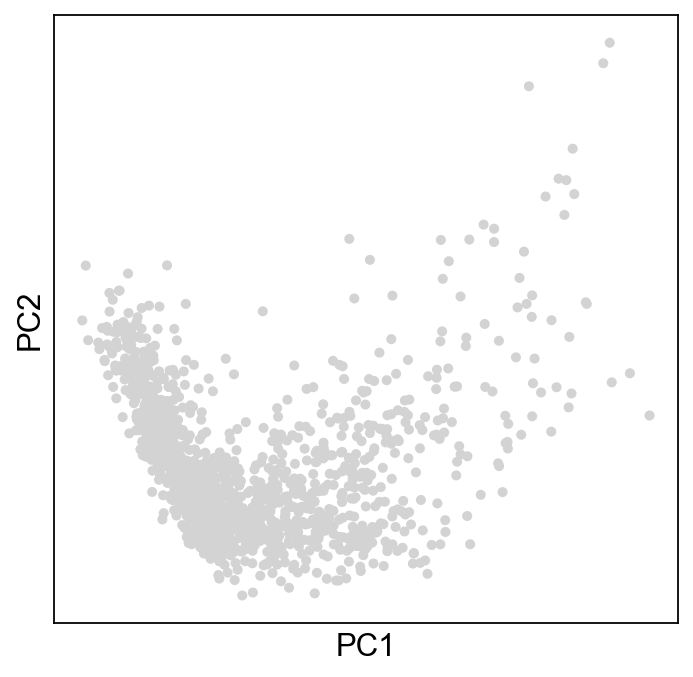

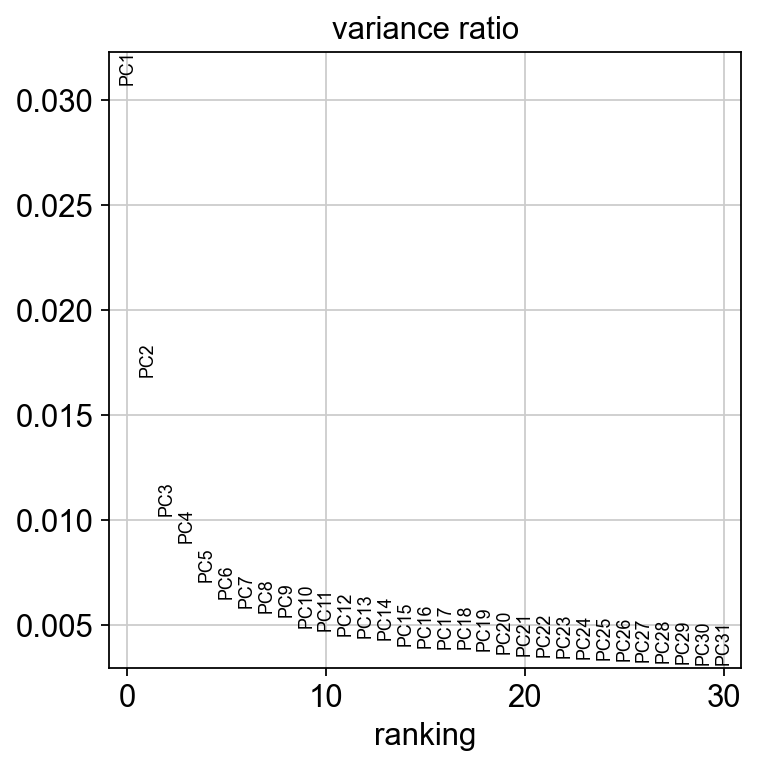

computing PCA
    on highly variable genes
    with n_comps=50


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished (0:00:01)


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


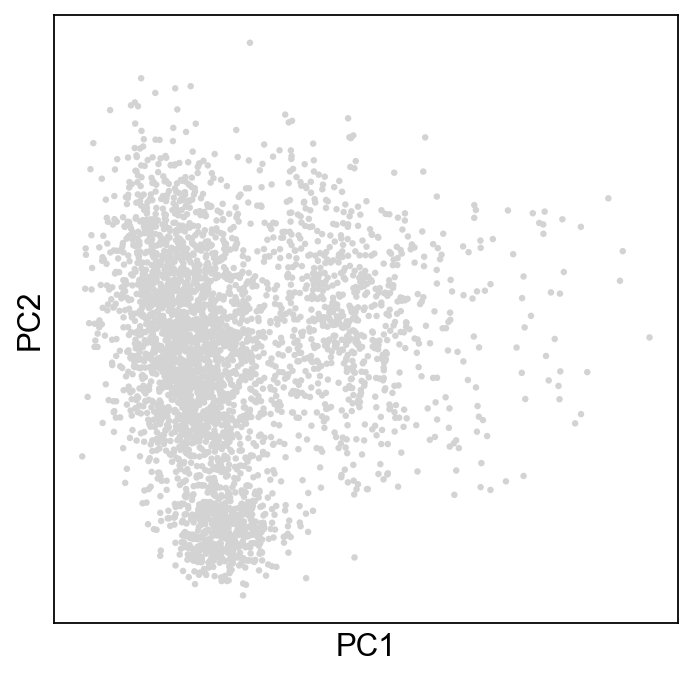

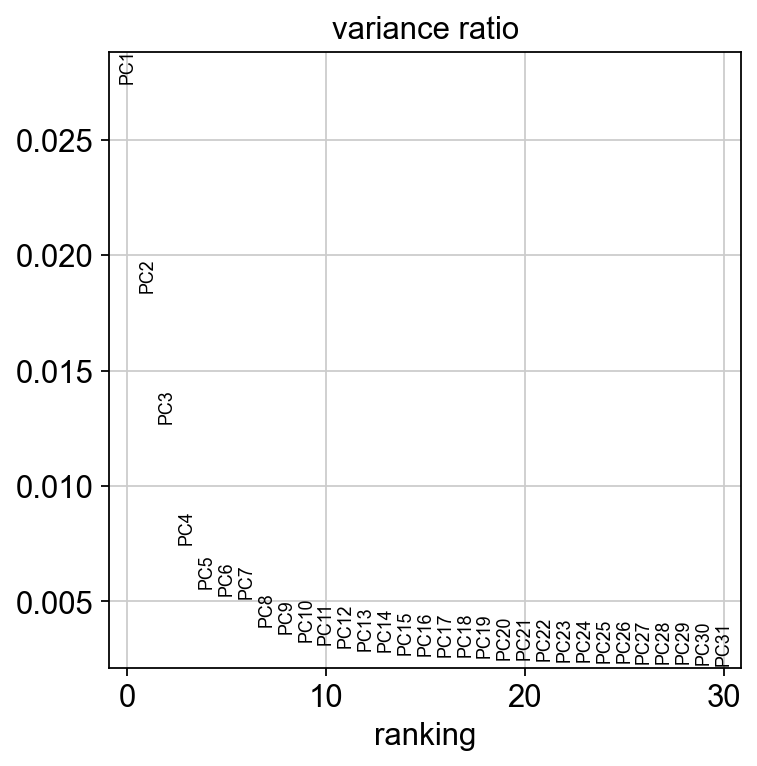

In [762]:
#Recalculating PCA for subset
sc.pp.pca(CD8_sub, svd_solver='arpack')
sc.pl.pca(CD8_sub)
sc.pl.pca_variance_ratio(CD8_sub)
#Recalculating PCA for subset
sc.pp.pca(CD4_sub, svd_solver='arpack')
sc.pl.pca(CD4_sub)
sc.pl.pca_variance_ratio(CD4_sub)

In [763]:
CD8_sub.obsm['X_pca'] = CD8_sub.obsm['X_pca'][:,0:10]
CD4_sub.obsm['X_pca'] = CD4_sub.obsm['X_pca'][:,0:10]

# 3.5.1 Slingshot

Slingshot is written in R. The integration of R in this notebook is again achieved via the rpy2 interface. We use a specifically developed package called anndata2ri (https://www.github.com/flying-sheep/anndata2ri), that takes care of the conversion from an AnnData object to SingleCellExperiment object in R. It should be noted that the convention for scRNA-seq data matrix storage in R is opposite to python. In R the expression matrix is stored as genes x cells rather than cells x genes. Thus, the matrix must be transposed before being input into the R function. This is already taken care of by anndata2ri.
We are loading the normalized, log-transformed, and batch-corrected data as we want to minimize technical variation in the inferred trajectories.
Implementation note:

this section closely follows the online Slingshot tutorial

In [764]:
import logging
import rpy2
import rpy2.rinterface_lib.callbacks
from rpy2.robjects import pandas2ri
import anndata2ri

# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

# Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()

%load_ext rpy2.ipython

The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython


In [765]:
%%R
# Load libraries from correct lib Paths for my environment - ignore this!
#.libPaths(.libPaths()[c(3,2,1)])

# Load all the R libraries we will be using in the notebook
#library(scran)
library(RColorBrewer)
library(slingshot)
#library(monocle)
#library(gam)
#library(clusterExperiment)
#library(ggplot2)
#library(plyr)
#library(MAST)

In [767]:
CD8_sub2 = CD8_sub
#CD8_sub2
del CD8_sub2.uns['neighbors']

In [768]:
CD4_sub2 = CD4_sub
#CD8_sub2
del CD4_sub2.uns['neighbors']

In [769]:
%%R -i CD8_sub2 
print(CD8_sub2)

/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata2ri/py2r.py:38: NotConvertedWarning: Conversion 'py2rpy' not defined for objects of type '<class 'NoneType'>'
  warn(str(e), NotConvertedWarning)


class: SingleCellExperiment 
dim: 18794 1470 
metadata(14): log1p hvg ... T_Rankgenes dendrogram_louvain_r0.5_T
assays(1): X
rownames(18794): Sox17 Mrpl15 ... CAAA01118383.1 CAAA01147332.1
rowData names(14): gene_ids feature_types ... mean std
colnames(1470): AAACCCATCGGCTATA-1-0 AAACGAAAGATGCGAC-1-0 ...
  TTTCGATTCACCATGA-1-1 TTTGGAGGTTTGGCTA-1-1
colData names(15): treat doublet ... louvain louvain_r0.5_T
reducedDimNames(3): PCA UMAP TSNE
spikeNames(0):
altExpNames(0):


In [770]:
%%R -i CD4_sub2 
print(CD4_sub2)

class: SingleCellExperiment 
dim: 18794 3513 
metadata(14): log1p hvg ... T_Rankgenes dendrogram_louvain_r0.5_T
assays(1): X
rownames(18794): Sox17 Mrpl15 ... CAAA01118383.1 CAAA01147332.1
rowData names(14): gene_ids feature_types ... mean std
colnames(3513): AAACCCAAGAAACTGT-1-0 AAACCCACACCAATTG-1-0 ...
  TTTGGTTTCCGATGTA-1-1 TTTGTTGAGCGGGTTA-1-1
colData names(15): treat doublet ... louvain louvain_r0.5_T
reducedDimNames(3): PCA UMAP TSNE
spikeNames(0):
altExpNames(0):


[1] "1:"
class: SlingshotDataSet 

 Samples Dimensions
    1470         10

lineages: 1 
Lineage1: 7  1  6  

curves: 1 
Curve1: Length: 70.754	Samples: 1470


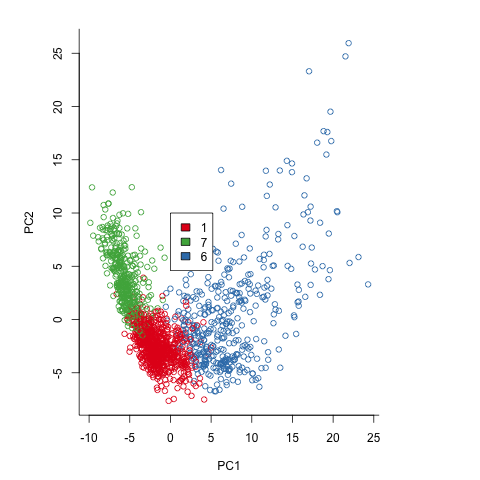

In [771]:
%%R -i CD8_sub2 

#Plot 1
colour_map = brewer.pal(20,'Set1')
par(xpd=TRUE)
par(mar=c(4.5,5.5,2,7))
plot(reducedDims(CD8_sub2)$PCA[,1], reducedDims(CD8_sub2)$PCA[,2], col=colour_map[colData(CD8_sub2)$louvain_r0.5_T], bty='L', xlab='PC1', ylab='PC2')
legend(x=0, y=10, legend=unique(colData(CD8_sub2)$louvain_r0.5_T), fill=colour_map[as.integer(unique(colData(CD8_sub2)$louvain_r0.5_T))])

print("1:")
CD8_sub_start <- slingshot(CD8_sub2, clusterLabels = 'louvain_r0.5_T', reducedDim = 'PCA', start.clus='7')
print(SlingshotDataSet(CD8_sub_start))

#print("")
#print("2:")
#CD8_sub_startend <- slingshot(CD8_sub, clusterLabels = 'louvain_r1_T', reducedDim = 'PCA', start.clus='Combo-CD8L Hsp', end.clus=c('Combo-CD8 Cytotixic', 'Combo-CD4 effector'))
#print(SlingshoCD8Set(CD8_sub_startend))

#print("")
#print("3:")
#CD8_sub_simple_startend <- slingshot(CD8_sub, clusterLabels = 'louvain_r1_T', reducedDim = 'PCA', start.clus='Combo-T naive', end.clus='Combo-CD8 exhausted')
#print(SlingshotDataSet(CD8_sub_simple_startend))

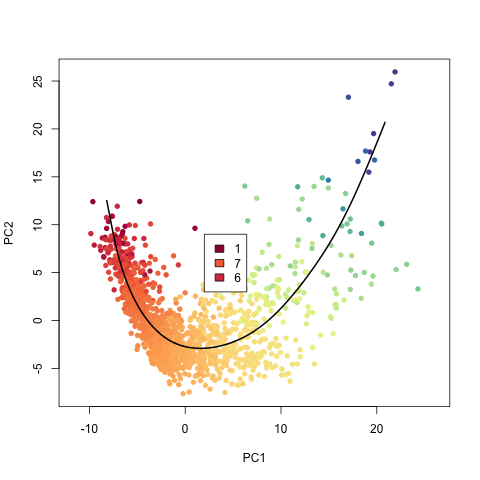

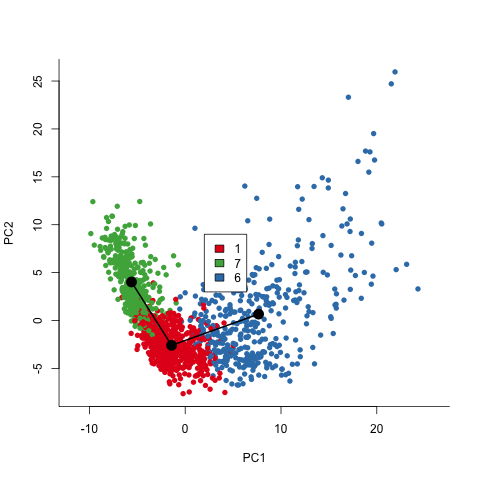

In [772]:
%%R

#Plot of lineage 1
colors <- colorRampPalette(brewer.pal(11,'Spectral')[-6])(100)
plot(reducedDims(CD8_sub_start)$PCA[,c(1,2)], col = colors[cut(CD8_sub_start$slingPseudotime_1,breaks=100)], pch=16, asp = 1, xlab='PC1', ylab='PC2')
lines(slingCurves(CD8_sub_start)$curve1, lwd=2)
legend(x=2,y=9,legend=unique(colData(CD8_sub2)$louvain_r0.5_T), fill=brewer.pal(11,'Spectral')[as.integer(unique(colData(CD8_sub2)$louvain_r0.5_T))])

#Plot of lineages with clusters visualized
par(xpd=TRUE)
plot(reducedDims(CD8_sub_start)$PCA[,c(1,2)], col = brewer.pal(11,'Set1')[CD8_sub2$louvain_r0.5_T], pch=16, asp = 1, bty='L', xlab='PC1', ylab='PC2')
lines(SlingshotDataSet(CD8_sub_start), lwd=2, type='lineages')
#legend(x=10, y=20, legend=unique(colData(CD8_sub2)$louvain_r0.5_T), fill=brewer.pal(11,'Set1')[as.integer(unique(colData(CD8_sub2)$louvain_r0.5_T))])
legend(x=2,y=9,legend=unique(colData(CD8_sub2)$louvain_r0.5_T), fill=brewer.pal(11,'Set1')[as.integer(unique(colData(CD8_sub2)$louvain_r0.5_T))])



[1] "1:"
class: SlingshotDataSet 

 Samples Dimensions
    3513         10

lineages: 2 
Lineage1: 3  9  0  4  8  
Lineage2: 3  9  2  5  

curves: 2 
Curve1: Length: 43.358	Samples: 2403.15
Curve2: Length: 52.793	Samples: 2318.16
[1] ""
[1] "2:"
class: SlingshotDataSet 

 Samples Dimensions
    3513         10

lineages: 2 
Lineage1: 3  9  0  4  8  5  
Lineage2: 3  9  2  

curves: 2 
Curve1: Length: 44.366	Samples: 2815.08
Curve2: Length: 50.892	Samples: 2053.08


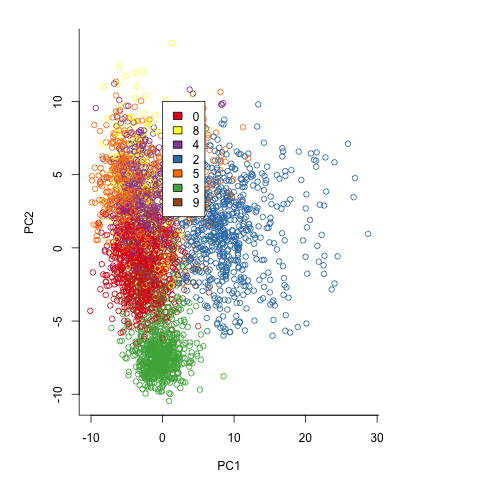

In [773]:
%%R -i CD4_sub2 

#Plot 1
colour_map = brewer.pal(20,'Set1')
par(xpd=TRUE)
par(mar=c(4.5,5.5,2,7))
plot(reducedDims(CD4_sub2)$PCA[,1], reducedDims(CD4_sub2)$PCA[,2], col=colour_map[colData(CD4_sub2)$louvain_r0.5_T], bty='L', xlab='PC1', ylab='PC2')
legend(x=0, y=10, legend=unique(colData(CD4_sub2)$louvain_r0.5_T), fill=colour_map[as.integer(unique(colData(CD4_sub2)$louvain_r0.5_T))])

print("1:")
CD4_sub_start <- slingshot(CD4_sub2, clusterLabels = 'louvain_r0.5_T', reducedDim = 'PCA', start.clus='3')
print(SlingshotDataSet(CD4_sub_start))

print("")
print("2:")
CD4_sub_startend <- slingshot(CD4_sub2, clusterLabels = 'louvain_r0.5_T', reducedDim = 'PCA', start.clus='3', end.clus=c('5','2'))
print(SlingshotDataSet(CD4_sub_startend))

#print("")
#print("3:")
#CD8_sub_simple_startend <- slingshot(CD8_sub, clusterLabels = 'louvain_r1_T', reducedDim = 'PCA', start.clus='Combo-T naive', end.clus='Combo-CD8 exhausted')
#print(SlingshotDataSet(CD8_sub_simple_startend))

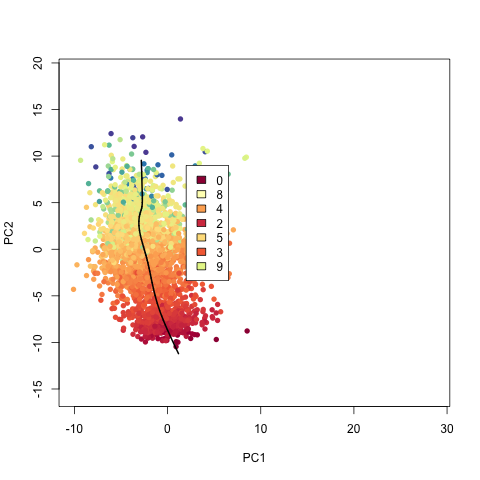

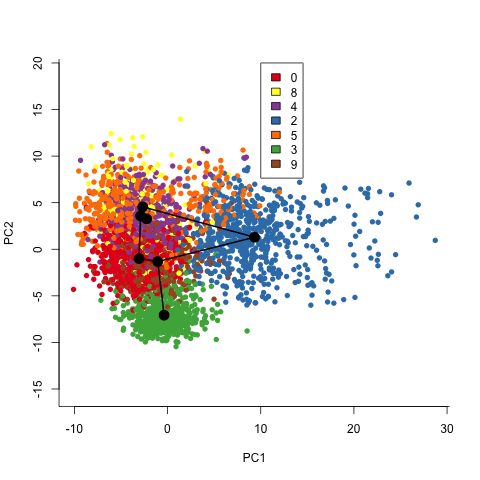

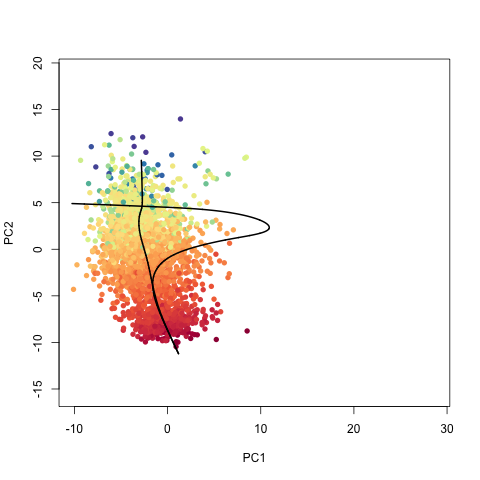

In [774]:
%%R

#Plot of lineage 1
colors <- colorRampPalette(brewer.pal(11,'Spectral')[-6])(100)
plot(reducedDims(CD4_sub_start)$PCA[,c(1,2)], col = colors[cut(CD4_sub_start$slingPseudotime_1,breaks=100)], pch=16, asp = 1, xlab='PC1', ylab='PC2')
lines(slingCurves(CD4_sub_start)$curve1, lwd=2)
legend(x=2,y=9,legend=unique(colData(CD4_sub2)$louvain_r0.5_T), fill=brewer.pal(11,'Spectral')[as.integer(unique(colData(CD4_sub2)$louvain_r0.5_T))])

#Plot of lineages with clusters visualized
par(xpd=TRUE)
plot(reducedDims(CD4_sub_start)$PCA[,c(1,2)], col = brewer.pal(11,'Set1')[CD4_sub2$louvain_r0.5_T], pch=16, asp = 1, bty='L', xlab='PC1', ylab='PC2')
lines(SlingshotDataSet(CD4_sub_start), lwd=2, type='lineages')
#legend(x=10, y=20, legend=unique(colData(CD4_sub2)$louvain_r0.5_T), fill=brewer.pal(11,'Set1')[as.integer(unique(colData(CD4_sub2)$louvain_r0.5_T))])
legend(x=10,y=20,legend=unique(colData(CD4_sub2)$louvain_r0.5_T), fill=brewer.pal(11,'Set1')[as.integer(unique(colData(CD4_sub2)$louvain_r0.5_T))])


#Plot of simpler clustering
plot(reducedDims(CD4_sub_start)$PCA[,c(1,2)], col = colors[cut(CD4_sub_start$slingPseudotime_1,breaks=100)], pch=16, asp = 1, xlab='PC1', ylab='PC2')
lines(SlingshotDataSet(CD4_sub_start), lwd=2)


# Diffusion Pseudotime (DPT)

In [775]:
sc.pp.neighbors(CD4_sub)
sc.tl.diffmap(CD4_sub)

computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.9855747  0.9801058  0.9784022  0.9601479  0.9381901
     0.9359688  0.93223864 0.91818315 0.91228974 0.9102585  0.90842897
     0.89603484 0.8919684  0.88794845]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:00)


/Users/yushendu/anaconda3/envs/scanpy2/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


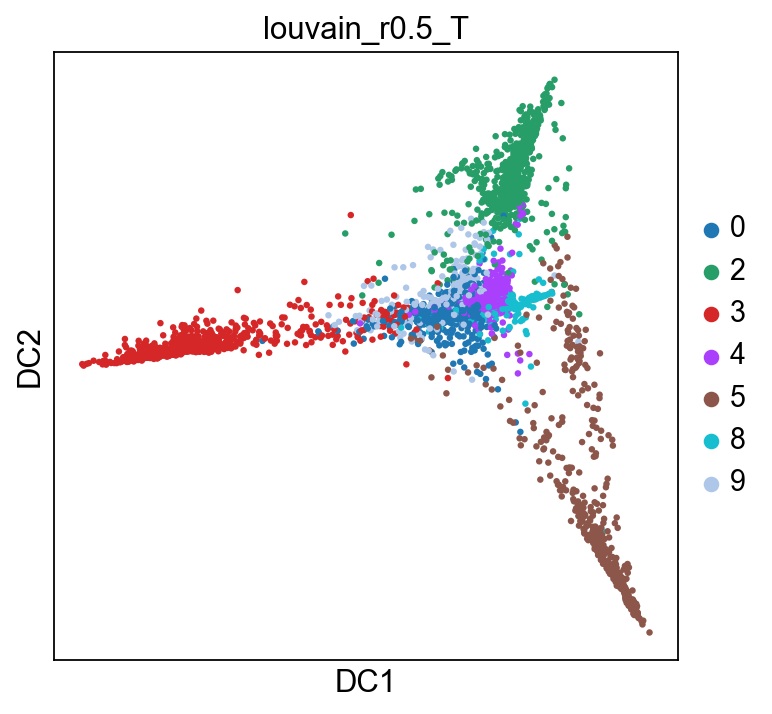

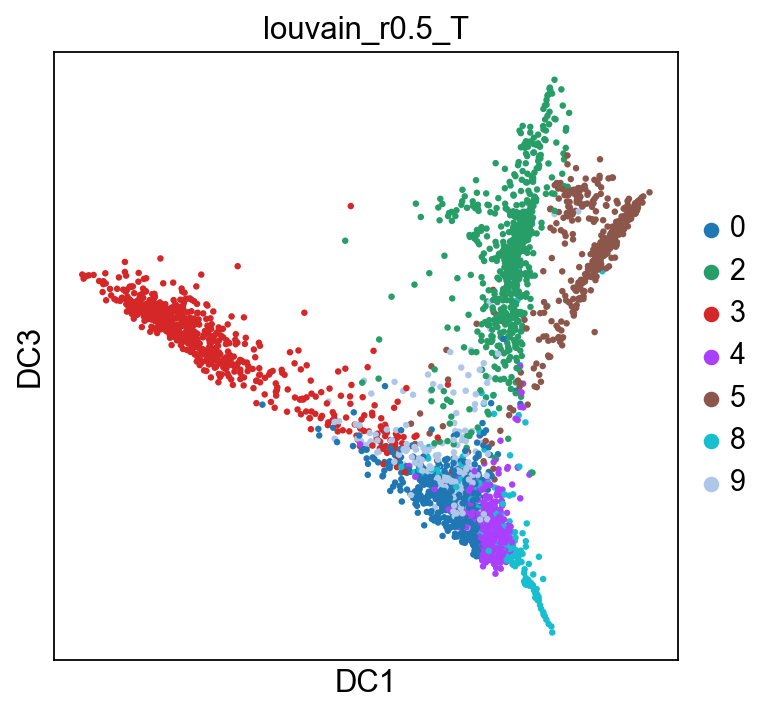

In [776]:
sc.pl.diffmap(CD4_sub, components='1,2', color='louvain_r0.5_T')
sc.pl.diffmap(CD4_sub, components='1,3', color='louvain_r0.5_T')

computing Diffusion Pseudotime using n_dcs=10
    finished: added
    'dpt_pseudotime', the pseudotime (adata.obs) (0:00:00)


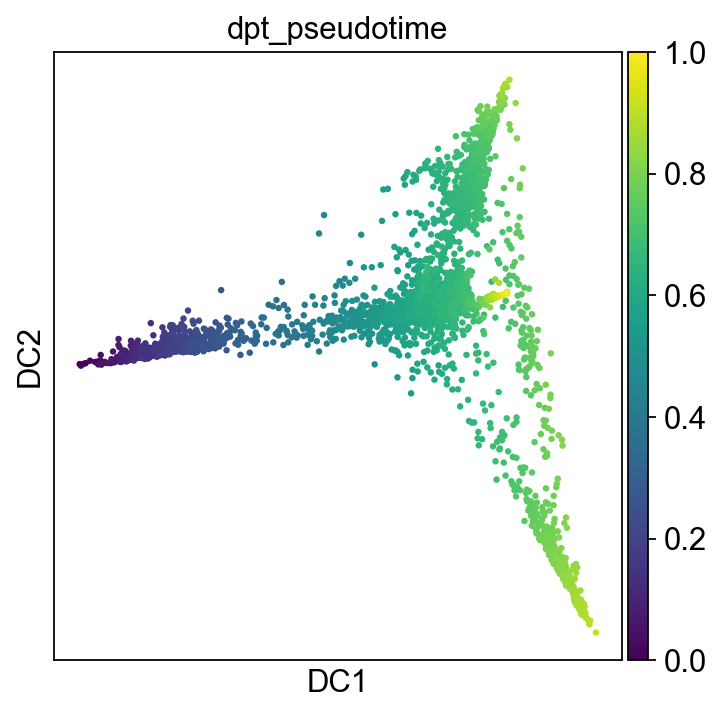

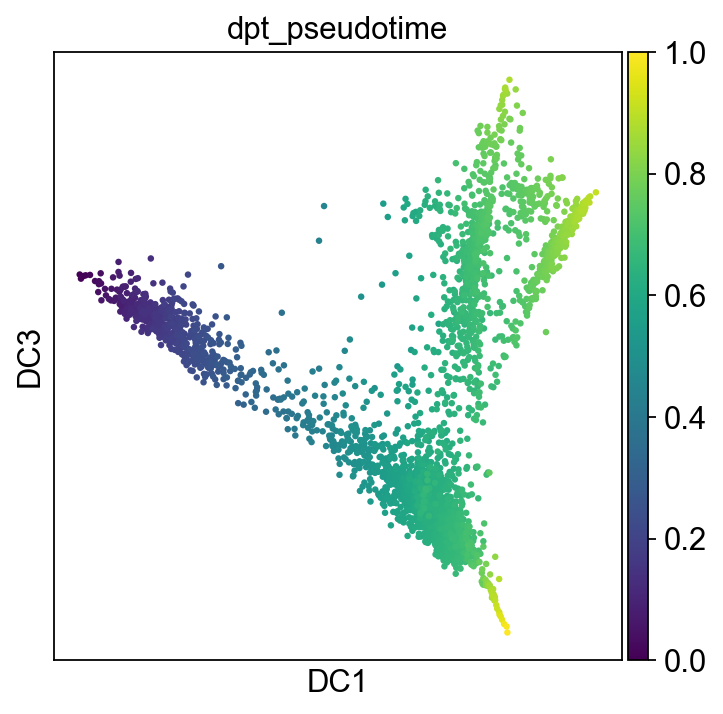

In [777]:
#Find the stem cell with the highest DC3 value to act as root for the diffusion pseudotime and compute DPT
stem_mask = np.isin(CD4_sub.obs['louvain_r0.5_T'], '3')
max_stem_id = np.argmin(CD4_sub.obsm['X_diffmap'][stem_mask,1]) #min of DC1
root_id = np.arange(len(stem_mask))[stem_mask][max_stem_id]
CD4_sub.uns['iroot'] = root_id

#Compute dpt
sc.tl.dpt(CD4_sub)

#Visualize pseudotime over differentiation
sc.pl.diffmap(CD4_sub, components='1,2', color='dpt_pseudotime')
sc.pl.diffmap(CD4_sub, components='1,3', color='dpt_pseudotime')

In [778]:
sc.tl.draw_graph(adata)

drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fr', graph_drawing coordinates (adata.obsm) (0:03:58)
